In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
import seaborn as sns

from sklearn.preprocessing import MinMaxScaler


from sklearn.preprocessing import MinMaxScaler
from collections import Counter
from imblearn.combine import SMOTETomek, SMOTEENN
from imblearn.over_sampling import BorderlineSMOTE, SMOTE
from imblearn.under_sampling import RandomUnderSampler
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn import linear_model

from sklearn.metrics import accuracy_score,confusion_matrix,classification_report, f1_score, precision_score
from sklearn.model_selection import KFold, GridSearchCV, train_test_split
from sklearn.metrics import roc_auc_score, matthews_corrcoef
from sklearn.metrics import roc_curve, balanced_accuracy_score  
from sklearn.metrics import precision_recall_curve, recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import auc
from sklearn.decomposition import PCA
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import ExtraTreesClassifier


from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB,MultinomialNB,BernoulliNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import VotingClassifier


In [57]:
df=pd.read_csv("D:/Disertation/fraud.csv")

In [58]:
pd.set_option('display.max_columns', 46)
df.head()

,fyear,gvkey,p_aaer,misstate,act,ap,at,ceq,che,cogs,csho,dlc,dltis,dltt,dp,ib,invt,ivao,ivst,lct,lt,ni,ppegt,pstk,re,rect,sale,sstk,txp,txt,xint,prcc_f,dch_wc,ch_rsst,dch_rec,dch_inv,soft_assets,ch_cs,ch_cm,ch_roa,issue,bm,dpi,reoa,EBIT,ch_fcf
0,1990,1009,NaN,0,10.047,3.736,32.335,6.262,0.002,30.633,2.526,3.283,32.853,17.691,1.971,1.431,2.355,0.000,0.000,8.382,26.073,2.135,31.767,0.000,5.420,6.895,40.522,0.000,0.000,0.769,2.333,6.000,0.069595,0.046043,0.041935,0.033034,0.312448,0.095082,0.082631,-0.019761,1,0.413170,0.873555,0.167620,0.161961,-0.042140
1,1990,1011,NaN,0,1.247,0.803,7.784,0.667,0.171,1.125,3.556,0.021,2.017,5.871,0.700,-1.869,0.663,0.132,0.000,1.246,7.117,-1.869,7.328,0.000,-3.339,0.290,3.635,0.006,0.000,0.000,0.640,1.188,-0.065604,-0.240937,-0.006248,-0.026684,0.315904,0.188832,-0.211389,-0.117832,1,0.157887,0.745139,-0.428957,-0.157888,0.100228
2,1990,1017,NaN,0,55.040,3.601,118.120,44.393,3.132,107.343,3.882,6.446,6.500,37.603,6.271,1.722,4.292,12.989,2.913,32.615,73.727,2.574,78.331,0.000,46.630,47.366,144.258,0.000,0.000,0.986,3.962,5.125,0.092822,0.020143,0.002156,0.002746,0.605342,0.097551,-0.105780,0.091206,1,2.231337,1.015131,0.394768,0.063681,0.066348
3,1990,1021,NaN,0,24.684,3.948,34.591,7.751,0.411,31.214,4.755,8.791,0.587,8.906,1.325,0.422,15.463,0.000,0.000,16.208,25.545,0.422,11.145,1.295,3.280,8.522,48.292,0.000,0.448,0.365,2.269,1.562,0.014060,0.035120,0.035583,0.008332,0.793068,-0.005725,-0.249704,0.017545,1,1.043582,1.026261,0.094822,0.088347,-0.017358
4,1990,1028,NaN,0,17.325,3.520,27.542,-12.142,1.017,32.662,6.735,32.206,0.000,0.266,2.711,-23.577,8.971,0.000,0.000,39.418,39.684,-22.812,5.782,0.000,-25.955,6.354,33.543,0.000,0.000,0.000,3.510,1.125,-0.540503,-0.575325,-0.102153,-0.222022,0.869182,-0.231536,-1.674893,-0.466667,0,-1.602508,0.598443,-0.942379,-0.700821,0.130349


In [59]:
# creating a new list misstate and replacing 0 as non- fraud and 1 as fraud

misstate=df["misstate"].copy()

# creating a dict file 
j = {1:'Fraud' ,0:'Non-Fraud'}

misstate=[j[i] for i in df["misstate"]]

Number of Non-Frauds:  145081
Number of Frauds:  964


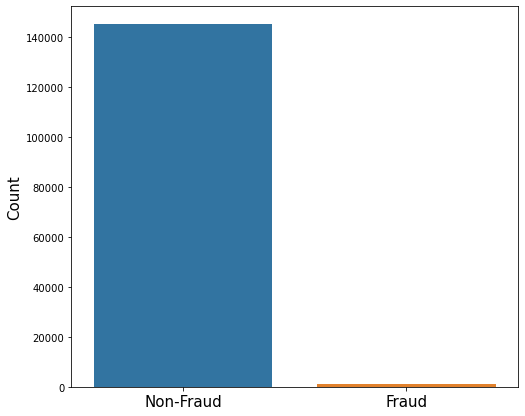

In [60]:
#plot fraud count
plt.figure(figsize=(8,7))
ax=sns.countplot(x=misstate)
plt.ylabel("Count",fontsize=15)
plt.xticks(size=15)

print("Number of Non-Frauds: ",df['misstate'].value_counts()[0])
print("Number of Frauds: ",df['misstate'].value_counts()[1])

In [61]:
print("Percentage of fraud companies",(964/df.shape[0])*100)
print("Percentage of non-fraud companies ",(145081/df.shape[0])*100)

Percentage of fraud companies 0.6600705262076757
Percentage of non-fraud companies  99.33992947379232


In [62]:

fraud=pd.DataFrame({"misstatment":["Non-Fraud", "Fraud"],"Total Count":[145081, 964], "Percentage(%)":[99.33,0.66]
                   })
fraud

,misstatment,Total Count,Percentage(%)
0,Non-Fraud,145081,99.33
1,Fraud,964,0.66


In [63]:
# calculating fraud cases in each year 

df1=df.groupby("fyear")[['misstate']].sum()

In [64]:
df1.rename(columns={"misstate":"Total Fraud"}, inplace=True)
df1['Fraud percent (%)'] = (df.groupby('fyear')['misstate'].sum()/df.groupby('fyear')["misstate"].count())*100
df1.iloc[0:12]

,Total Fraud,Fraud percent (%)
fyear,,
1990,15,0.327368
1991,27,0.572884
1992,26,0.523139
1993,30,0.557932
1994,23,0.404645
1995,22,0.353130
1996,33,0.489251
1997,42,0.618648
1998,56,0.833830


In [65]:
df1.iloc[12:25]

,Total Fraud,Fraud percent (%)
fyear,,
2002,77,1.269161
2003,69,1.153653
2004,58,0.977418
2005,45,0.767525
2006,33,0.558565
2007,30,0.511247
2008,26,0.463293
2009,31,0.577604
2010,26,0.482464


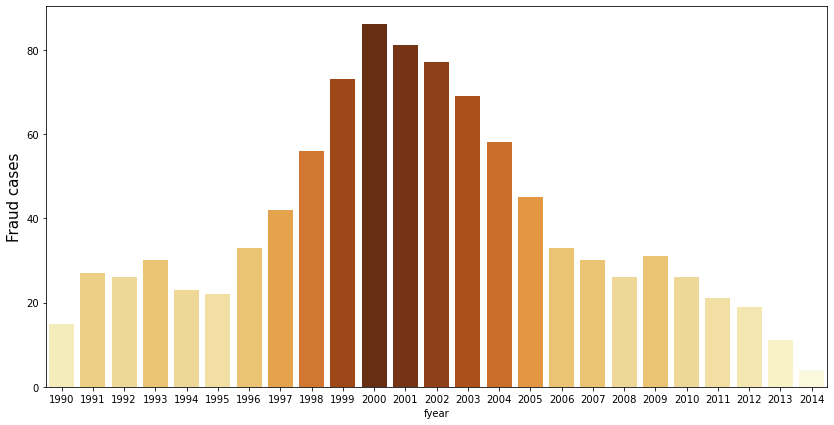

In [66]:
#plot the distribution of total fraud over the years

plt.figure(figsize=(14,7))

def colors_from_values(values, palette_name):
    # normalize the values to range [0, 1]
    normalized = (values - min(values)) / (max(values) - min(values))
    # convert to indices
    indices = np.round(normalized * (len(values) - 1)).astype(np.int32)
    # use the indices to get the colors
    palette = sns.color_palette(palette_name, len(values))
    return np.array(palette).take(indices, axis=0)


sns.barplot(x=df1.index,y="Total Fraud",data=df1, palette=colors_from_values(df1["Total Fraud"], "YlOrBr"))
plt.ylabel("Fraud cases", fontsize=15)
plt.show()


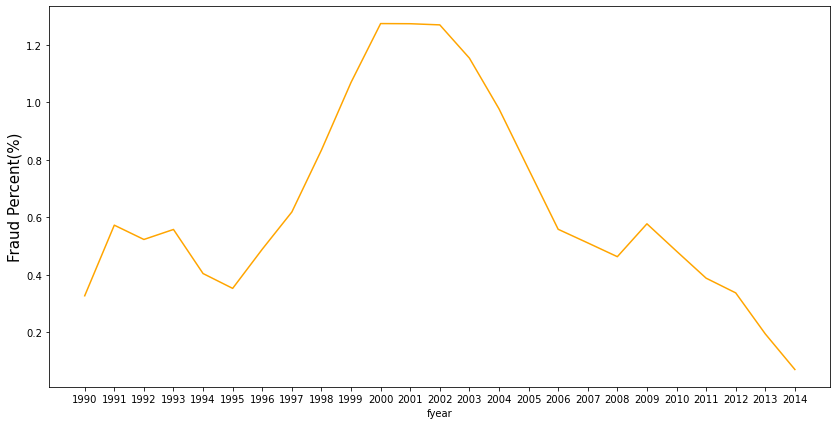

In [67]:
#plot the distribution of total fraud percentage over the years
plt.figure(figsize=(14,7))
sns.lineplot(x=df1.index,y="Fraud percent (%)",data=df1, color="orange")
plt.xticks(df1.index)
plt.ylabel("Fraud Percent(%)", fontsize=15)
plt.show()

In [68]:
total_fraud=df1["Total Fraud"].sum()
total_fraud

964

In [69]:
X=df.iloc[:,df.columns!='misstate']
Y=df.iloc[:,df.columns=='misstate']

In [70]:
# finding the missing values in the data
df.isnull().sum()

fyear               0
gvkey               0
p_aaer         145081
misstate            0
act                 0
ap                  0
at                  0
ceq                 0
che                 0
cogs                0
csho                0
dlc                 0
dltis               0
dltt                0
dp                  0
ib                  0
invt                0
ivao                0
ivst                0
lct                 0
lt                  0
ni                  0
ppegt               0
pstk                0
re                  0
rect                0
sale                0
sstk                0
txp                 0
txt                 0
xint                0
prcc_f              0
dch_wc           4759
ch_rsst          4851
dch_rec          4743
dch_inv          4615
soft_assets       592
ch_cs           15918
ch_cm           17107
ch_roa          12678
issue               0
bm                 18
dpi              9228
reoa              591
EBIT              591
ch_fcf    

In [71]:
print("NUMBER OF MISSNG VALUES \n")

for i in df.columns:
    x=df[i].isna().sum()
    if(x!=0):
        print(f"{i} = {x}")

NUMBER OF MISSNG VALUES 

p_aaer = 145081
dch_wc = 4759
ch_rsst = 4851
dch_rec = 4743
dch_inv = 4615
soft_assets = 592
ch_cs = 15918
ch_cm = 17107
ch_roa = 12678
bm = 18
dpi = 9228
reoa = 591
EBIT = 591
ch_fcf = 5407


In [72]:
print("COLUMNS WITH MISSING VALUES AND PERCENT OF MISSNG VALUES \n")

for i in df.columns:
    x=np.where(df[i].isnull(),1,0)
    if(x.mean()!=0):
        print('Percent of misisng value in '+i+' is ',x.mean()*100)
    

COLUMNS WITH MISSING VALUES AND PERCENT OF MISSNG VALUES 

Percent of misisng value in p_aaer is  99.33992947379232
Percent of misisng value in dch_wc is  3.258584682803246
Percent of misisng value in ch_rsst is  3.3215789653873804
Percent of misisng value in dch_rec is  3.2476291553973087
Percent of misisng value in dch_inv is  3.159984936149817
Percent of misisng value in soft_assets is  0.40535451401965145
Percent of misisng value in ch_cs is  10.899380327981103
Percent of misisng value in ch_cm is  11.71351295833476
Percent of misisng value in ch_roa is  8.680886028278955
Percent of misisng value in bm is  0.012324968331678591
Percent of misisng value in dpi is  6.318600431373891
Percent of misisng value in reoa is  0.40466979355678045
Percent of misisng value in EBIT is  0.40466979355678045
Percent of misisng value in ch_fcf is  3.702283542743675


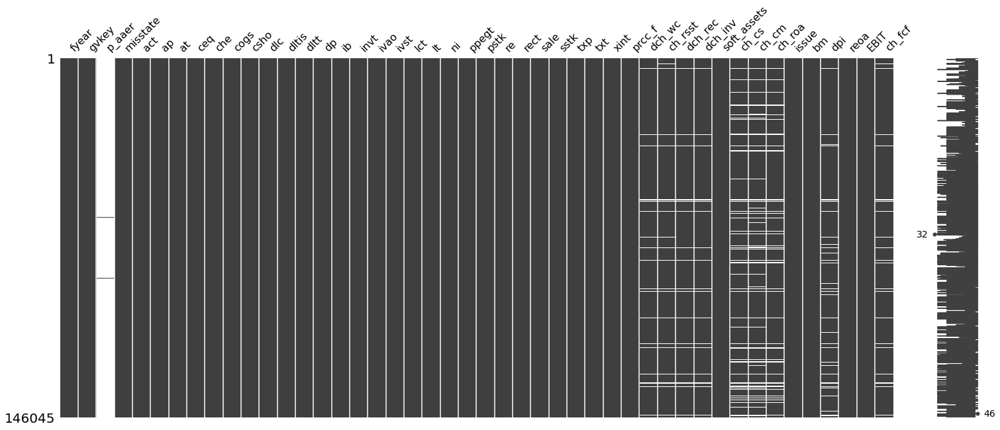

In [73]:
# distribution of missing values in the data
import missingno as msno
msno.matrix(df)
plt.show()

In [74]:
# droping the column p_aaer 

df_na=df.drop(columns="p_aaer")

In [75]:
# make a dataframe miss with only columns having missing values 
miss=pd.DataFrame()
for i in df_na.columns:
    x=np.where(df_na[i].isnull(),1,0)
    if(x.mean()!=0):
        miss[i]=df_na[i]
  

In [76]:
miss=pd.merge(df_na[["fyear","misstate"]], miss,how="inner",left_on=miss.index, right_on=df_na["fyear"].index)

miss.drop(columns=["key_0"], inplace=True)
miss

,fyear,misstate,dch_wc,ch_rsst,dch_rec,dch_inv,soft_assets,ch_cs,ch_cm,ch_roa,bm,dpi,reoa,EBIT,ch_fcf
0,1990,0,0.069595,0.046043,0.041935,0.033034,0.312448,0.095082,0.082631,-0.019761,0.413170,0.873555,0.167620,0.161961,-0.042140
1,1990,0,-0.065604,-0.240937,-0.006248,-0.026684,0.315904,0.188832,-0.211389,-0.117832,0.157887,0.745139,-0.428957,-0.157888,0.100228
2,1990,0,0.092822,0.020143,0.002156,0.002746,0.605342,0.097551,-0.105780,0.091206,2.231337,1.015131,0.394768,0.063681,0.066348
3,1990,0,0.014060,0.035120,0.035583,0.008332,0.793068,-0.005725,-0.249704,0.017545,1.043582,1.026261,0.094822,0.088347,-0.017358
4,1990,0,-0.540503,-0.575325,-0.102153,-0.222022,0.869182,-0.231536,-1.674893,-0.466667,-1.602508,0.598443,-0.942379,-0.700821,0.130349
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
146040,2014,0,-0.010251,0.204761,0.011437,0.000000,0.751944,0.560406,0.127217,-0.050591,0.103693,0.829680,-0.327178,-0.008179,-0.261606
146041,2014,0,0.063226,0.341147,0.054938,0.034174,0.742781,-0.118178,0.031360,0.095355,0.581796,0.743084,-0.077826,0.000461,-0.296702
146042,2014,0,-0.011512,0.011762,-0.003103,0.023024,0.751129,0.004207,-0.037925,0.072050,-0.000903,1.063878,-0.002877,0.153133,0.065569
146043,2014,0,0.011416,0.495038,0.006844,-0.000296,0.018001,NaN,NaN,NaN,1.109467,NaN,0.000000,0.028804,NaN


In [77]:
# columns and rows with nan values
miss=miss[miss.isnull().any(axis=1)]
pd.set_option("display.max_rows",19562)

miss

,fyear,misstate,dch_wc,ch_rsst,dch_rec,dch_inv,soft_assets,ch_cs,ch_cm,ch_roa,bm,dpi,reoa,EBIT,ch_fcf
9,1990,0,2.276423e-01,-1.117886e+00,0.000000,0.000000e+00,0.809524,NaN,NaN,-1.520085,-0.156728,NaN,-22.174603,-7.016393,1.189024e-01
30,1990,0,4.853338e-01,6.212096e-01,0.207501,2.682062e-01,0.603320,9.600000e+00,-0.786026,0.257403,1.332365,NaN,0.150428,0.089809,-6.060481e-01
166,1990,0,-4.340000e-15,1.504204e+00,0.000000,0.000000e+00,NaN,NaN,NaN,1.621628,-0.002760,NaN,NaN,NaN,4.855265e-01
227,1990,0,3.389209e-01,-1.242481e-01,0.293013,0.000000e+00,0.923262,-2.228750e+00,NaN,0.014524,0.966868,0.653156,-0.202583,-0.043703,1.479570e-01
322,1990,0,-1.591168e-01,-1.534123e-01,-0.079238,-9.005400e-03,0.600685,NaN,NaN,NaN,-4.891304,NaN,-0.334770,-0.047358,NaN
374,1990,0,7.515834e-02,9.458128e-02,0.000000,0.000000e+00,0.035732,-1.000000e+00,NaN,0.780176,0.125382,1.365408,-2.964268,-0.167324,1.125968e+00
380,1990,0,7.464567e-02,4.301697e-03,0.008537,1.436119e-01,0.697239,NaN,NaN,NaN,0.946184,NaN,0.385496,0.103549,NaN
487,1990,0,-1.283533e-02,1.019122e-01,0.009841,-3.076627e-02,0.827421,NaN,NaN,NaN,0.487325,NaN,0.466339,0.169673,NaN
506,1990,0,NaN,NaN,0.072195,9.394990e-02,0.309468,2.255857e+00,-0.351043,0.026031,0.460195,1.180657,0.250241,0.115694,NaN
547,1990,0,6.090045e-01,1.504204e+00,-0.304659,0.000000e+00,0.020906,-6.137011e-01,1.157152,-0.153761,0.836000,NaN,-0.132404,-0.125436,-1.894150e+00


In [78]:
#fraud distribution in nan rows
miss["misstate"].value_counts()

0    19507
1       55
Name: misstate, dtype: int64

In [79]:
# total rows with atleast one missing value
len(miss["dch_wc"])

19562

In [80]:
miss_yr=miss.groupby("fyear")[["misstate"]].sum()

In [81]:
# calculating  cases in each year of missing data 
miss_yr=miss.groupby("fyear")[["misstate"]].sum()
miss_yr.rename(columns={"misstate":"Total Fraud"}, inplace=True)

miss_yr["Non Fraud"] =miss.groupby("fyear")["misstate"].count()-miss_yr["Total Fraud"]

miss_yr.iloc[0:12]

,Total Fraud,Non Fraud
fyear,,
1990,0,434
1991,3,486
1992,3,553
1993,10,800
1994,2,838
1995,1,906
1996,3,1076
1997,2,593
1998,5,595


In [82]:
miss_yr.iloc[12:25]

,Total Fraud,Non Fraud
fyear,,
2002,2,676
2003,2,666
2004,4,685
2005,1,696
2006,0,794
2007,2,829
2008,2,708
2009,2,661
2010,1,741


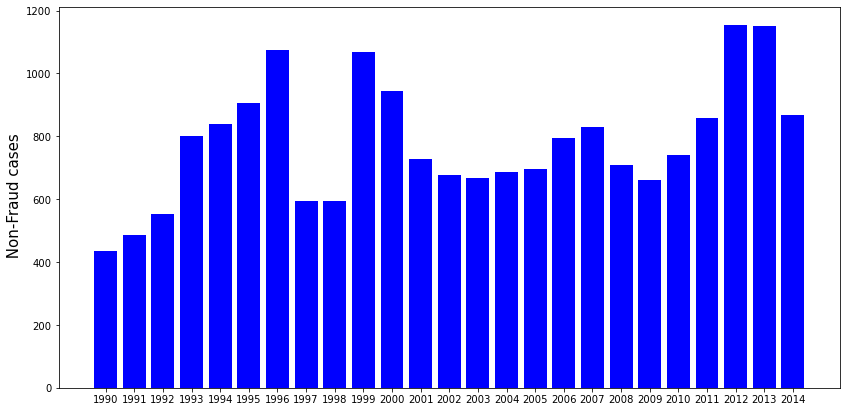

In [83]:
#plot the distribution of non-fraud over the years of the missing data

plt.figure(figsize=(14,7))

plt.bar(x=miss_yr.index,height=miss_yr["Non Fraud"],color="blue")
plt.xticks(miss_yr.index)
plt.ylabel(" Non-Fraud cases", fontsize=15)
plt.show()


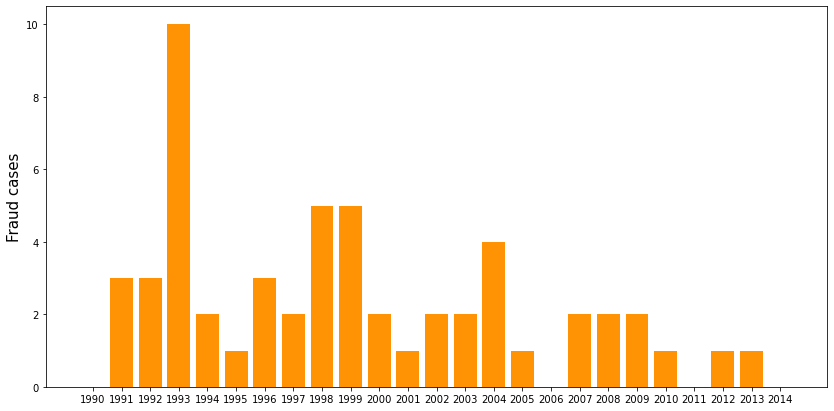

In [84]:
#plot the distribution of non-fraud over the years of the missing data
plt.figure(figsize=(14,7))
plt.bar(x=miss_yr.index,height=miss_yr["Total Fraud"],color="#FF9303")
plt.xticks(miss_yr.index)
plt.ylabel("Fraud cases", fontsize=15)
plt.show()

In [85]:
# delete any row with a nan value
df_na=df_na.dropna(axis=0, how='any')

In [86]:
df_na

,fyear,gvkey,misstate,act,ap,at,ceq,che,cogs,csho,dlc,dltis,dltt,dp,ib,invt,ivao,ivst,lct,lt,ni,ppegt,pstk,re,rect,sale,sstk,txp,txt,xint,prcc_f,dch_wc,ch_rsst,dch_rec,dch_inv,soft_assets,ch_cs,ch_cm,ch_roa,issue,bm,dpi,reoa,EBIT,ch_fcf
0,1990,1009,0,10.047,3.736,32.335,6.262,0.002,30.633,2.526,3.283,32.853,17.691,1.971,1.431,2.355,0.000,0.000,8.382,26.073,2.135,31.767,0.000,5.420,6.895,40.522,0.000,0.000,0.769,2.333,6.000,0.069595,0.046043,0.041935,0.033034,0.312448,0.095082,0.082631,-0.019761,1,0.413170,0.873555,0.167620,0.161961,-0.042140
1,1990,1011,0,1.247,0.803,7.784,0.667,0.171,1.125,3.556,0.021,2.017,5.871,0.700,-1.869,0.663,0.132,0.000,1.246,7.117,-1.869,7.328,0.000,-3.339,0.290,3.635,0.006,0.000,0.000,0.640,1.188,-0.065604,-0.240937,-0.006248,-0.026684,0.315904,0.188832,-0.211389,-0.117832,1,0.157887,0.745139,-0.428957,-0.157888,0.100228
2,1990,1017,0,55.040,3.601,118.120,44.393,3.132,107.343,3.882,6.446,6.500,37.603,6.271,1.722,4.292,12.989,2.913,32.615,73.727,2.574,78.331,0.000,46.630,47.366,144.258,0.000,0.000,0.986,3.962,5.125,0.092822,0.020143,0.002156,0.002746,0.605342,0.097551,-0.105780,0.091206,1,2.231337,1.015131,0.394768,0.063681,0.066348
3,1990,1021,0,24.684,3.948,34.591,7.751,0.411,31.214,4.755,8.791,0.587,8.906,1.325,0.422,15.463,0.000,0.000,16.208,25.545,0.422,11.145,1.295,3.280,8.522,48.292,0.000,0.448,0.365,2.269,1.562,0.014060,0.035120,0.035583,0.008332,0.793068,-0.005725,-0.249704,0.017545,1,1.043582,1.026261,0.094822,0.088347,-0.017358
4,1990,1028,0,17.325,3.520,27.542,-12.142,1.017,32.662,6.735,32.206,0.000,0.266,2.711,-23.577,8.971,0.000,0.000,39.418,39.684,-22.812,5.782,0.000,-25.955,6.354,33.543,0.000,0.000,0.000,3.510,1.125,-0.540503,-0.575325,-0.102153,-0.222022,0.869182,-0.231536,-1.674893,-0.466667,0,-1.602508,0.598443,-0.942379,-0.700821,0.130349
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
146039,2014,311798,0,167.320,4.021,1260.060,972.016,159.564,0.000,3896.103,0.000,194.413,210.050,1.459,-26.767,0.000,0.000,23.467,29.071,288.044,-26.767,1083.099,0.000,-227.664,1.913,0.000,119.541,0.000,0.000,15.155,0.095,0.085366,-0.025508,0.000541,0.000000,0.015362,-1.718931,0.435251,0.009248,1,2.626149,0.820630,-0.180677,-0.009215,0.030761
146040,2014,314866,0,262.600,12.400,1234.800,194.100,166.200,214.400,97.748,23.200,585.600,499.200,33.800,-90.400,0.000,9.200,0.000,413.100,1040.700,-90.400,191.100,0.000,-404.000,80.800,474.600,323.800,1.700,25.700,54.600,19.150,-0.010251,0.204761,0.011437,0.000000,0.751944,0.560406,0.127217,-0.050591,1,0.103693,0.829680,-0.327178,-0.008179,-0.261606
146041,2014,315318,0,1578.400,106.700,4557.600,2459.600,997.300,324.400,182.067,15.100,678.800,1400.800,86.700,-29.900,205.800,2.300,600.000,242.600,2005.000,-29.900,193.100,0.000,-354.700,327.300,843.200,1512.600,16.700,-6.700,38.700,23.220,0.063226,0.341147,0.054938,0.034174,0.742781,-0.118178,0.031360,0.095355,1,0.581796,0.743084,-0.077826,0.000461,-0.296702
146042,2014,316056,0,973.800,249.500,2015.900,-4.800,290.500,1185.500,95.831,49.600,956.300,1215.000,44.000,186.300,360.600,23.500,0.000,531.300,1997.400,175.200,586.800,0.000,-5.800,259.900,2118.300,14.100,36.300,84.200,49.300,55.460,-0.011512,0.011762,-0.003103,0.023024,0.751129,0.004207,-0.037925,0.072050,1,-0.000903,1.063878,-0.002877,0.153133,0.065569


# AFTER REMOVING MISSING VALUES

In [87]:
df_na.isnull().sum()

fyear          0
gvkey          0
misstate       0
act            0
ap             0
at             0
ceq            0
che            0
cogs           0
csho           0
dlc            0
dltis          0
dltt           0
dp             0
ib             0
invt           0
ivao           0
ivst           0
lct            0
lt             0
ni             0
ppegt          0
pstk           0
re             0
rect           0
sale           0
sstk           0
txp            0
txt            0
xint           0
prcc_f         0
dch_wc         0
ch_rsst        0
dch_rec        0
dch_inv        0
soft_assets    0
ch_cs          0
ch_cm          0
ch_roa         0
issue          0
bm             0
dpi            0
reoa           0
EBIT           0
ch_fcf         0
dtype: int64

In [88]:
# creating a new list misstate and replacing 0 as non- fraud and 1 as fraud

misstate_na=df_na["misstate"].copy()

# creating a dict file 
j = {1:'Fraud' ,0:'Non-Fraud'}

misstate_na=[j[i] for i in df_na["misstate"]]

Number of Non-Frauds:  125574
Number of Frauds:  909


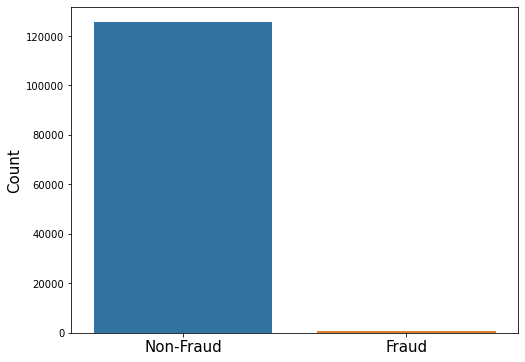

In [89]:
#plot fraud count

plt.figure(figsize=(8,6))
ax=sns.countplot(x=misstate_na)
plt.ylabel("Count", fontsize=15)
plt.xticks(size=15)

print("Number of Non-Frauds: ",df_na['misstate'].value_counts()[0])
print("Number of Frauds: ",df_na['misstate'].value_counts()[1])

In [90]:
print("Percentage of fraud companies after removing missing values",(909/df_na.shape[0])*100)
print("Percentage of non-fraud companies after removing missing values ",(125574/df_na.shape[0])*100)

Percentage of fraud companies after removing missing values 0.7186736557482033
Percentage of non-fraud companies after removing missing values  99.2813263442518


In [91]:

fraud_na=pd.DataFrame({"misstatment":["Non-Fraud", "Fraud"],"Total Count":[125574, 909], "Percentage(%)":[99.281,0.718]
                   })
fraud_na

,misstatment,Total Count,Percentage(%)
0,Non-Fraud,125574,99.281
1,Fraud,909,0.718


In [92]:
#ploting fraud distribution after handling missisng values

df1_na=df_na.groupby("fyear")[['misstate']].sum()
df1_na.rename(columns={"misstate":"Total Fraud"}, inplace=True)

df1_na["Fraud Percent(%)"]=(df_na.groupby("fyear")["misstate"].sum()/df_na.groupby("fyear")["misstate"].count())*100


In [93]:
df1_na.iloc[0:12]

,Total Fraud,Fraud Percent(%)
fyear,,
1990,15,0.361620
1991,24,0.568182
1992,23,0.521069
1993,20,0.437924
1994,21,0.433526
1995,21,0.394514
1996,30,0.529474
1997,40,0.645786
1998,51,0.833878


In [94]:
df1_na.iloc[12:25]

,Total Fraud,Fraud Percent(%)
fyear,,
2002,75,1.391724
2003,67,1.261058
2004,54,1.029552
2005,44,0.851723
2006,33,0.645287
2007,28,0.555886
2008,24,0.489596
2009,29,0.616497
2010,25,0.537981


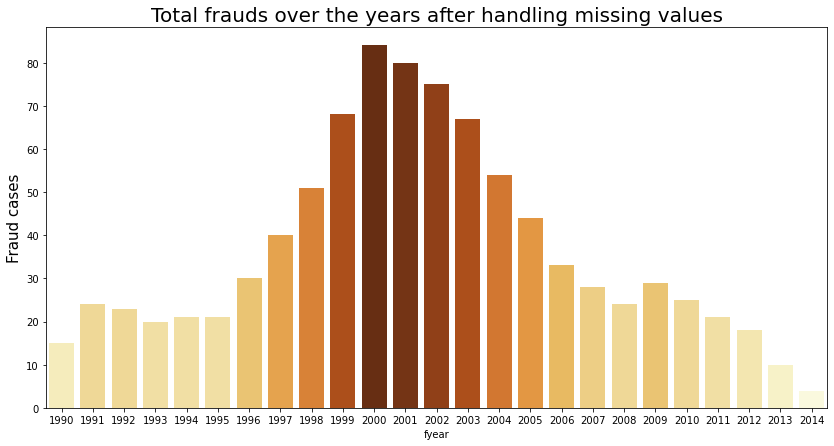

In [95]:
#plot the distribution of total fraud over the years after handling the missing data

plt.figure(figsize=(14,7))

def colors_from_values(values, palette_name):
    # normalize the values to range [0, 1]
    normalized = (values - min(values)) / (max(values) - min(values))
    # convert to indices
    indices = np.round(normalized * (len(values) - 1)).astype(np.int32)
    # use the indices to get the colors
    palette = sns.color_palette(palette_name, len(values))
    return np.array(palette).take(indices, axis=0)


sns.barplot(x=df1_na.index,y="Total Fraud",data=df1_na, palette=colors_from_values(df1_na["Total Fraud"], "YlOrBr"))
plt.title("Total frauds over the years after handling missing values", fontsize=20)
plt.ylabel("Fraud cases", fontsize=15)
plt.show()

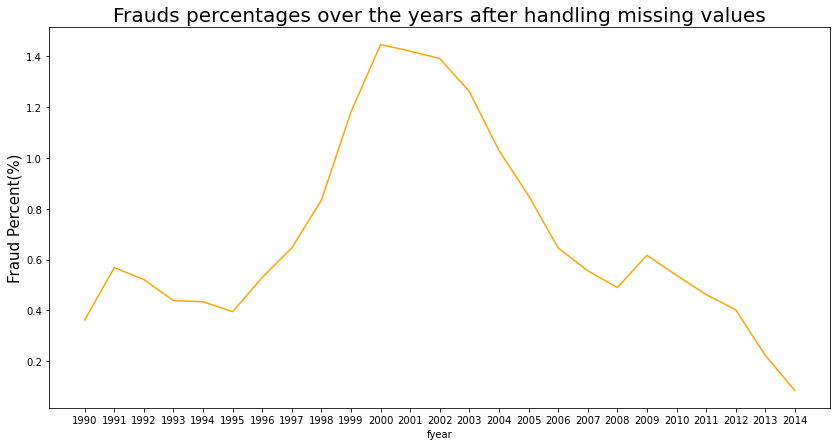

In [96]:
#plot the distribution of total fraud percentage over the years after handling the missing data
plt.figure(figsize=(14,7))
sns.lineplot(x=df1_na.index,y="Fraud Percent(%)",data=df1_na, color="orange")

plt.title("Frauds percentages over the years after handling missing values", fontsize=20)
plt.xticks(df1_na.index)
plt.ylabel("Fraud Percent(%)", fontsize=15)
plt.show()

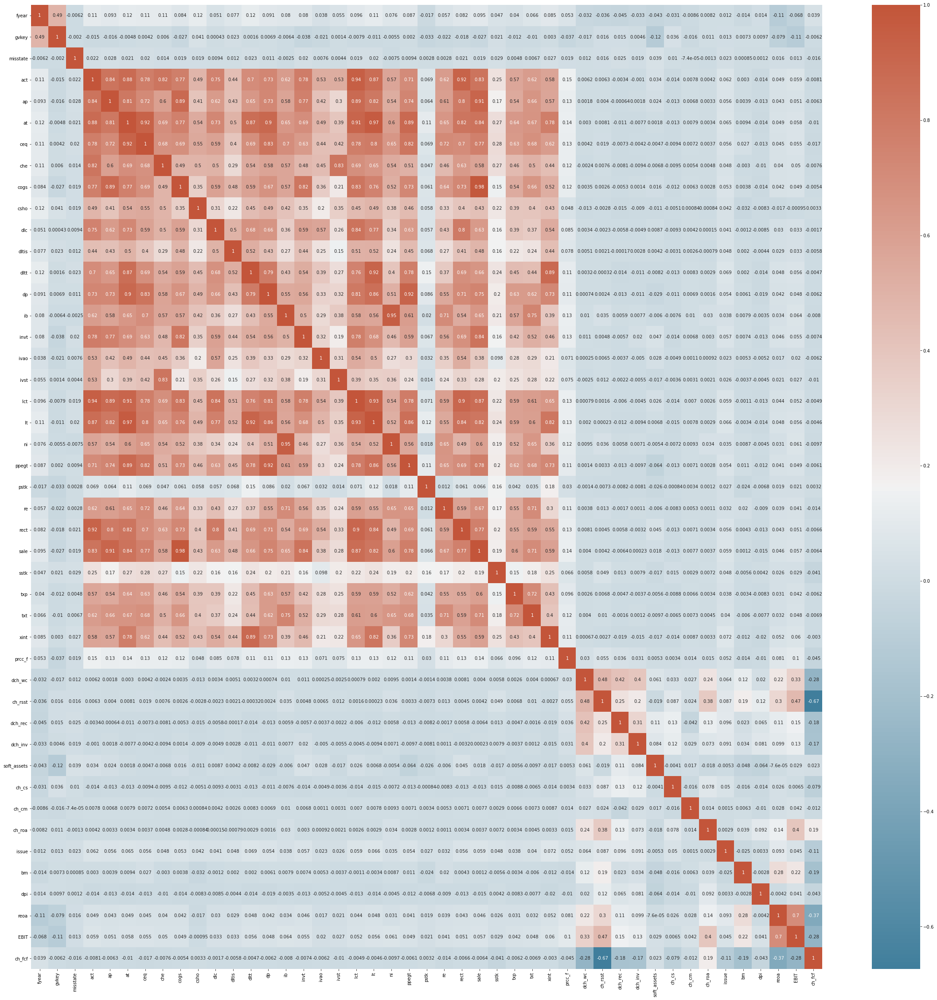

In [97]:
import matplotlib.pyplot as plt
fig=plt.figure(figsize=(40,40))
ax=fig.add_subplot(1,1,1)
cmap=sns.diverging_palette(230,20, as_cmap=True)
sns.heatmap(df_na.corr(), annot=True, cmap=cmap)
plt.show()

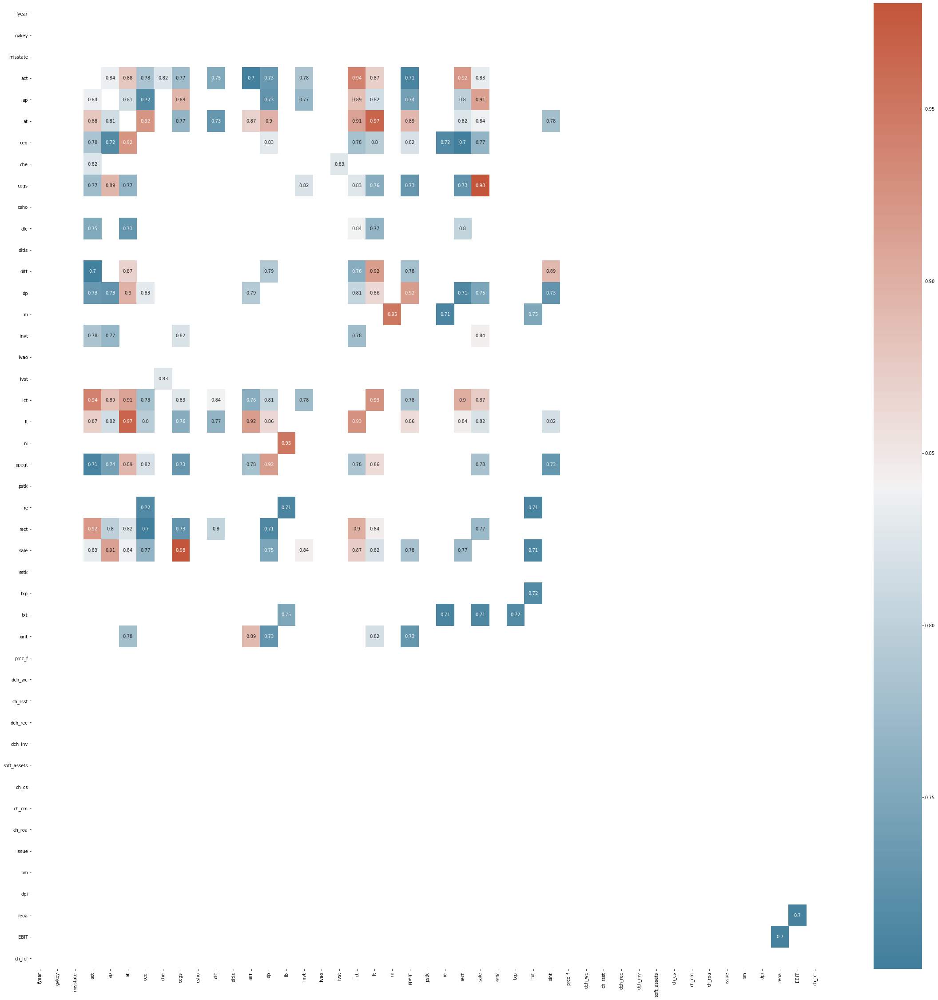

In [98]:
dfCorr = df_na.corr()
filteredDf = dfCorr[((dfCorr >= .7) | (dfCorr <= -.7)) & (dfCorr !=1.000)]
plt.figure(figsize=(40,40))
cmap=sns.diverging_palette(230,20, as_cmap=True)
sns.heatmap(filteredDf, annot=True, cmap=cmap)
plt.show()

In [99]:
# calculating the correlations

def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

def get_top_abs_correlations(df, n=5):
    au_corr = df_na.corr().abs().unstack()
    labels_to_drop = get_redundant_pairs(df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=False)
    return au_corr[0:n]

#Calcualting the features with top 90 highest correlations
cor=get_top_abs_correlations(df_na, 90)
print("Top Absolute Correlations \n")
print(get_top_abs_correlations(df_na, 90))

Top Absolute Correlations 

cogs   sale     0.980711
at     lt       0.966052
ib     ni       0.951427
act    lct      0.941919
lct    lt       0.926172
at     ceq      0.923784
act    rect     0.921538
dp     ppegt    0.916761
dltt   lt       0.915847
ap     sale     0.912027
at     lct      0.911523
lct    rect     0.902560
at     dp       0.897462
ap     cogs     0.894720
at     ppegt    0.892802
dltt   xint     0.891742
ap     lct      0.885602
act    at       0.877748
lct    sale     0.872664
act    lt       0.871819
at     dltt     0.868598
dp     lt       0.862439
lt     ppegt    0.861091
       rect     0.843785
invt   sale     0.843068
dlc    lct      0.839966
at     sale     0.838303
act    ap       0.836391
       sale     0.833221
ceq    dp       0.830330
cogs   lct      0.825849
che    ivst     0.825690
at     rect     0.824925
act    che      0.824549
cogs   invt     0.821603
lt     sale     0.819608
ceq    ppegt    0.818998
lt     xint     0.817029
ap     lt       0.8154

In [100]:
cor=pd.DataFrame(get_top_abs_correlations(df_na, 90), columns=["Correlation"])

In [101]:
cor.iloc[0:25]

,,Correlation
cogs,sale,0.980711
at,lt,0.966052
ib,ni,0.951427
act,lct,0.941919
lct,lt,0.926172
at,ceq,0.923784
act,rect,0.921538
dp,ppegt,0.916761
dltt,lt,0.915847
ap,sale,0.912027


In [102]:
cor.iloc[25:50]

Correlation
dlc   lct       0.839966
at    sale      0.838303
act   ap        0.836391
      sale      0.833221
ceq   dp        0.830330
cogs  lct       0.825849
che   ivst      0.825690
at    rect      0.824925
act   che       0.824549
cogs  invt      0.821603
lt    sale      0.819608
ceq   ppegt     0.818998
lt    xint      0.817029
ap    lt        0.815458
      at        0.814408
dp    lct       0.805531
dlc   rect      0.802866
ap    rect      0.799745
ceq   lt        0.796426
dltt  dp        0.792398
lct   ppegt     0.784831
act   invt      0.784596
      ceq       0.783607
ppegt sale      0.781973
ceq   lct       0.780933

In [103]:
cor.iloc[50:75]

,,Correlation
dltt,ppegt,0.780455
at,xint,0.778121
invt,lct,0.775375
act,cogs,0.774022
rect,sale,0.770383
ap,invt,0.768119
dlc,lt,0.765582
at,cogs,0.765424
ceq,sale,0.765346
dltt,lct,0.757267


In [104]:
cor.iloc[75:84]

Correlation
dp   rect      0.712636
sale txt       0.711998
ib   re        0.709015
re   txt       0.707797
act  ppegt     0.707456
reoa EBIT      0.704986
act  dltt      0.703319
ceq  rect      0.700144
     ib        0.697460

In [105]:
#summary of data 
df_na.describe()

,fyear,gvkey,misstate,act,ap,at,ceq,che,cogs,csho,dlc,dltis,dltt,dp,ib,invt,ivao,ivst,lct,lt,ni,ppegt,pstk,re,rect,sale,sstk,txp,txt,xint,prcc_f,dch_wc,ch_rsst,dch_rec,dch_inv,soft_assets,ch_cs,ch_cm,ch_roa,issue,bm,dpi,reoa,EBIT,ch_fcf
count,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000
mean,2001.899291,49378.913000,0.007187,828.750005,204.423338,2665.276549,997.174838,245.227578,1472.520219,99.002474,141.739622,223.956058,604.368606,127.338143,111.958908,189.178690,106.187218,74.692118,635.290038,1610.341781,112.572452,1915.341808,10.274323,498.895889,301.183452,2143.786797,28.625899,26.741211,62.989723,44.813972,16.444310,-0.000743,0.016228,0.011743,0.006584,0.514201,0.199275,-0.086375,-0.008330,0.876560,0.510429,1.035481,-2.008913,-0.131294,-0.004296
std,6.919951,57667.893635,0.084470,3960.274269,1109.801458,12690.650167,5388.371223,1414.038888,8402.045168,452.825247,1083.462616,1733.618385,2818.506941,706.323675,943.806617,986.355567,1497.031538,838.693627,3340.825327,7639.275412,1036.097651,10975.960879,100.409290,5152.345876,1662.653752,10987.362544,224.531074,207.994492,495.434844,189.413374,45.077238,0.149520,0.344284,0.079331,0.055581,0.260947,1.329698,2.756747,0.322912,0.328942,1.274880,0.461018,9.337705,0.769578,0.438279
min,1990.000000,1004.000000,0.000000,-0.254000,0.000000,0.001000,-25560.000000,-34.000000,-366.645000,0.001000,-0.069000,-19.687000,0.000000,-4.385000,-44574.000000,0.000000,-320.866000,0.000000,0.000000,0.000000,-98696.000000,0.000000,-123.000000,-143336.328000,-0.167000,-21.796000,-516.713000,-66.000000,-27650.485000,-0.875000,0.000000,-0.999628,-2.072079,-0.304659,-0.222022,0.004515,-6.484197,-17.359699,-1.671565,0.000000,-7.034304,0.151757,-89.013245,-7.016393,-2.980601
25%,1996.000000,9629.000000,0.000000,12.596500,1.700000,26.900000,9.566500,1.628000,12.150500,8.867000,0.042000,0.000000,0.031000,0.907000,-3.835000,0.113000,0.000000,0.000000,6.228000,9.783500,-4.080000,8.537000,0.000000,-29.506500,2.582000,19.697500,0.000000,0.000000,0.000000,0.150000,2.020000,-0.030417,-0.056587,-0.011251,-0.002794,0.303050,-0.063804,-0.251914,-0.055007,1.000000,0.223529,0.860950,-0.660999,-0.083797,-0.107002
50%,2002.000000,23170.000000,0.000000,64.196000,8.817000,144.657000,63.322000,12.175000,77.263000,22.923000,1.880000,0.300000,7.830000,5.630000,1.502000,6.442000,0.000000,0.000000,30.534000,58.863000,1.479000,56.117000,0.000000,2.099000,17.253000,129.375000,0.645000,0.000000,0.761000,1.490000,8.070000,0.003830,0.023912,0.005488,0.000000,0.540080,0.071128,-0.022579,-0.001825,1.000000,0.470743,0.974718,0.028852,0.052168,-0.023850
75%,2008.000000,64910.000000,0.000000,310.539500,54.412000,852.675500,340.240000,74.364000,477.278000,62.170500,16.514000,36.230500,175.891500,36.266500,27.908500,59.652000,1.508500,3.557500,171.202500,459.508500,27.805500,420.033000,0.000000,100.482500,100.028500,753.207000,7.600000,1.888500,13.964000,15.389000,21.950000,0.042523,0.106347,0.033664,0.015519,0.728527,0.252464,0.139169,0.039606,1.000000,0.831552,1.092663,0.257901,0.111247,0.057534
max,2014.000000,317264.000000,1.000000,152629.000000,39903.000000,410074.000000,284434.000000,85709.000000,435726.253000,91125.785000,75553.000000,188791.978000,120274.000000,32301.200000,45220.000000,46756.000000,161907.634000,77040.000000,142963.000000,254598.000000,98806.045000,487365.986000,7815.000000,389427.000000,86285.797000,483521.000000,30563.000000,12727.0

In [106]:
#summary of  fraud cases
df_na[df_na["misstate"]==1].describe()

,fyear,gvkey,misstate,act,ap,at,ceq,che,cogs,csho,dlc,dltis,dltt,dp,ib,invt,ivao,ivst,lct,lt,ni,ppegt,pstk,re,rect,sale,sstk,txp,txt,xint,prcc_f,dch_wc,ch_rsst,dch_rec,dch_inv,soft_assets,ch_cs,ch_cm,ch_roa,issue,bm,dpi,reoa,EBIT,ch_fcf
count,909.000000,909.000000,909.0,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000
mean,2001.392739,48013.473047,1.0,1833.229165,565.923125,5811.316704,2286.045926,475.158669,3327.600293,197.744334,261.165226,474.363147,1353.361718,222.424524,84.367800,423.454737,239.913447,117.992496,1392.279011,3402.340109,20.746241,3127.728590,13.583458,669.813466,713.645505,4615.020432,105.550121,38.411397,102.130484,104.769812,26.493455,0.020070,0.080775,0.035107,0.019123,0.633547,0.360334,-0.088761,-0.013115,0.965897,0.523226,1.041915,-0.205365,-0.009321,-0.087812
std,5.353659,57430.316034,0.0,5143.063737,1833.134930,22821.033399,12142.291857,1998.185612,9408.671267,598.580375,906.344869,2018.267448,5382.461261,848.140423,2124.859045,1270.616444,1086.523253,809.757875,3823.109558,11278.646769,3642.305986,17519.921089,93.163399,6130.844865,2017.931638,12708.162268,1047.526513,156.871920,476.043639,474.066933,34.010696,0.135664,0.270558,0.092940,0.062692,0.217801,1.141815,2.367507,0.212891,0.181595,0.622083,0.445447,2.480268,0.438144,0.284173
min,1990.000000,1009.000000,1.0,0.031000,0.000000,0.147000,-3539.000000,0.000000,0.000000,1.173000,0.000000,0.000000,0.000000,0.003000,-44574.000000,0.000000,0.000000,0.000000,0.016000,0.016000,-98696.000000,0.000000,0.000000,-102362.000000,0.000000,0.000000,0.000000,-0.173000,-3164.000000,0.000000,0.031000,-0.999628,-2.072079,-0.304659,-0.222022,0.004515,-6.484197,-17.359699,-1.671565,0.000000,-7.034304,0.151757,-68.520161,-7.016393,-2.495896
25%,1998.000000,9494.000000,1.0,58.722000,6.505000,100.328000,49.575000,5.880000,46.502000,15.167000,0.271000,0.000000,1.106000,2.835000,-4.163000,1.050000,0.000000,0.000000,25.310000,35.247000,-4.590000,21.312000,0.000000,-18.877000,15.259000,92.976000,0.616000,0.000000,0.020000,0.553000,7.010000,-0.023581,-0.021698,-0.004430,-0.000488,0.490343,0.007801,-0.218629,-0.050572,1.000000,0.212785,0.866755,-0.144991,-0.004329,-0.151102
50%,2001.000000,25216.000000,1.0,240.089000,30.018000,570.930000,269.721000,52.298000,260.128000,34.972000,5.000000,11.473000,75.100000,18.200000,8.235000,27.921000,0.000000,0.000000,103.055000,261.539000,8.314000,134.875000,0.000000,20.632000,75.634000,451.056000,5.721000,0.046000,5.524000,5.902000,17.900000,0.010042,0.047834,0.017000,0.001661,0.681376,0.143928,-0.026883,-0.004866,1.000000,0.384393,0.979310,0.091733,0.064652,-0.046469
75%,2005.000000,64130.000000,1.0,1262.337000,214.799000,2925.286000,1091.401000,237.942000,1505.972000,113.051000,51.275000,201.152000,545.255000,91.216000,69.837000,194.571000,14.650000,17.292000,619.800000,1791.600000,69.020000,861.779000,0.000000,326.166000,342.904000,2296.400000,37.730000,7.735000,38.243000,42.237000,35.690000,0.053584,0.149813,0.059478,0.025752,0.800280,0.424235,0.130933,0.028198,1.000000,0.687954,1.101919,0.237847,0.115711,0.012682
max,2014.000000,284041.000000,1.0,64592.000000,18918.426000,331645.000000,181494.000000,33245.000000,97981.000000,6522.248000,9232.000000,28445.000000,88570.000000,11256.000000,20121.000000,15165.000000,13259.000000,15612.000000,36364.000000,162606.000000,20121.000000,280841.000000,1130.000000,71834.000000,18604.000000,145915.000000,30563.000000,2825.000000,6732.000000,8479.000000,440.000000,0.609004,1.380555,0.382809,0.268206,0.993599,9.600000,16.573810,1.621628,1.000000,4.670805,4.036458,0.784573,0.550619,1.314497


In [107]:
df_na[df_na["misstate"]==0].describe()

,fyear,gvkey,misstate,act,ap,at,ceq,che,cogs,csho,dlc,dltis,dltt,dp,ib,invt,ivao,ivst,lct,lt,ni,ppegt,pstk,re,rect,sale,sstk,txp,txt,xint,prcc_f,dch_wc,ch_rsst,dch_rec,dch_inv,soft_assets,ch_cs,ch_cm,ch_roa,issue,bm,dpi,reoa,EBIT,ch_fcf
count,125574.000000,125574.000000,125574.0,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000
mean,2001.902958,49388.797092,0.0,821.478822,201.806528,2642.503121,987.845010,243.563162,1459.091741,98.287706,140.875129,222.143421,598.946825,126.649836,112.158633,187.482822,105.219206,74.378677,629.810376,1597.369936,113.237160,1906.565632,10.250369,497.658658,298.197739,2125.898131,28.069063,26.656734,62.706392,44.379966,16.371567,-0.000894,0.015761,0.011574,0.006493,0.513337,0.198109,-0.086358,-0.008295,0.875914,0.510337,1.035434,-2.021968,-0.132177,-0.003691
std,6.929880,57669.719712,0.0,3949.516869,1102.417234,12584.929130,5307.214464,1408.802186,8392.865644,451.523129,1084.594380,1731.264599,2790.683041,705.150444,929.820421,983.801698,1499.553173,838.894413,3336.471439,7605.112756,992.612902,10913.916771,100.459783,5144.592650,1659.440813,10971.951956,206.885226,208.316914,495.562998,185.703711,45.139405,0.149605,0.344717,0.079199,0.055517,0.261035,1.330894,2.759372,0.323572,0.329681,1.278392,0.461130,9.367802,0.771389,0.439140
min,1990.000000,1004.000000,0.0,-0.254000,0.000000,0.001000,-25560.000000,-34.000000,-366.645000,0.001000,-0.069000,-19.687000,0.000000,-4.385000,-30138.590000,0.000000,-320.866000,0.000000,0.000000,0.000000,-38468.000000,0.000000,-123.000000,-143336.328000,-0.167000,-21.796000,-516.713000,-66.000000,-27650.485000,-0.875000,0.000000,-0.999628,-2.072079,-0.304659,-0.222022,0.004515,-6.484197,-17.359699,-1.671565,0.000000,-7.034304,0.151757,-89.013245,-7.016393,-2.980601
25%,1996.000000,9643.000000,0.0,12.492000,1.689000,26.621250,9.471000,1.615000,12.046250,8.840000,0.042000,0.000000,0.030000,0.900000,-3.834000,0.111000,0.000000,0.000000,6.186000,9.704000,-4.076750,8.474250,0.000000,-29.566500,2.550000,19.511500,0.000000,0.000000,0.000000,0.149000,2.000000,-0.030488,-0.056867,-0.011311,-0.002819,0.301708,-0.064444,-0.252223,-0.055032,1.000000,0.223704,0.860893,-0.667145,-0.084499,-0.106701
50%,2002.000000,23137.000000,0.0,63.620500,8.728000,143.216500,62.685000,12.062000,76.474000,22.839500,1.867000,0.293000,7.729500,5.582000,1.477000,6.387500,0.000000,0.000000,30.235000,58.256500,1.452000,55.781000,0.000000,2.049000,17.045500,128.046000,0.631000,0.000000,0.746000,1.477000,8.000000,0.003795,0.023740,0.005426,0.000000,0.538897,0.070736,-0.022554,-0.001805,1.000000,0.471430,0.974679,0.028294,0.052066,-0.023679
75%,2008.000000,64915.000000,0.0,307.565250,53.937500,843.983500,336.295250,73.556250,472.913500,61.966500,16.370000,35.462750,173.974500,35.974000,27.675000,59.151250,1.500000,3.518000,169.610500,453.816250,27.558500,417.592250,0.000000,99.552500,98.869750,747.031500,7.498000,1.864000,13.799500,15.260750,21.810000,0.042413,0.106015,0.033480,0.015443,0.727463,0.251386,0.139228,0.039687,1.000000,0.832280,1.092600,0.258047,0.111225,0.058009
max,2014.000000,317264.000000,0.0,152629.000000,39903.000000,410074.000000,284434.000000,85709.000000,435726.253000,91125.785000,75553.000000,188791.978000,120274.000000,32301.200000,45220.000000,46756.000000,161907.634000,77040.000000,142963.000000,254598.000000,98806.045000,487365.986000,7815.000000,389427.000000,86285.797000,483521.000000,27619.000000,12727.000000,36530.000000,6734.000000,5010.000000,

In [108]:
df_na.to_csv("D:/Disertation/fraud_45.csv", index=False)

In [323]:
df_na=pd.read_csv("D:/Disertation/fraud_45.csv")

In [324]:
# drop all features with 0.9 or grater correlation
df_c9=df_na.drop(["cogs","ap","lt","ceq","lct","dltt","ppegt","ib","dp","rect"], axis=1)

In [325]:
# drop all features with 0.8 or greater correlation
df_c8=df_c9.drop(columns=["at","act","che","ivst","sale"], axis=1)

In [326]:
# drop all features with 0.7 or greater correlation
df_c7=df_c8.drop(columns=["re","txp","reoa"], axis=1)

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\matrix.py:204: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
C:\ProgramData\Anaconda3\lib\site-packages\seaborn\matrix.py:209: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


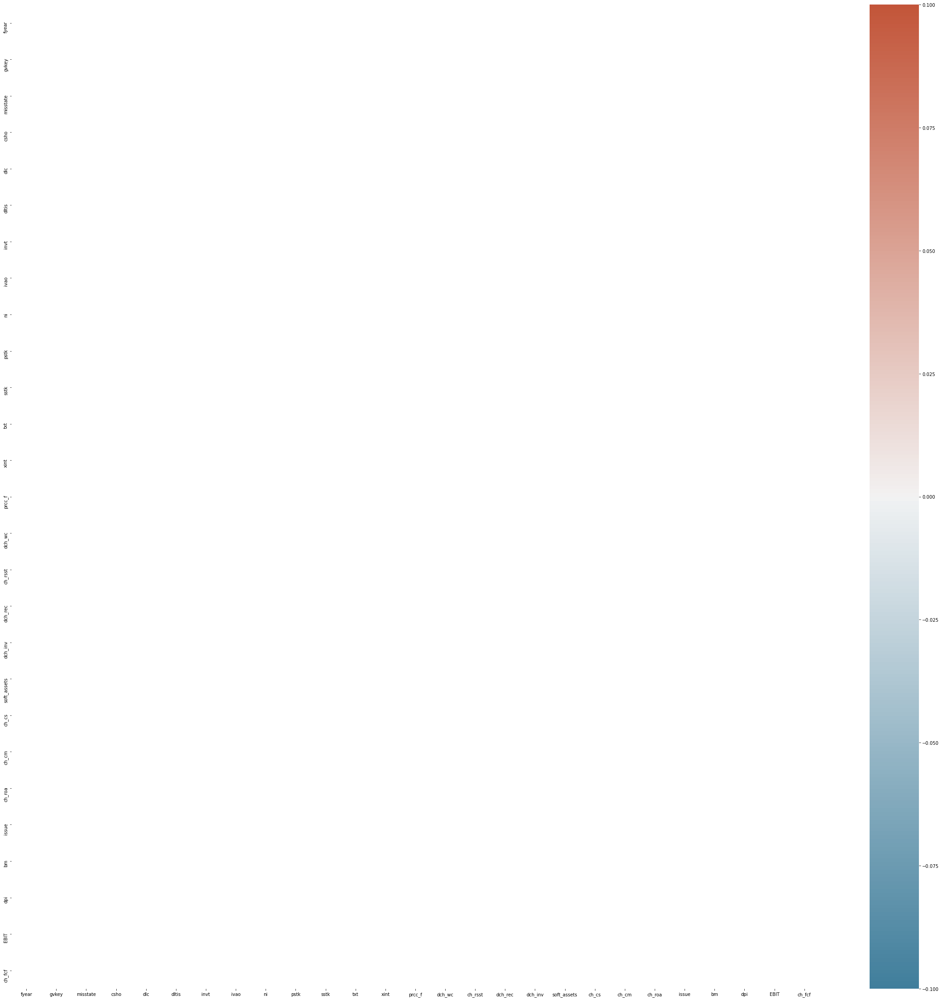

In [327]:
# calculating correlation after removing highly corelated features

dfCorr = df_c7.corr()

#filtering only features with greater than 0.7 and less than -0.7  correlation
filteredDf = dfCorr[((dfCorr >= .7) | (dfCorr <= -.7)) & (dfCorr !=1.000)]
plt.figure(figsize=(40,40))
cmap=sns.diverging_palette(230,20, as_cmap=True)
sns.heatmap(filteredDf, annot=True, cmap=cmap)
plt.show()

In [328]:
pd.set_option("display.max_columns",27)
df_c7

,fyear,gvkey,misstate,csho,dlc,dltis,invt,ivao,ni,pstk,sstk,txt,xint,prcc_f,dch_wc,ch_rsst,dch_rec,dch_inv,soft_assets,ch_cs,ch_cm,ch_roa,issue,bm,dpi,EBIT,ch_fcf
0,1990,1009,0,2.526,3.283,32.853,2.355,0.000,2.135,0.000,0.000,0.769,2.333,6.000,0.069595,0.046043,0.041935,0.033034,0.312448,0.095082,0.082631,-0.019761,1,0.413170,0.873555,0.161961,-0.042140
1,1990,1011,0,3.556,0.021,2.017,0.663,0.132,-1.869,0.000,0.006,0.000,0.640,1.188,-0.065604,-0.240937,-0.006248,-0.026684,0.315904,0.188832,-0.211389,-0.117832,1,0.157887,0.745139,-0.157888,0.100228
2,1990,1017,0,3.882,6.446,6.500,4.292,12.989,2.574,0.000,0.000,0.986,3.962,5.125,0.092822,0.020143,0.002156,0.002746,0.605342,0.097551,-0.105780,0.091206,1,2.231337,1.015131,0.063681,0.066348
3,1990,1021,0,4.755,8.791,0.587,15.463,0.000,0.422,1.295,0.000,0.365,2.269,1.562,0.014060,0.035120,0.035583,0.008332,0.793068,-0.005725,-0.249704,0.017545,1,1.043582,1.026261,0.088347,-0.017358
4,1990,1028,0,6.735,32.206,0.000,8.971,0.000,-22.812,0.000,0.000,0.000,3.510,1.125,-0.540503,-0.575325,-0.102153,-0.222022,0.869182,-0.231536,-1.674893,-0.466667,0,-1.602508,0.598443,-0.700821,0.130349
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
126478,2014,311798,0,3896.103,0.000,194.413,0.000,0.000,-26.767,0.000,119.541,0.000,15.155,0.095,0.085366,-0.025508,0.000541,0.000000,0.015362,-1.718931,0.435251,0.009248,1,2.626149,0.820630,-0.009215,0.030761
126479,2014,314866,0,97.748,23.200,585.600,0.000,9.200,-90.400,0.000,323.800,25.700,54.600,19.150,-0.010251,0.204761,0.011437,0.000000,0.751944,0.560406,0.127217,-0.050591,1,0.103693,0.829680,-0.008179,-0.261606
126480,2014,315318,0,182.067,15.100,678.800,205.800,2.300,-29.900,0.000,1512.600,-6.700,38.700,23.220,0.063226,0.341147,0.054938,0.034174,0.742781,-0.118178,0.031360,0.095355,1,0.581796,0.743084,0.000461,-0.296702
126481,2014,316056,0,95.831,49.600,956.300,360.600,23.500,175.200,0.000,14.100,84.200,49.300,55.460,-0.011512,0.011762,-0.003103,0.023024,0.751129,0.004207,-0.037925,0.072050,1,-0.000903,1.063878,0.153133,0.065569


In [329]:
df_c7.describe()

,fyear,gvkey,misstate,csho,dlc,dltis,invt,ivao,ni,pstk,sstk,txt,xint,prcc_f,dch_wc,ch_rsst,dch_rec,dch_inv,soft_assets,ch_cs,ch_cm,ch_roa,issue,bm,dpi,EBIT,ch_fcf
count,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000
mean,2001.899291,49378.913000,0.007187,99.002474,141.739622,223.956058,189.178690,106.187218,112.572452,10.274323,28.625899,62.989723,44.813972,16.444310,-0.000743,0.016228,0.011743,0.006584,0.514201,0.199275,-0.086375,-0.008330,0.876560,0.510429,1.035481,-0.131294,-0.004296
std,6.919951,57667.893635,0.084470,452.825247,1083.462616,1733.618385,986.355567,1497.031538,1036.097651,100.409290,224.531074,495.434844,189.413374,45.077238,0.149520,0.344284,0.079331,0.055581,0.260947,1.329698,2.756747,0.322912,0.328942,1.274880,0.461018,0.769578,0.438279
min,1990.000000,1004.000000,0.000000,0.001000,-0.069000,-19.687000,0.000000,-320.866000,-98696.000000,-123.000000,-516.713000,-27650.485000,-0.875000,0.000000,-0.999628,-2.072079,-0.304659,-0.222022,0.004515,-6.484197,-17.359699,-1.671565,0.000000,-7.034304,0.151757,-7.016393,-2.980601
25%,1996.000000,9629.000000,0.000000,8.867000,0.042000,0.000000,0.113000,0.000000,-4.080000,0.000000,0.000000,0.000000,0.150000,2.020000,-0.030417,-0.056587,-0.011251,-0.002794,0.303050,-0.063804,-0.251914,-0.055007,1.000000,0.223529,0.860950,-0.083797,-0.107002
50%,2002.000000,23170.000000,0.000000,22.923000,1.880000,0.300000,6.442000,0.000000,1.479000,0.000000,0.645000,0.761000,1.490000,8.070000,0.003830,0.023912,0.005488,0.000000,0.540080,0.071128,-0.022579,-0.001825,1.000000,0.470743,0.974718,0.052168,-0.023850
75%,2008.000000,64910.000000,0.000000,62.170500,16.514000,36.230500,59.652000,1.508500,27.805500,0.000000,7.600000,13.964000,15.389000,21.950000,0.042523,0.106347,0.033664,0.015519,0.728527,0.252464,0.139169,0.039606,1.000000,0.831552,1.092663,0.111247,0.057534
max,2014.000000,317264.000000,1.000000,91125.785000,75553.000000,188791.978000,46756.000000,161907.634000,98806.045000,7815.000000,30563.000000,36530.000000,8479.000000,5010.000000,0.609004,1.504204,0.382809,0.268206,0.993599,9.600000,16.573810,1.621628,1.000000,4.937457,4.036458,0.550619,4.061810


In [330]:
df_c7["misstate"].value_counts()

0    125574
1       909
Name: misstate, dtype: int64

# Feature Importance using Random Forest

In [331]:
X=df_c7.drop(columns="misstate")
y=df_c7["misstate"]

In [332]:
model = RandomForestClassifier()
model.fit(X,y)

RandomForestClassifier()

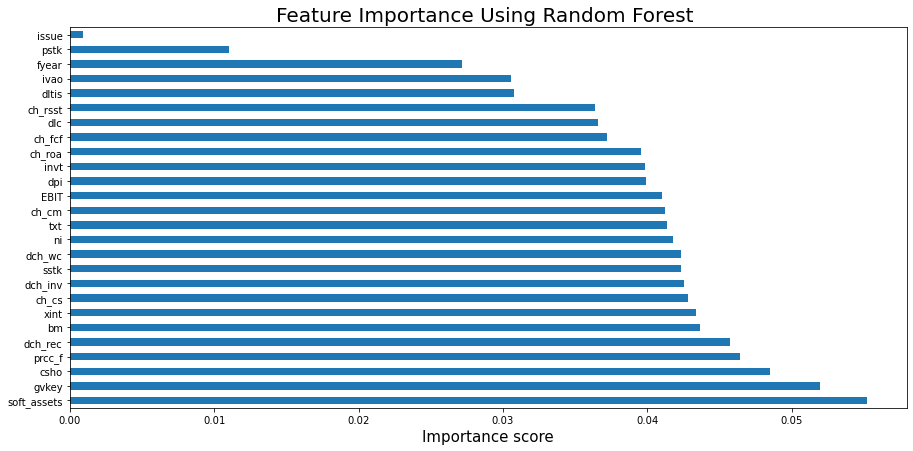

In [333]:
#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(27).plot(kind='barh', figsize=(15,7))

plt.xlabel("Importance score", fontsize=15)
plt.title("Feature Importance Using Random Forest ", fontsize=20)
plt.show()

In [334]:
pd.DataFrame(feat_importances, columns=["Importance score"]).sort_values(by="Importance score")[0:14]

,Importance score
issue,0.000941
pstk,0.011037
fyear,0.027185
ivao,0.030542
dltis,0.030792
ch_rsst,0.036355
dlc,0.036598
ch_fcf,0.037215
ch_roa,0.039562
invt,0.039854


In [335]:
pd.DataFrame(feat_importances, columns=["Importance score"]).sort_values(by="Importance score")[14:28]

,Importance score
ni,0.041796
dch_wc,0.042313
sstk,0.042328
dch_inv,0.042538
ch_cs,0.042796
xint,0.043335
bm,0.043609
dch_rec,0.045700
prcc_f,0.046383
csho,0.048472


In [336]:
# dropping less important features

df_c7=pd.concat([X,y], axis=1)
df_c7.drop(columns=["issue","pstk"], inplace=True)

In [337]:
#Summary
df_c7.iloc[:,0:10].describe()

,fyear,gvkey,csho,dlc,dltis,invt,ivao,ni,sstk,txt
count,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000
mean,2001.899291,49378.913000,99.002474,141.739622,223.956058,189.178690,106.187218,112.572452,28.625899,62.989723
std,6.919951,57667.893635,452.825247,1083.462616,1733.618385,986.355567,1497.031538,1036.097651,224.531074,495.434844
min,1990.000000,1004.000000,0.001000,-0.069000,-19.687000,0.000000,-320.866000,-98696.000000,-516.713000,-27650.485000
25%,1996.000000,9629.000000,8.867000,0.042000,0.000000,0.113000,0.000000,-4.080000,0.000000,0.000000
50%,2002.000000,23170.000000,22.923000,1.880000,0.300000,6.442000,0.000000,1.479000,0.645000,0.761000
75%,2008.000000,64910.000000,62.170500,16.514000,36.230500,59.652000,1.508500,27.805500,7.600000,13.964000
max,2014.000000,317264.000000,91125.785000,75553.000000,188791.978000,46756.000000,161907.634000,98806.045000,30563.000000,36530.000000


In [338]:
df_c7.iloc[:,10:20].describe()

,xint,prcc_f,dch_wc,ch_rsst,dch_rec,dch_inv,soft_assets,ch_cs,ch_cm,ch_roa
count,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000
mean,44.813972,16.444310,-0.000743,0.016228,0.011743,0.006584,0.514201,0.199275,-0.086375,-0.008330
std,189.413374,45.077238,0.149520,0.344284,0.079331,0.055581,0.260947,1.329698,2.756747,0.322912
min,-0.875000,0.000000,-0.999628,-2.072079,-0.304659,-0.222022,0.004515,-6.484197,-17.359699,-1.671565
25%,0.150000,2.020000,-0.030417,-0.056587,-0.011251,-0.002794,0.303050,-0.063804,-0.251914,-0.055007
50%,1.490000,8.070000,0.003830,0.023912,0.005488,0.000000,0.540080,0.071128,-0.022579,-0.001825
75%,15.389000,21.950000,0.042523,0.106347,0.033664,0.015519,0.728527,0.252464,0.139169,0.039606
max,8479.000000,5010.000000,0.609004,1.504204,0.382809,0.268206,0.993599,9.600000,16.573810,1.621628


In [339]:
df_c7.iloc[:,20:28].describe()

,bm,dpi,EBIT,ch_fcf,misstate
count,126483.000000,126483.000000,126483.000000,126483.000000,126483.000000
mean,0.510429,1.035481,-0.131294,-0.004296,0.007187
std,1.274880,0.461018,0.769578,0.438279,0.084470
min,-7.034304,0.151757,-7.016393,-2.980601,0.000000
25%,0.223529,0.860950,-0.083797,-0.107002,0.000000
50%,0.470743,0.974718,0.052168,-0.023850,0.000000
75%,0.831552,1.092663,0.111247,0.057534,0.000000
max,4.937457,4.036458,0.550619,4.061810,1.000000


In [340]:
df_c7[df_c7["misstate"]==1].describe()

,fyear,gvkey,csho,dlc,dltis,invt,ivao,ni,sstk,txt,xint,prcc_f,dch_wc,ch_rsst,dch_rec,dch_inv,soft_assets,ch_cs,ch_cm,ch_roa,bm,dpi,EBIT,ch_fcf,misstate
count,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.000000,909.0
mean,2001.392739,48013.473047,197.744334,261.165226,474.363147,423.454737,239.913447,20.746241,105.550121,102.130484,104.769812,26.493455,0.020070,0.080775,0.035107,0.019123,0.633547,0.360334,-0.088761,-0.013115,0.523226,1.041915,-0.009321,-0.087812,1.0
std,5.353659,57430.316034,598.580375,906.344869,2018.267448,1270.616444,1086.523253,3642.305986,1047.526513,476.043639,474.066933,34.010696,0.135664,0.270558,0.092940,0.062692,0.217801,1.141815,2.367507,0.212891,0.622083,0.445447,0.438144,0.284173,0.0
min,1990.000000,1009.000000,1.173000,0.000000,0.000000,0.000000,0.000000,-98696.000000,0.000000,-3164.000000,0.000000,0.031000,-0.999628,-2.072079,-0.304659,-0.222022,0.004515,-6.484197,-17.359699,-1.671565,-7.034304,0.151757,-7.016393,-2.495896,1.0
25%,1998.000000,9494.000000,15.167000,0.271000,0.000000,1.050000,0.000000,-4.590000,0.616000,0.020000,0.553000,7.010000,-0.023581,-0.021698,-0.004430,-0.000488,0.490343,0.007801,-0.218629,-0.050572,0.212785,0.866755,-0.004329,-0.151102,1.0
50%,2001.000000,25216.000000,34.972000,5.000000,11.473000,27.921000,0.000000,8.314000,5.721000,5.524000,5.902000,17.900000,0.010042,0.047834,0.017000,0.001661,0.681376,0.143928,-0.026883,-0.004866,0.384393,0.979310,0.064652,-0.046469,1.0
75%,2005.000000,64130.000000,113.051000,51.275000,201.152000,194.571000,14.650000,69.020000,37.730000,38.243000,42.237000,35.690000,0.053584,0.149813,0.059478,0.025752,0.800280,0.424235,0.130933,0.028198,0.687954,1.101919,0.115711,0.012682,1.0
max,2014.000000,284041.000000,6522.248000,9232.000000,28445.000000,15165.000000,13259.000000,20121.000000,30563.000000,6732.000000,8479.000000,440.000000,0.609004,1.380555,0.382809,0.268206,0.993599,9.600000,16.573810,1.621628,4.670805,4.036458,0.550619,1.314497,1.0


In [341]:
df_c7[df_c7["misstate"]==0].describe()

,fyear,gvkey,csho,dlc,dltis,invt,ivao,ni,sstk,txt,xint,prcc_f,dch_wc,ch_rsst,dch_rec,dch_inv,soft_assets,ch_cs,ch_cm,ch_roa,bm,dpi,EBIT,ch_fcf,misstate
count,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.000000,125574.0
mean,2001.902958,49388.797092,98.287706,140.875129,222.143421,187.482822,105.219206,113.237160,28.069063,62.706392,44.379966,16.371567,-0.000894,0.015761,0.011574,0.006493,0.513337,0.198109,-0.086358,-0.008295,0.510337,1.035434,-0.132177,-0.003691,0.0
std,6.929880,57669.719712,451.523129,1084.594380,1731.264599,983.801698,1499.553173,992.612902,206.885226,495.562998,185.703711,45.139405,0.149605,0.344717,0.079199,0.055517,0.261035,1.330894,2.759372,0.323572,1.278392,0.461130,0.771389,0.439140,0.0
min,1990.000000,1004.000000,0.001000,-0.069000,-19.687000,0.000000,-320.866000,-38468.000000,-516.713000,-27650.485000,-0.875000,0.000000,-0.999628,-2.072079,-0.304659,-0.222022,0.004515,-6.484197,-17.359699,-1.671565,-7.034304,0.151757,-7.016393,-2.980601,0.0
25%,1996.000000,9643.000000,8.840000,0.042000,0.000000,0.111000,0.000000,-4.076750,0.000000,0.000000,0.149000,2.000000,-0.030488,-0.056867,-0.011311,-0.002819,0.301708,-0.064444,-0.252223,-0.055032,0.223704,0.860893,-0.084499,-0.106701,0.0
50%,2002.000000,23137.000000,22.839500,1.867000,0.293000,6.387500,0.000000,1.452000,0.631000,0.746000,1.477000,8.000000,0.003795,0.023740,0.005426,0.000000,0.538897,0.070736,-0.022554,-0.001805,0.471430,0.974679,0.052066,-0.023679,0.0
75%,2008.000000,64915.000000,61.966500,16.370000,35.462750,59.151250,1.500000,27.558500,7.498000,13.799500,15.260750,21.810000,0.042413,0.106015,0.033480,0.015443,0.727463,0.251386,0.139228,0.039687,0.832280,1.092600,0.111225,0.058009,0.0
max,2014.000000,317264.000000,91125.785000,75553.000000,188791.978000,46756.000000,161907.634000,98806.045000,27619.000000,36530.000000,6734.000000,5010.000000,0.609004,1.504204,0.382809,0.268206,0.993599,9.600000,16.573810,1.621628,4.937457,4.036458,0.550619,4.061810,0.0


<ipython-input-342-10e90ec58360>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs=plt.subplots(1,2, figsize=(15,5))


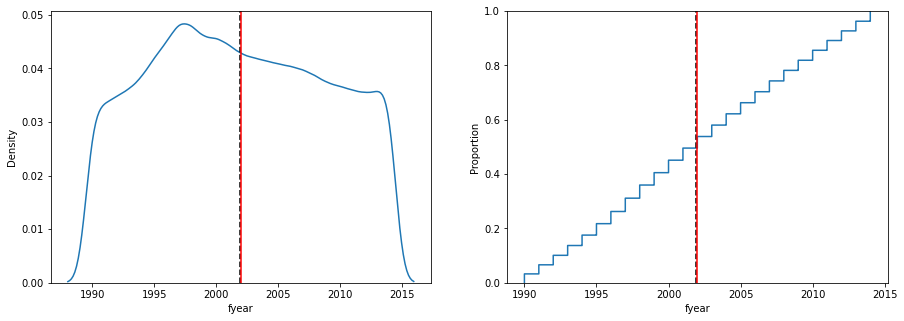

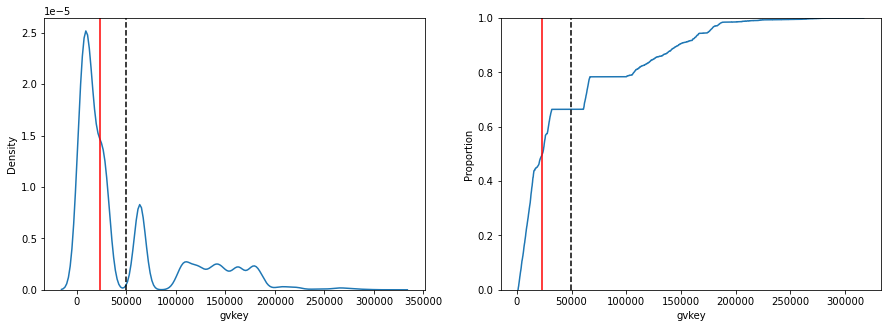

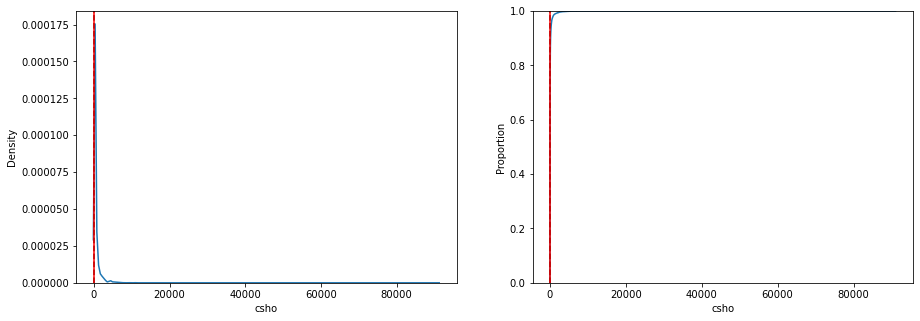

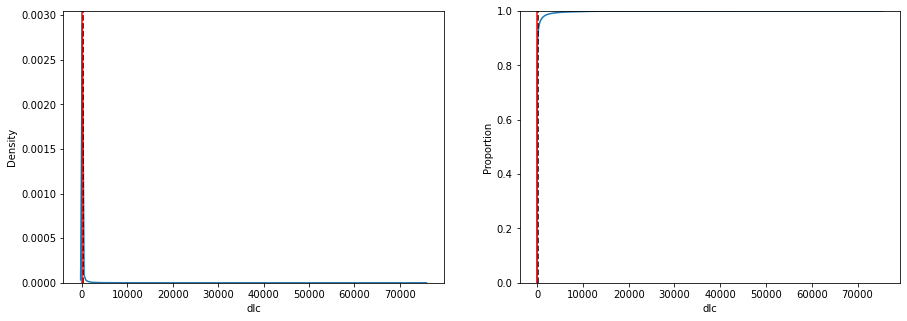

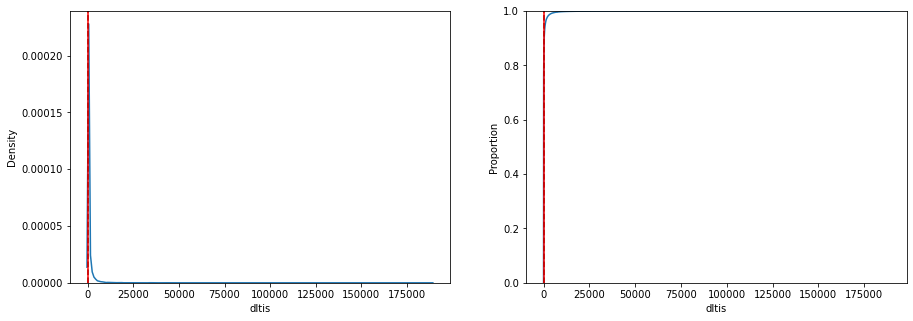

...

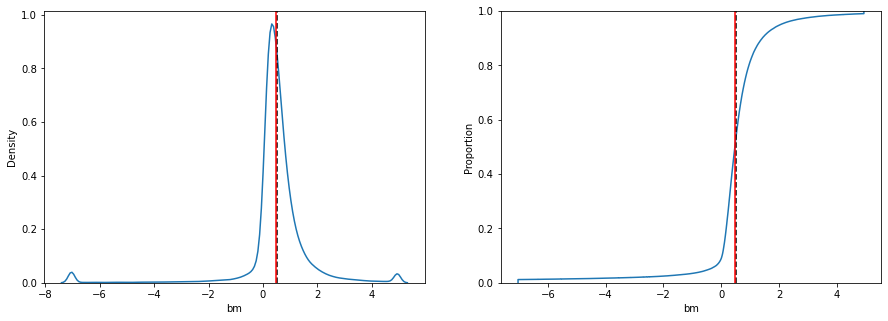

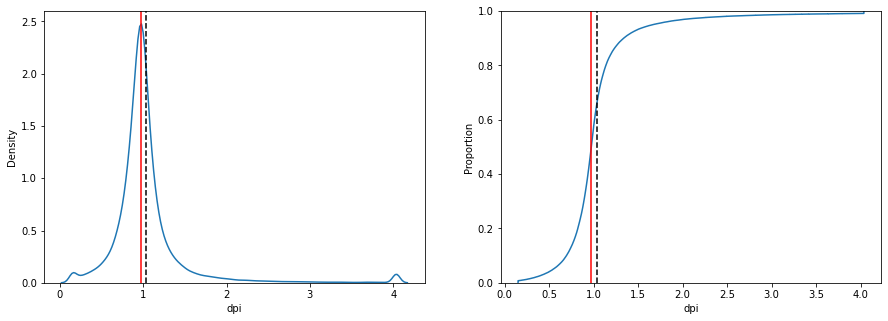

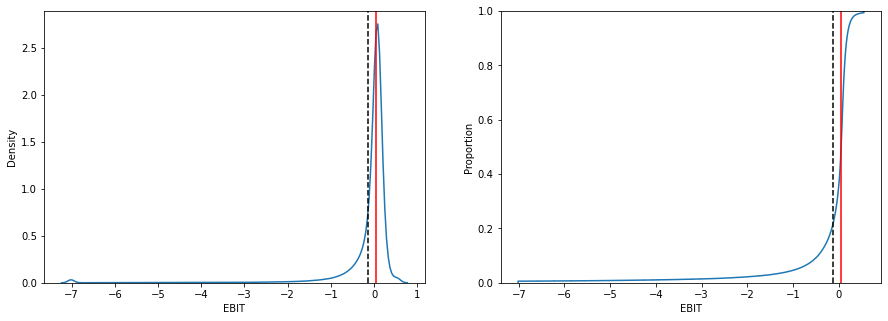

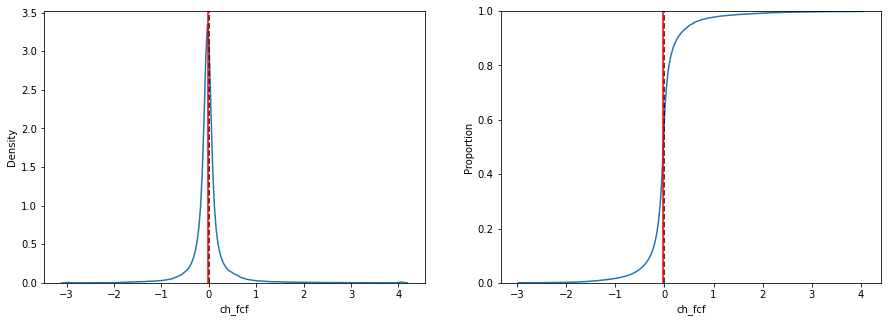

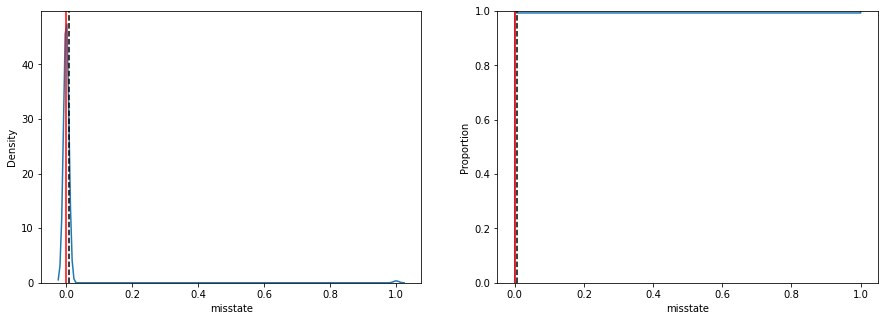

In [342]:
#distribution 
for i in df_c7.columns:

    fig, axs=plt.subplots(1,2, figsize=(15,5))
    x=sns.kdeplot(x=df_c7[i], ax=axs[0])
    x.axvline(df_c7[i].mean(),color="black", linestyle="--", label="Mean")
    x.axvline(df_c7[i].median(),color="red", linestyle="-", label="Median")
    
    
    y=sns.ecdfplot(x=df_c7[i], ax=axs[1])
    y.axvline(df_c7[i].mean(), color="black", linestyle="--",label="Mean")
    y.axvline(df_c7[i].median(),color="red", linestyle="-",label="Median")
    
    

In [343]:
#calculating skewness and kurtosis
skew=pd.DataFrame({"Skewness":df_c7.skew(), "Kurtosis":df_c7.kurt()})

In [344]:
skew.iloc[0:7]

,Skewness,Kurtosis
fyear,0.061723,-1.105886
gvkey,1.425672,1.079278
csho,72.178006,13063.481627
dlc,27.875903,1273.327986
dltis,49.579807,4066.218212
invt,17.318207,478.252118
ivao,55.545805,4210.296975


In [345]:
skew.iloc[7:15]

,Skewness,Kurtosis
ni,10.477583,1682.092018
sstk,57.732471,5806.675786
txt,25.209344,1252.060812
xint,12.328001,249.587939
prcc_f,49.776815,3799.520747
dch_wc,-1.943433,16.076969
ch_rsst,-1.084373,12.174239
dch_rec,0.367338,6.473973


In [346]:
skew.iloc[15:27]

,Skewness,Kurtosis
dch_inv,0.468172,7.675678
soft_assets,-0.196709,-1.027523
ch_cs,3.030532,28.497783
ch_cm,-0.340889,25.666705
ch_roa,-0.063351,12.865545
bm,-2.389225,17.008918
dpi,3.606568,19.236113
EBIT,-6.352979,47.806546
ch_fcf,2.195953,23.328731
misstate,11.668577,134.157804


# DETECTING OUTLIER USING PERCENTILE

In [356]:
df_n2=pd.DataFrame()
for i in df_c7.columns:
    ul=df_c7[i].quantile(0.99)
    ll=df_c7[i].quantile(0.01)
    
    df_n2[i]=df_c7[i][(df_c7[i]>=ll) & (df_c7[i]<=ul)]
    

In [357]:
df_n2

,fyear,gvkey,csho,dlc,dltis,invt,ivao,ni,sstk,txt,xint,prcc_f,dch_wc,ch_rsst,dch_rec,dch_inv,soft_assets,ch_cs,ch_cm,ch_roa,bm,dpi,EBIT,ch_fcf,misstate
0,1990,NaN,2.526,3.283,32.853,2.355,0.000,2.135,0.000,0.769,2.333,6.000,0.069595,0.046043,0.041935,0.033034,0.312448,0.095082,0.082631,-0.019761,0.413170,0.873555,0.161961,-0.042140,0.0
1,1990,NaN,3.556,0.021,2.017,0.663,0.132,-1.869,0.006,0.000,0.640,1.188,-0.065604,-0.240937,-0.006248,-0.026684,0.315904,0.188832,-0.211389,-0.117832,0.157887,0.745139,-0.157888,0.100228,0.0
2,1990,NaN,3.882,6.446,6.500,4.292,12.989,2.574,0.000,0.986,3.962,5.125,0.092822,0.020143,0.002156,0.002746,0.605342,0.097551,-0.105780,0.091206,2.231337,1.015131,0.063681,0.066348,0.0
3,1990,NaN,4.755,8.791,0.587,15.463,0.000,0.422,0.000,0.365,2.269,1.562,0.014060,0.035120,0.035583,0.008332,0.793068,-0.005725,-0.249704,0.017545,1.043582,1.026261,0.088347,-0.017358,0.0
4,1990,NaN,6.735,32.206,0.000,8.971,0.000,-22.812,0.000,0.000,3.510,1.125,-0.540503,-0.575325,-0.102153,NaN,0.869182,-0.231536,-1.674893,-0.466667,-1.602508,0.598443,-0.700821,0.130349,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
126478,2014,NaN,NaN,0.000,194.413,0.000,0.000,-26.767,119.541,0.000,15.155,0.095,0.085366,-0.025508,0.000541,0.000000,0.015362,-1.718931,0.435251,0.009248,2.626149,0.820630,-0.009215,0.030761,0.0
126479,2014,NaN,97.748,23.200,585.600,0.000,9.200,-90.400,323.800,25.700,54.600,19.150,-0.010251,0.204761,0.011437,0.000000,0.751944,0.560406,0.127217,-0.050591,0.103693,0.829680,-0.008179,-0.261606,0.0
126480,2014,NaN,182.067,15.100,678.800,205.800,2.300,-29.900,NaN,-6.700,38.700,23.220,0.063226,0.341147,0.054938,0.034174,0.742781,-0.118178,0.031360,0.095355,0.581796,0.743084,0.000461,-0.296702,0.0
126481,2014,NaN,95.831,49.600,956.300,360.600,23.500,175.200,14.100,84.200,49.300,55.460,-0.011512,0.011762,-0.003103,0.023024,0.751129,0.004207,-0.037925,0.072050,-0.000903,1.063878,0.153133,0.065569,0.0


In [358]:
df_n2["misstate"].fillna(1,inplace=True)

In [359]:
df_n2.describe()

,fyear,gvkey,csho,dlc,dltis,invt,ivao,ni,sstk,txt,xint,prcc_f,dch_wc,ch_rsst,dch_rec,dch_inv,soft_assets,ch_cs,ch_cm,ch_roa,bm,dpi,EBIT,ch_fcf,misstate
count,126483.000000,123963.000000,123955.000000,125216.000000,125205.000000,125220.000000,125209.000000,123954.000000,125027.000000,123953.000000,125202.000000,123953.000000,123953.000000,123953.000000,123953.000000,123953.000000,123953.000000,123953.000000,123953.000000,123953.000000,125218.000000,123953.000000,123953.000000,123953.000000,126483.000000
mean,2001.899291,47827.410260,69.662717,66.879581,124.779434,115.235818,32.149230,64.993629,16.041537,34.147787,30.467450,14.647758,0.002546,0.020818,0.011364,0.006321,0.514637,0.165404,-0.079280,-0.008118,0.465719,1.014007,-0.074460,-0.013436,0.007187
std,6.919951,54313.225247,144.629527,250.212323,401.789379,345.417764,156.246055,263.313764,47.822575,115.651683,87.850451,17.015318,0.104660,0.252175,0.064385,0.044357,0.254303,0.741250,1.467766,0.230127,1.200776,0.343211,0.438626,0.293985,0.084470
min,1990.000000,1372.000000,1.095000,0.000000,0.000000,0.000000,0.000000,-477.300000,0.000000,-63.072000,0.000000,0.021100,-0.621908,-1.336340,-0.279886,-0.205476,0.014314,-3.192506,-13.432921,-1.361598,-7.034304,0.200791,-4.280781,-1.272723,0.000000
25%,1996.000000,9818.000000,9.036000,0.038000,0.000000,0.099000,0.000000,-3.854000,0.000000,0.000000,0.146000,2.125000,-0.029254,-0.053897,-0.010656,-0.002482,0.308684,-0.060077,-0.243050,-0.052968,0.220932,0.864323,-0.078373,-0.104164,0.000000
50%,2002.000000,23170.000000,22.923000,1.800000,0.250000,6.168000,0.000000,1.479500,0.614000,0.761000,1.426000,8.070000,0.003830,0.023912,0.005488,0.000000,0.540080,0.071128,-0.022579,-0.001825,0.465334,0.974718,0.052168,-0.023850,0.000000
75%,2008.000000,64654.500000,60.660500,15.228000,32.097000,55.567500,1.258000,26.450250,7.077000,13.211000,14.212750,21.500000,0.041306,0.103689,0.032746,0.014814,0.724701,0.246560,0.133341,0.037922,0.815401,1.088528,0.109845,0.054399,0.000000
max,2014.000000,213288.000000,1471.000000,2802.000000,3966.000000,3434.000000,2052.595000,2788.000000,475.200000,1227.000000,786.000000,94.530000,0.455967,1.192191,0.303060,0.225167,0.963610,7.883112,12.133705,1.380930,4.849498,3.714286,0.433879,1.750000,1.000000


In [360]:
print("COLUMNS WITH MISSING VALUES AND PERCENT OF MISSNG VALUES AFTER REMOVING OUTLIERS \n")
y=[]
for i in df_n2.columns:
    x=np.where(df_n2[i].isnull(),1,0)
    if(x.mean()!=0):
        print('Percent of misisng value in '+i+' is ',x.mean()*100)
        y.append(x.mean()*100)
        

COLUMNS WITH MISSING VALUES AND PERCENT OF MISSNG VALUES AFTER REMOVING OUTLIERS 

Percent of misisng value in gvkey is  1.9923626099950191
Percent of misisng value in csho is  1.99868757066167
Percent of misisng value in dlc is  1.001715645580829
Percent of misisng value in dltis is  1.0104124664974738
Percent of misisng value in invt is  0.9985531652475036
Percent of misisng value in ivao is  1.0072499861641486
Percent of misisng value in ni is  1.9994781907450014
Percent of misisng value in sstk is  1.1511428413304554
Percent of misisng value in txt is  2.0002688108283326
Percent of misisng value in xint is  1.012784326747468
Percent of misisng value in prcc_f is  2.0002688108283326
Percent of misisng value in dch_wc is  2.0002688108283326
Percent of misisng value in ch_rsst is  2.0002688108283326
Percent of misisng value in dch_rec is  2.0002688108283326
Percent of misisng value in dch_inv is  2.0002688108283326
Percent of misisng value in soft_assets is  2.0002688108283326
Percent

In [366]:
len(y)

23

In [368]:
miss_per=pd.DataFrame({"Columns":df_n2.columns[1:24], "Missing Percent(%)":y})
miss_per.iloc[0:7]

,Columns,Missing Percent(%)
0,gvkey,1.992363
1,csho,1.998688
2,dlc,1.001716
3,dltis,1.010412
4,invt,0.998553
5,ivao,1.007250
6,ni,1.999478


In [369]:
miss_per.iloc[7:14]

,Columns,Missing Percent(%)
7,sstk,1.151143
8,txt,2.000269
9,xint,1.012784
10,prcc_f,2.000269
11,dch_wc,2.000269
12,ch_rsst,2.000269
13,dch_rec,2.000269


In [370]:
miss_per.iloc[14:26]

,Columns,Missing Percent(%)
14,dch_inv,2.000269
15,soft_assets,2.000269
16,ch_cs,2.000269
17,ch_cm,2.000269
18,ch_roa,2.000269
19,bm,1.000134
20,dpi,2.000269
21,EBIT,2.000269
22,ch_fcf,2.000269


In [79]:
# capping the outliers percetile method (Winsorization)

df_n3=pd.DataFrame()
for i in df_c7.columns:
    if(i!="misstate"):
        ul=df_c7[i].quantile(0.99)
        ll=df_c7[i].quantile(0.01)
        df_n3[i]=np.where(df_c7[i]>ul, ul, np.where(df_c7[i]<ll,ll,df_c7[i]))
    

No handles with labels found to put in legend.


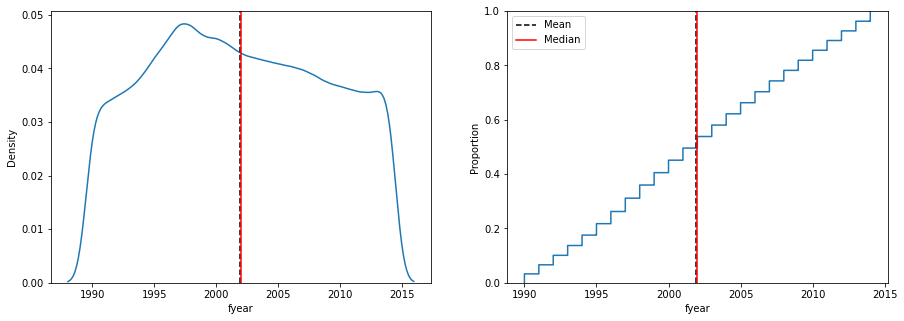

No handles with labels found to put in legend.


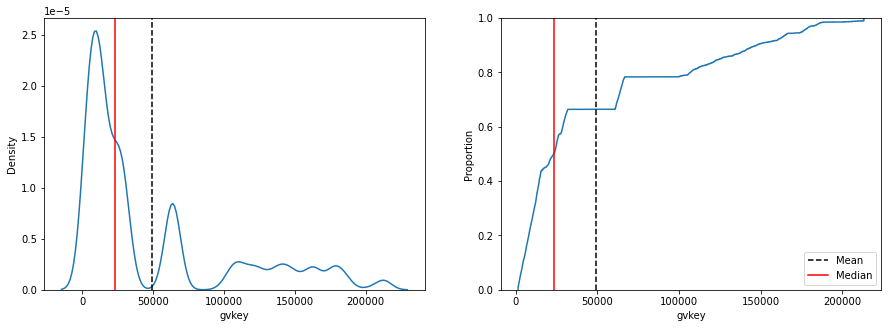

No handles with labels found to put in legend.


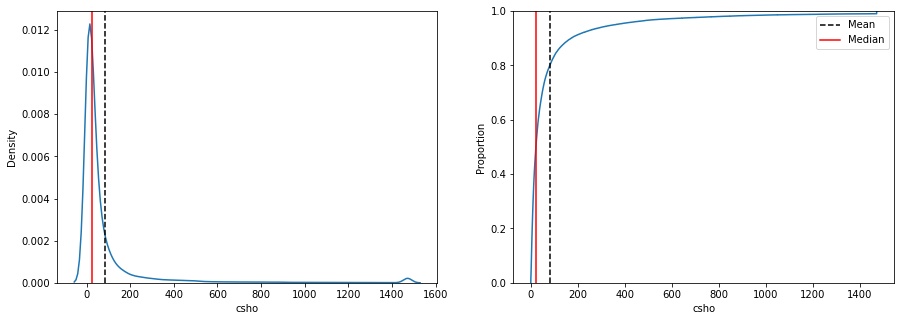

No handles with labels found to put in legend.


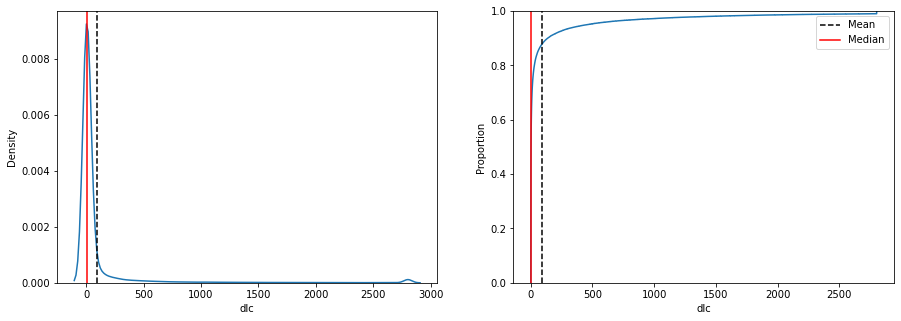

No handles with labels found to put in legend.


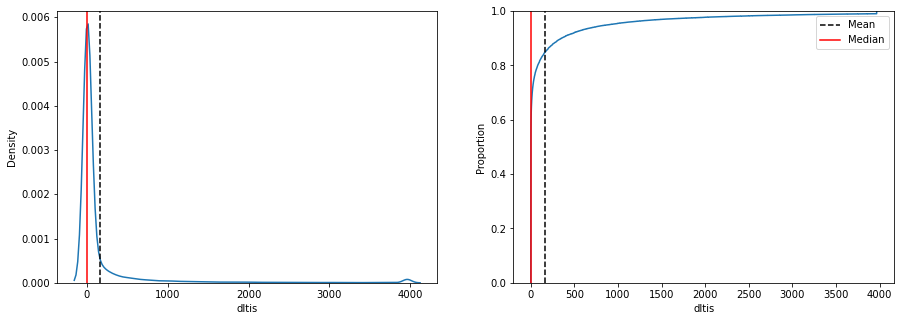

No handles with labels found to put in legend.


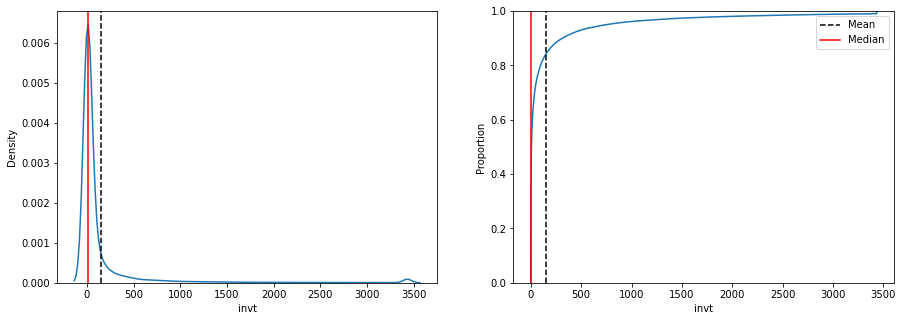

No handles with labels found to put in legend.


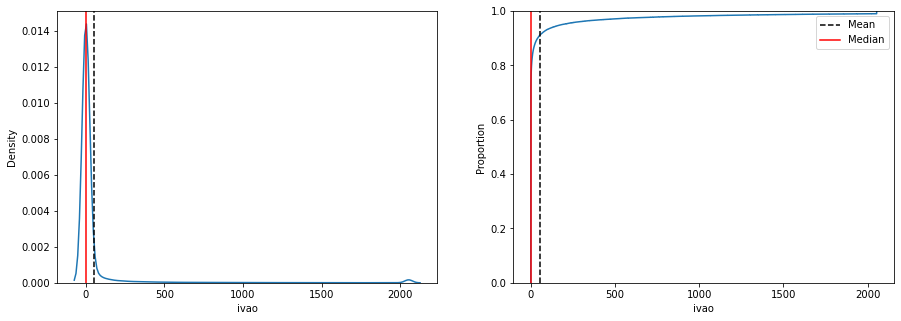

No handles with labels found to put in legend.


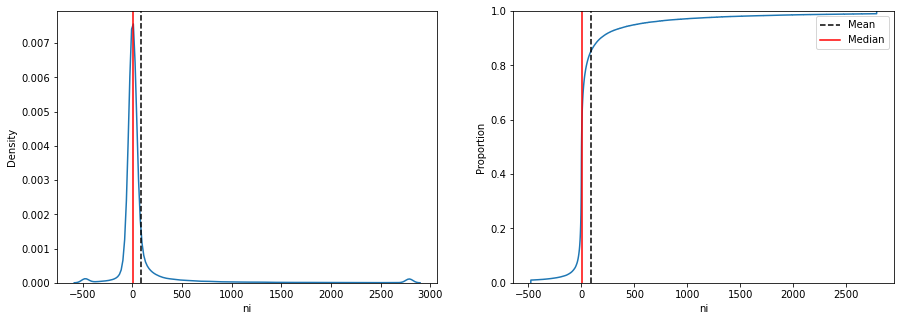

No handles with labels found to put in legend.


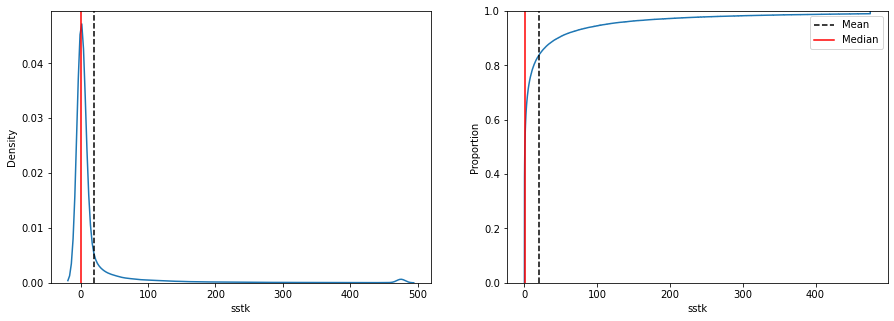

No handles with labels found to put in legend.


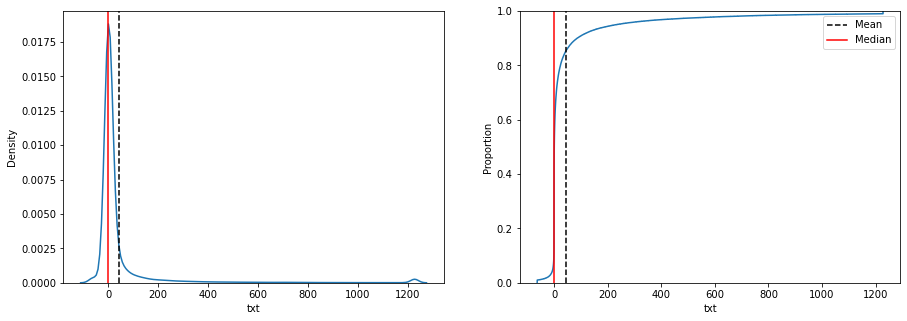

No handles with labels found to put in legend.


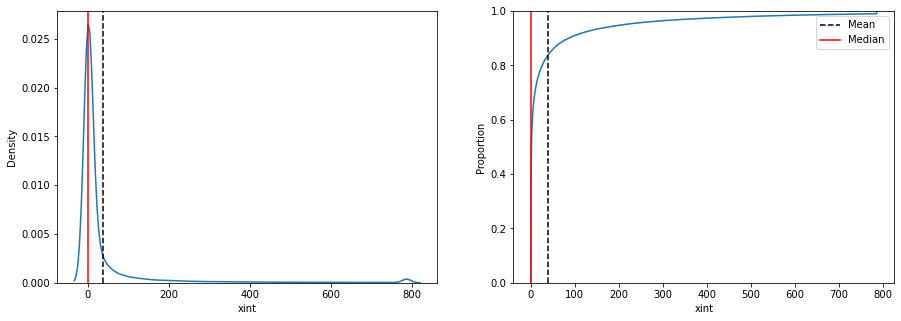

No handles with labels found to put in legend.


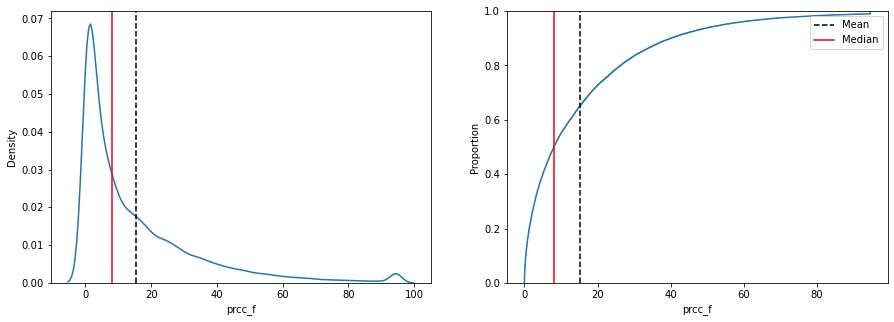

No handles with labels found to put in legend.


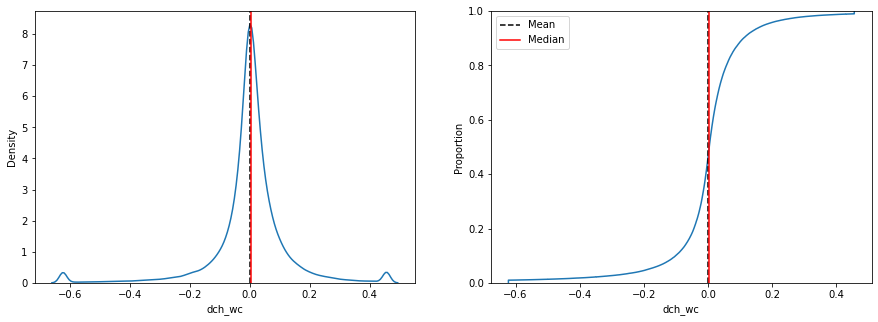

No handles with labels found to put in legend.


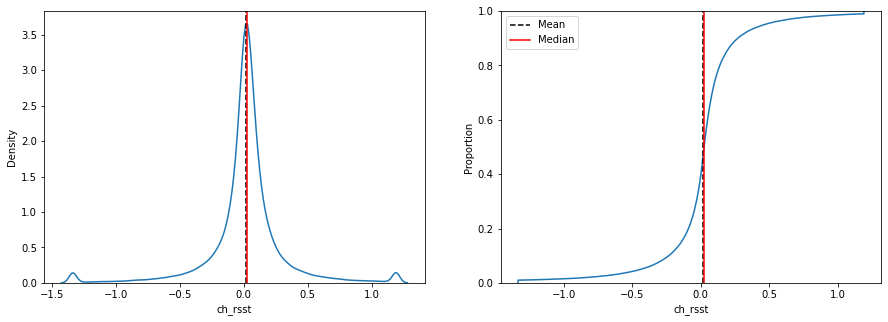

No handles with labels found to put in legend.


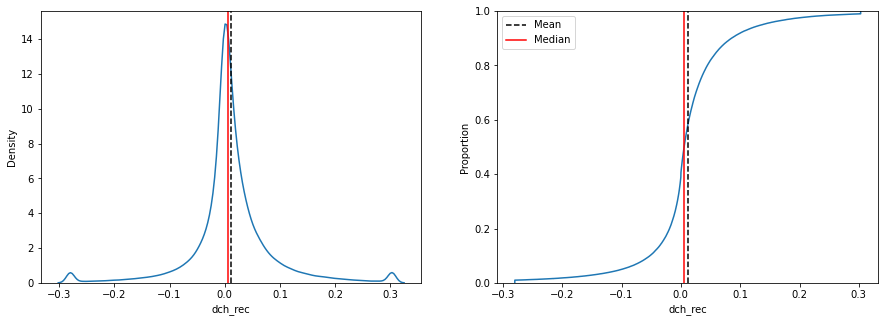

No handles with labels found to put in legend.


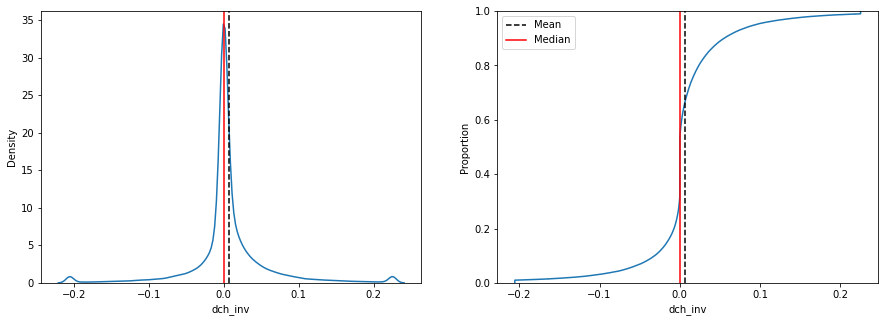

No handles with labels found to put in legend.


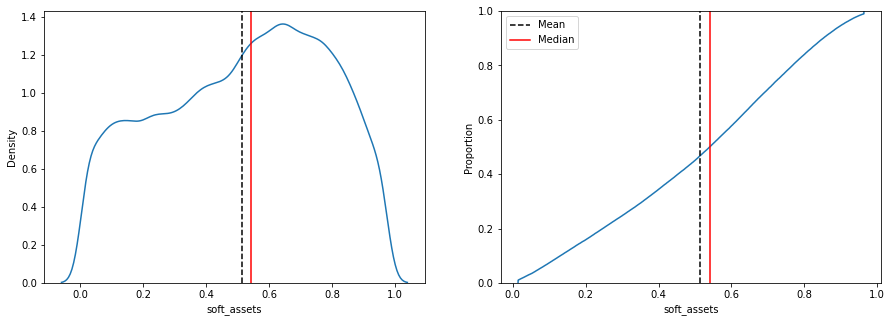

No handles with labels found to put in legend.


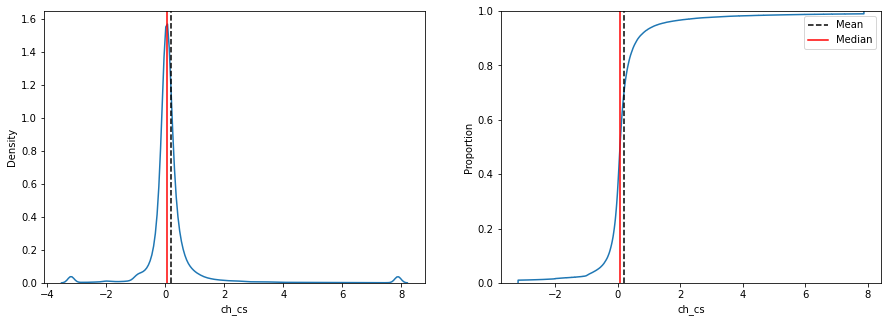

No handles with labels found to put in legend.


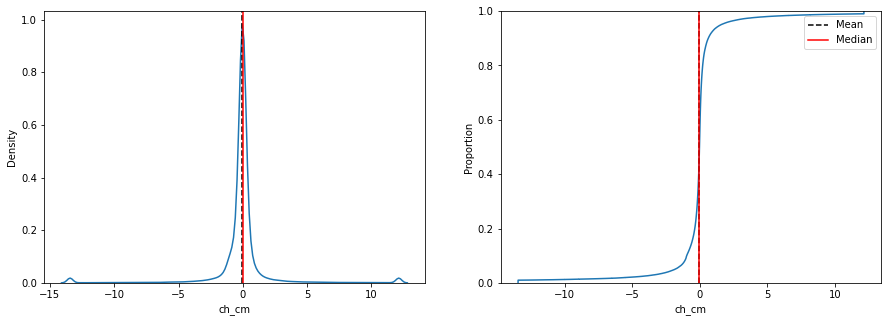

No handles with labels found to put in legend.


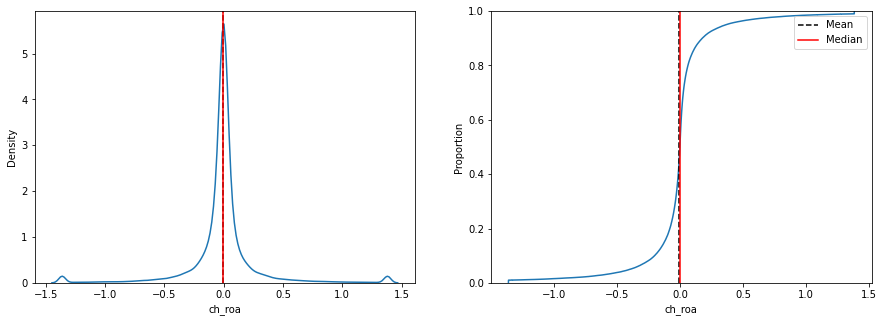

No handles with labels found to put in legend.


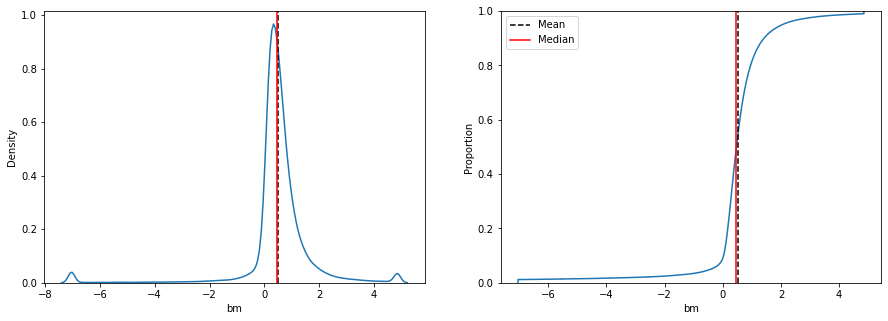

No handles with labels found to put in legend.


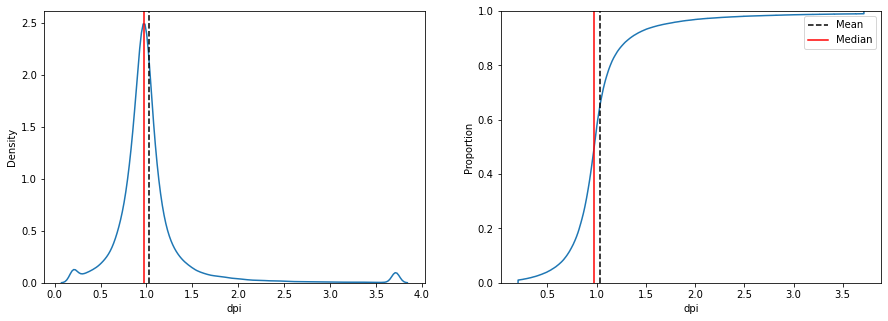

No handles with labels found to put in legend.


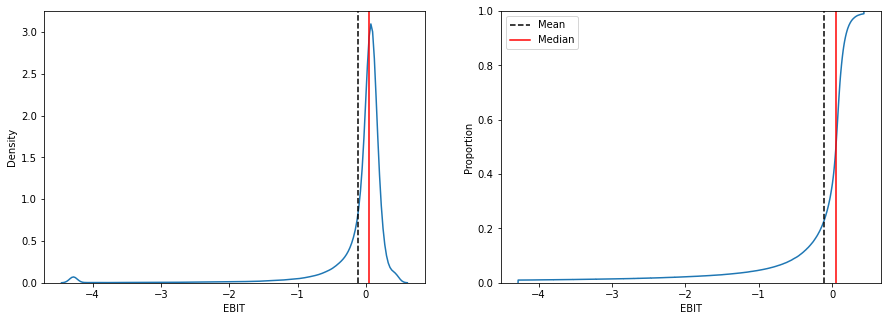

No handles with labels found to put in legend.


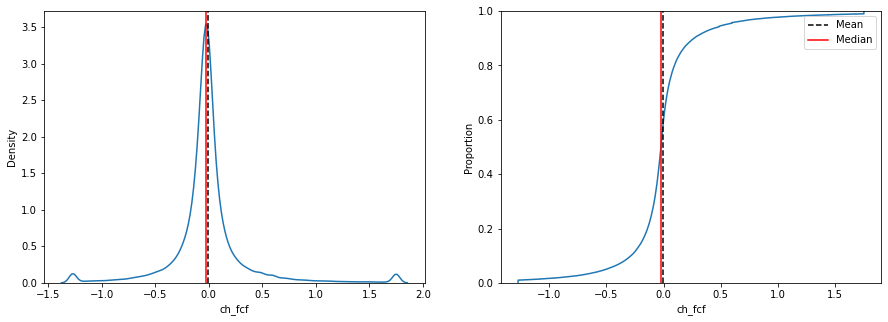

In [80]:
#distribution 

    
for i in df_n3.columns:
    fig, axs=plt.subplots(1,2, figsize=(15,5))
    x=sns.kdeplot(x=df_n3[i], ax=axs[0])
    x.axvline(df_n3[i].mean(), linestyle="--", label="Mean",color="black")
    x.axvline(df_n3[i].median(), linestyle='-', label="Median",color="red")
    plt.legend()
    
    y=sns.ecdfplot(x=df_n3[i], ax=axs[1])
    y.axvline(df_n3[i].mean(), linestyle="--", label="Mean",color="black")
    y.axvline(df_n3[i].median(), linestyle='-', label="Median",color="red")
    plt.legend()
    
    plt.show()
    
    

In [81]:
df_n3.columns

Index(['fyear', 'gvkey', 'csho', 'dlc', 'dltis', 'invt', 'ivao', 'ni', 'sstk',
       'txt', 'xint', 'prcc_f', 'dch_wc', 'ch_rsst', 'dch_rec', 'dch_inv',
       'soft_assets', 'ch_cs', 'ch_cm', 'ch_roa', 'bm', 'dpi', 'EBIT',
       'ch_fcf'],
      dtype='object')

In [82]:
# calculating kurtosis and skewness after winsorization
skew1=pd.DataFrame({"Skewness":df_n3.skew(), "Kurtosis":df_n3.kurt()})

In [83]:
skew1.iloc[0:7]

,Skewness,Kurtosis
fyear,0.061723,-1.105886
gvkey,1.313781,0.435860
csho,4.988245,27.929682
dlc,5.763867,35.480051
dltis,5.117390,28.425511
invt,5.157566,28.887048
ivao,6.545110,44.839452


In [84]:
skew1.iloc[7:15]

,Skewness,Kurtosis
ni,5.261518,31.220592
sstk,5.096531,28.413834
txt,5.450357,32.234110
xint,4.707903,23.973627
prcc_f,1.949622,4.139932
dch_wc,-1.051979,7.786885
ch_rsst,-0.455025,6.702015
dch_rec,0.133533,4.960391


In [85]:
skew1.iloc[15:24]

,Skewness,Kurtosis
dch_inv,0.295250,6.360217
soft_assets,-0.198983,-1.035617
ch_cs,3.986087,25.988250
ch_cm,-0.563951,20.008032
ch_roa,0.056964,10.131900
bm,-2.428026,17.078625
dpi,3.293534,16.255580
EBIT,-4.801921,26.838825
ch_fcf,1.145817,8.272199


In [86]:
print("COLUMNS WITH MISSING VALUES AND PERCENT OF MISSNG VALUES AFTER REMOVING OUTLIERS \n")

for i in df_n3.columns:
    x=np.where(df_n3[i].isnull(),1,0)
    if(x.mean()!=0):
        print('Percent of misisng value in '+i+' is ',x.mean()*100)

COLUMNS WITH MISSING VALUES AND PERCENT OF MISSNG VALUES AFTER REMOVING OUTLIERS 



In [87]:
df_n3=pd.merge(df_n3,df_n2["misstate"],left_on=df_n3.index, right_on=df_n2.index)


In [88]:
df_n3.drop(columns="key_0", inplace=True)
df_n3

,fyear,gvkey,csho,dlc,dltis,invt,ivao,ni,sstk,txt,xint,prcc_f,dch_wc,ch_rsst,dch_rec,dch_inv,soft_assets,ch_cs,ch_cm,ch_roa,bm,dpi,EBIT,ch_fcf,misstate
0,1990.0,1372.0,2.526,3.283,32.853,2.355,0.000,2.135,0.00000,0.769,2.333,6.000,0.069595,0.046043,0.041935,0.033034,0.312448,0.095082,0.082631,-0.019761,0.413170,0.873555,0.161961,-0.042140,0.0
1,1990.0,1372.0,3.556,0.021,2.017,0.663,0.132,-1.869,0.00600,0.000,0.640,1.188,-0.065604,-0.240937,-0.006248,-0.026684,0.315904,0.188832,-0.211389,-0.117832,0.157887,0.745139,-0.157888,0.100228,0.0
2,1990.0,1372.0,3.882,6.446,6.500,4.292,12.989,2.574,0.00000,0.986,3.962,5.125,0.092822,0.020143,0.002156,0.002746,0.605342,0.097551,-0.105780,0.091206,2.231337,1.015131,0.063681,0.066348,0.0
3,1990.0,1372.0,4.755,8.791,0.587,15.463,0.000,0.422,0.00000,0.365,2.269,1.562,0.014060,0.035120,0.035583,0.008332,0.793068,-0.005725,-0.249704,0.017545,1.043582,1.026261,0.088347,-0.017358,0.0
4,1990.0,1372.0,6.735,32.206,0.000,8.971,0.000,-22.812,0.00000,0.000,3.510,1.125,-0.540503,-0.575325,-0.102153,-0.205485,0.869182,-0.231536,-1.674893,-0.466667,-1.602508,0.598443,-0.700821,0.130349,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
126478,2014.0,213288.0,1471.000,0.000,194.413,0.000,0.000,-26.767,119.54100,0.000,15.155,0.095,0.085366,-0.025508,0.000541,0.000000,0.015362,-1.718931,0.435251,0.009248,2.626149,0.820630,-0.009215,0.030761,0.0
126479,2014.0,213288.0,97.748,23.200,585.600,0.000,9.200,-90.400,323.80000,25.700,54.600,19.150,-0.010251,0.204761,0.011437,0.000000,0.751944,0.560406,0.127217,-0.050591,0.103693,0.829680,-0.008179,-0.261606,0.0
126480,2014.0,213288.0,182.067,15.100,678.800,205.800,2.300,-29.900,475.22214,-6.700,38.700,23.220,0.063226,0.341147,0.054938,0.034174,0.742781,-0.118178,0.031360,0.095355,0.581796,0.743084,0.000461,-0.296702,0.0
126481,2014.0,213288.0,95.831,49.600,956.300,360.600,23.500,175.200,14.10000,84.200,49.300,55.460,-0.011512,0.011762,-0.003103,0.023024,0.751129,0.004207,-0.037925,0.072050,-0.000903,1.063878,0.153133,0.065569,0.0


In [89]:
df_n3.to_csv("D:/Disertation/df_n3.csv", index=False)

In [90]:
df_n3=pd.read_csv("D:/Disertation/df_n3.csv")

<ipython-input-91-d01514c61652>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15,7))


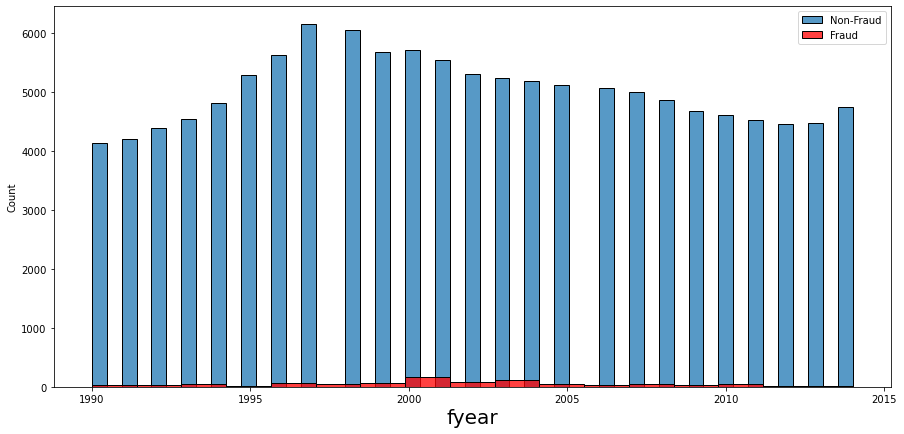

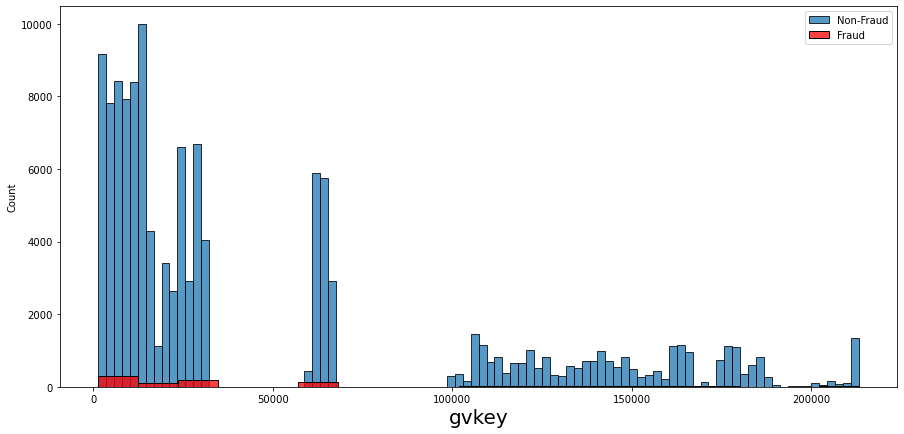

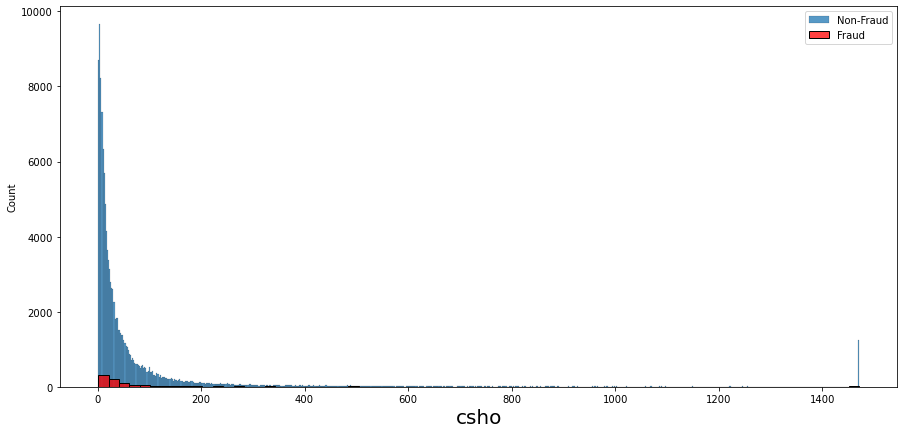

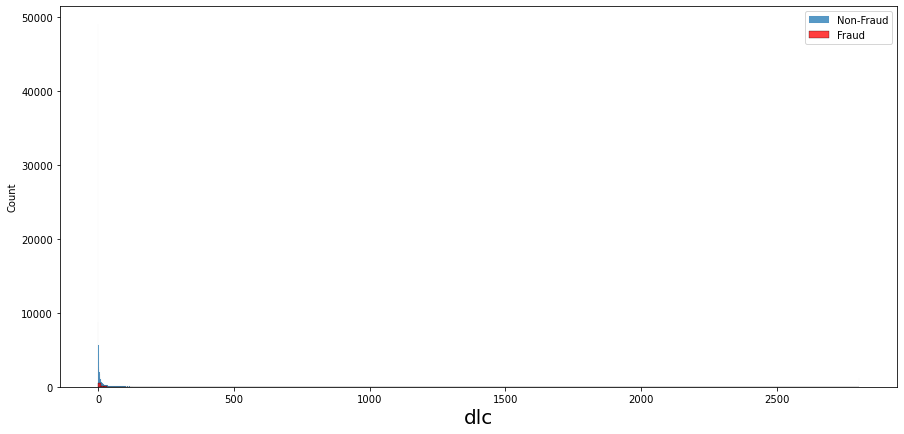

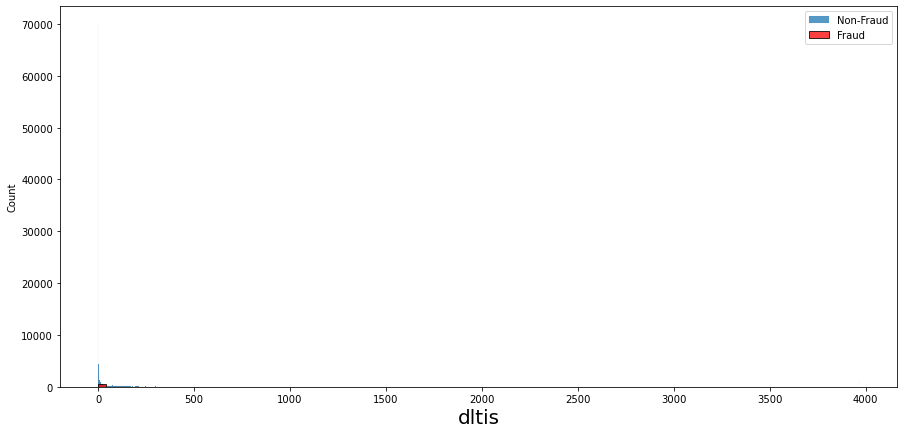

...

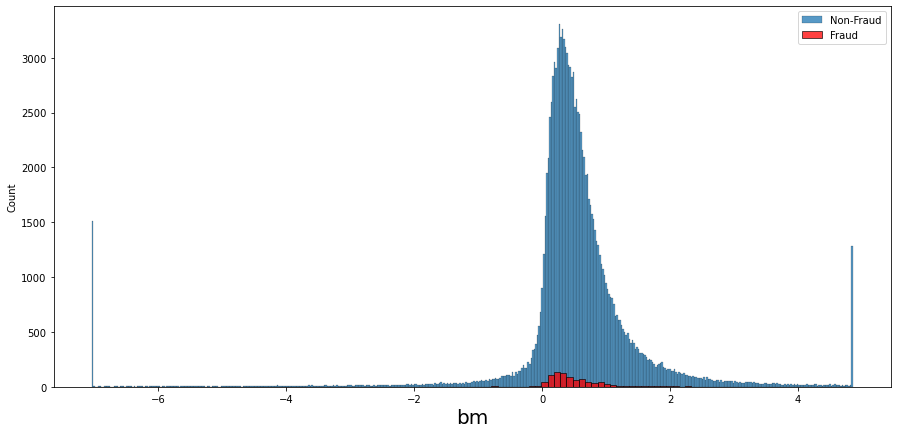

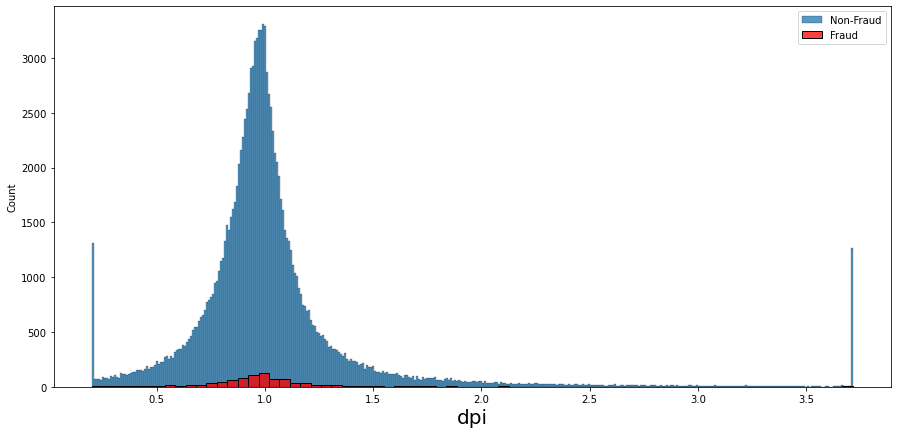

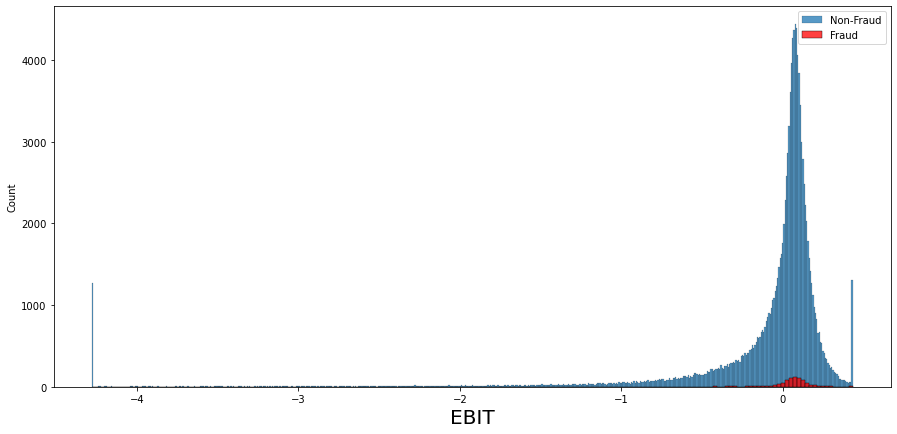

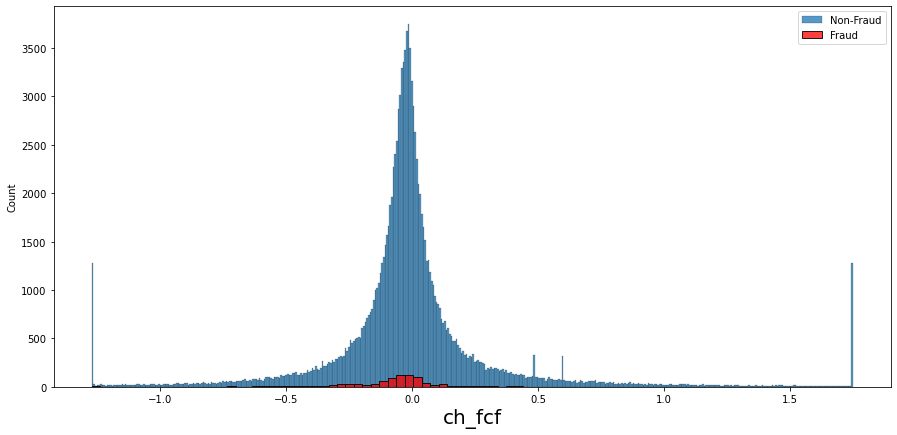

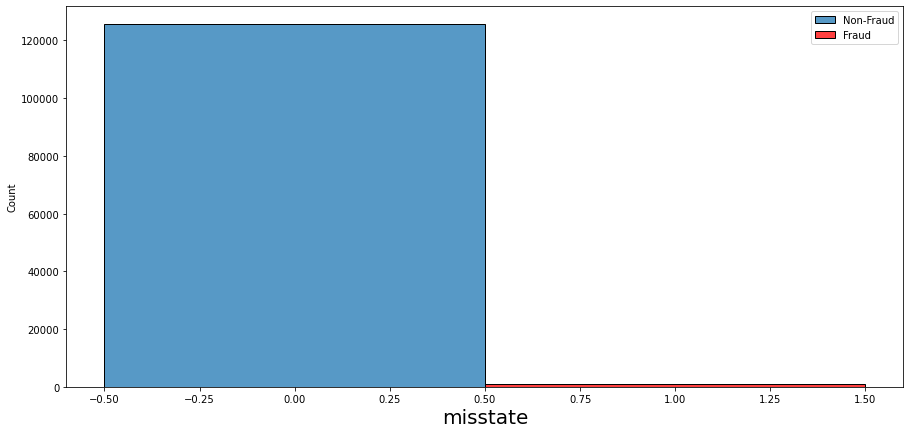

In [91]:
for i in df_n3.columns:
    plt.figure(figsize=(15,7))
    sns.histplot(df_n3[df_n3["misstate"]==0][i], label="Non-Fraud")
    sns.histplot(df_n3[df_n3["misstate"]==1][i], color="red", label="Fraud")
    plt.xlabel(i,fontsize=20)
    plt.legend()

(0.0, 3500.0)

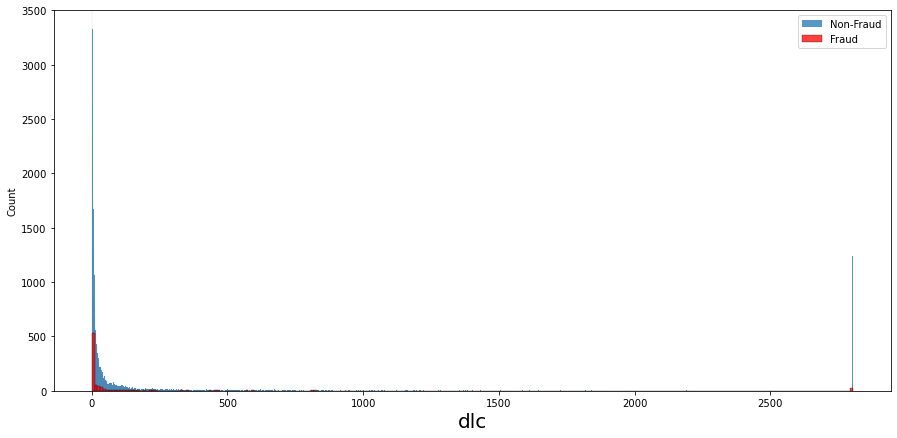

In [92]:
# histogram with dlc
plt.figure(figsize=(15,7))

sns.histplot(df_n3[df_n3["misstate"]==0]["dlc"], label="Non-Fraud")
sns.histplot(df_n3[df_n3["misstate"]==1]["dlc"], color="red", label="Fraud")
plt.xlabel("dlc",fontsize=20)
plt.legend()
plt.ylim(0,3500)

(0.0, 3500.0)

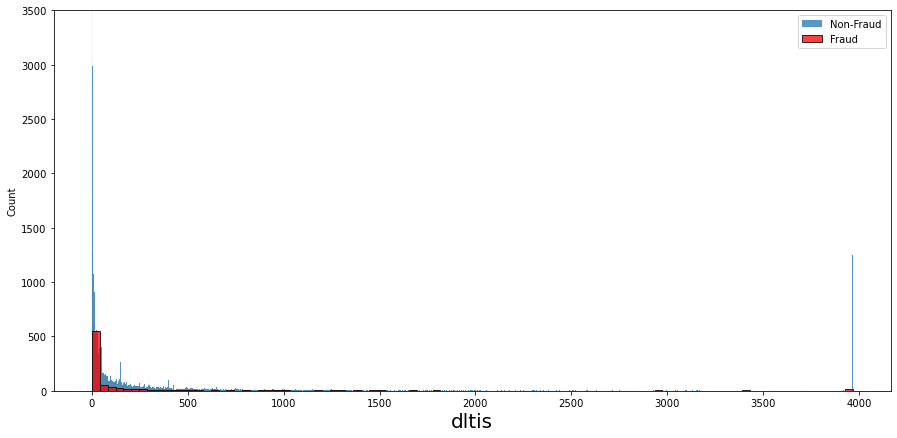

In [93]:
# histogram with dltis
plt.figure(figsize=(15,7))

sns.histplot(df_n3[df_n3["misstate"]==0]["dltis"], label="Non-Fraud")
sns.histplot(df_n3[df_n3["misstate"]==1]["dltis"], color="red", label="Fraud")
plt.xlabel("dltis",fontsize=20)
plt.legend()
plt.ylim(0,3500)

(0.0, 650.0)

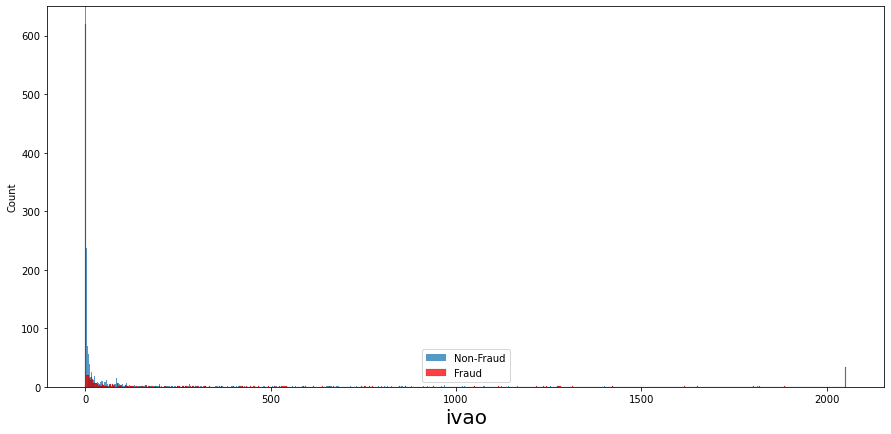

In [94]:
# histogram with ivao
plt.figure(figsize=(15,7))

sns.histplot(df_n3[df_n3["misstate"]==0]["ivao"], label="Non-Fraud")
sns.histplot(df_n3[df_n3["misstate"]==1]["ivao"], color="red", label="Fraud")
plt.xlabel("ivao",fontsize=20)
plt.legend()
plt.ylim(0,650)

(0.0, 4700.0)

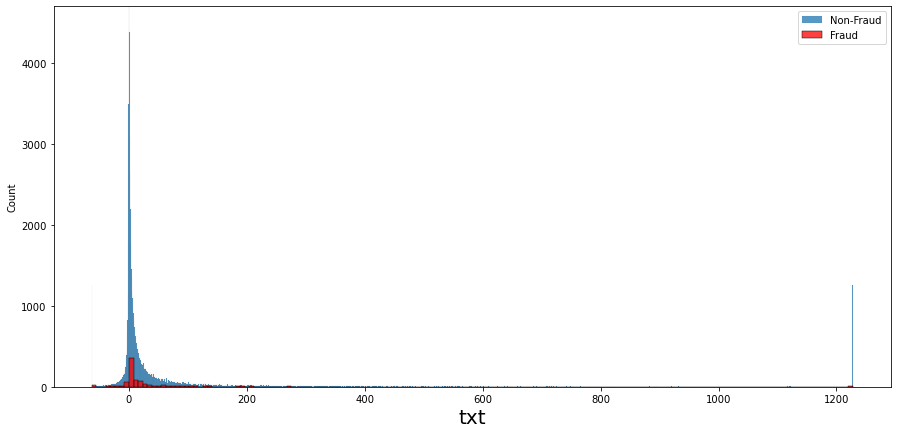

In [95]:
# histogram with txt
plt.figure(figsize=(15,7))

sns.histplot(df_n3[df_n3["misstate"]==0]["txt"], label="Non-Fraud")
sns.histplot(df_n3[df_n3["misstate"]==1]["txt"], color="red", label="Fraud")
plt.xlabel("txt",fontsize=20)
plt.legend()
plt.ylim(0,4700)

In [6]:
df_n3=pd.read_csv("D:/Disertation/df_n3.csv")


In [7]:
# first index value of year 2010
np.where(df_n3["fyear"]==2010)

(array([103559, 103560, 103561, ..., 108203, 108204, 108205], dtype=int64),)

In [8]:
# NOrmalisation scaling to 0 to 1
scaler= MinMaxScaler()
scaled_df = pd.DataFrame(scaler.fit_transform(df_n3), columns=df_n3.columns)
scaled_df.head()

,fyear,gvkey,csho,dlc,dltis,invt,ivao,ni,sstk,txt,...,dch_inv,soft_assets,ch_cs,ch_cm,ch_roa,bm,dpi,EBIT,ch_fcf,misstate
0,0.0,0.0,0.000974,0.001171,0.008284,0.000686,0.000000,0.146846,0.000000,0.049471,...,0.553831,0.314057,0.296852,0.528675,0.489238,0.626659,0.191425,0.942318,0.407092,0.0
1,0.0,0.0,0.001674,0.000007,0.000509,0.000193,0.000064,0.145620,0.000013,0.048876,...,0.415168,0.317698,0.305316,0.517178,0.453482,0.605178,0.154887,0.874483,0.454188,0.0
2,0.0,0.0,0.001896,0.002299,0.001639,0.001250,0.006326,0.146980,0.000000,0.049640,...,0.483503,0.622594,0.297075,0.521307,0.529695,0.779646,0.231709,0.921475,0.442980,0.0
3,0.0,0.0,0.002490,0.003136,0.000148,0.004503,0.000000,0.146321,0.000000,0.049158,...,0.496473,0.820346,0.287752,0.515679,0.502839,0.679704,0.234876,0.926706,0.415290,0.0
4,0.0,0.0,0.003837,0.011489,0.000000,0.002612,0.000000,0.139206,0.000000,0.048876,...,0.000000,0.900525,0.267367,0.459950,0.326301,0.457052,0.113147,0.759336,0.464152,0.0


In [9]:
scaled_df.isnull().sum()

fyear          0
gvkey          0
csho           0
dlc            0
dltis          0
invt           0
ivao           0
ni             0
sstk           0
txt            0
xint           0
prcc_f         0
dch_wc         0
ch_rsst        0
dch_rec        0
dch_inv        0
soft_assets    0
ch_cs          0
ch_cm          0
ch_roa         0
bm             0
dpi            0
EBIT           0
ch_fcf         0
misstate       0
dtype: int64

In [10]:
test=scaled_df.iloc[103559:]
train=scaled_df.iloc[0:103559]

y_train=train["misstate"]
X_train=train.drop(columns="misstate")

X_test=test.drop(columns="misstate")
y_test=test["misstate"]

In [11]:
train.shape

(103559, 25)

In [12]:
test.shape

(22924, 25)

In [31]:
#using smote for upsampling
bs=BorderlineSMOTE(sampling_strategy=1,random_state=0)
X_train_bs, y_train_bs=bs.fit_resample(X_train,y_train)

print("Number of classes before oversampling {}".format(Counter(y_train)))
print("Number of classes after oversampling {}".format(Counter(y_train_bs)))

Number of classes before oversampling Counter({0.0: 102728, 1.0: 831})
Number of classes after oversampling Counter({0.0: 102728, 1.0: 102728})


# LOGISTIC REGRESSION

# when solver is lbfgs

In [32]:
p_score1=[]
f_score1=[]
r_score1=[]
b_score1=[]
a_score1=[]
m_score1=[]

In [33]:
class_weight=dict({0:1,1:1})
lrc_lbfgs=LogisticRegression(solver="lbfgs",class_weight=class_weight)
lrc_lbfgs.fit(X_train_bs,y_train_bs)

LogisticRegression(class_weight={0: 1, 1: 1})

Precision  0.005044560282495376
F1 score  0.010023387905111928
Recall  0.7692307692307693
Accuracy  0.4829872622578957
Balaanced accuracy 0.6256203745479768


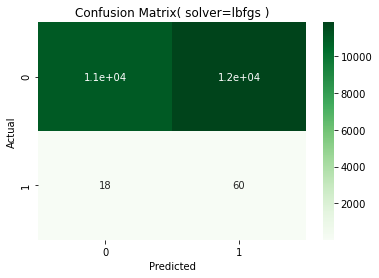

In [34]:
y_pred_lbfgs=lrc_lbfgs.predict(X_test)


precision=precision_score(y_test, y_pred_lbfgs)
p_score1.append(precision)

f1=f1_score(y_test, y_pred_lbfgs)
f_score1.append(f1)

accuracy=accuracy_score(y_test, y_pred_lbfgs)

recall=recall_score(y_test, y_pred_lbfgs)
r_score1.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_lbfgs)
m_score1.append(mcc)

bac=balanced_accuracy_score (y_test, y_pred_lbfgs)
b_score1.append(bac)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balaanced accuracy", bac)



cm=confusion_matrix(y_test,y_pred_lbfgs, labels=[0,1])
sns.heatmap(cm, cmap="Greens",annot=True)
plt.title("Confusion Matrix( solver=lbfgs )")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

In [35]:
print("Test {}".format(Counter(y_test)))
print("Prediction {}".format(Counter(y_pred_lbfgs)))

Test Counter({0.0: 22846, 1.0: 78})
Prediction Counter({1.0: 11894, 0.0: 11030})


No Skill: ROC AUC=0.500
Logistic: ROC AUC=0.659


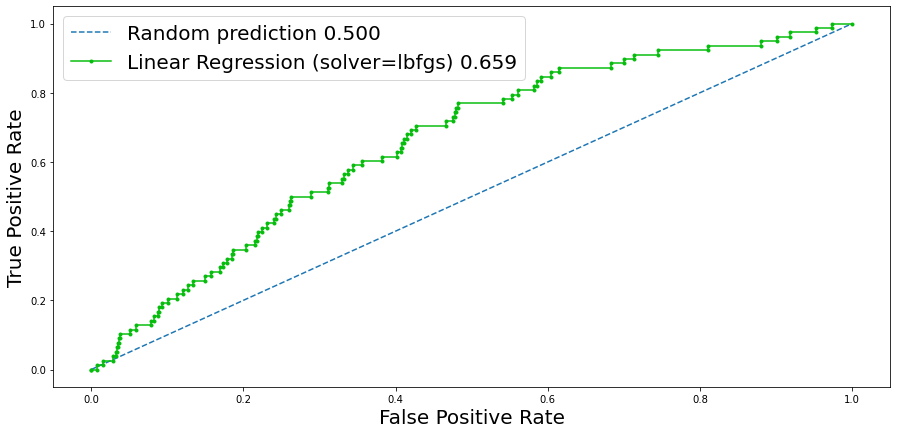

In [36]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
lr_probs = lrc_lbfgs.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
lr_probs = lr_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, lr_probs)
a_score1.append(rfc_auc)

print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('Logistic: ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
lrc_fpr, lrc_tpr, _ = roc_curve(y_test, lr_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(lrc_fpr, lrc_tpr, marker='.', label='Linear Regression (solver=lbfgs) %0.3f' % rfc_auc, color="#06BD0D")


# axis labels
plt.xlabel('False Positive Rate', fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# When solver is liblinear

In [37]:
lrc_liblinear=LogisticRegression(solver="liblinear",class_weight=class_weight)
lrc_liblinear.fit(X_train_bs,y_train_bs)

LogisticRegression(class_weight={0: 1, 1: 1}, solver='liblinear')

Precision  0.005053057099545225
F1 score  0.010040160642570283
Recall  0.7692307692307693
Accuracy  0.48385971034723435


Text(33.0, 0.5, 'Actual')

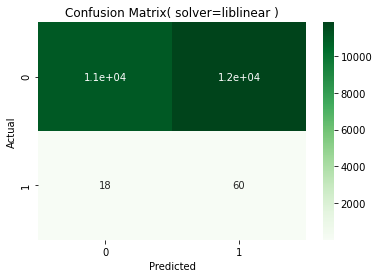

In [38]:
y_pred_liblinear=lrc_liblinear.predict(X_test)

precision=precision_score(y_test, y_pred_liblinear)
p_score1.append(precision)

f1=f1_score(y_test, y_pred_liblinear)
f_score1.append(f1)

accuracy=accuracy_score(y_test, y_pred_liblinear)

recall=recall_score(y_test, y_pred_liblinear)
r_score1.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_liblinear)
m_score1.append(mcc)

bac=balanced_accuracy_score (y_test, y_pred_liblinear)
b_score1.append(bac)


print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)



cm=confusion_matrix(y_test,y_pred_liblinear, labels=[0,1])

sns.heatmap(cm, cmap="Greens",annot=True)
plt.title("Confusion Matrix( solver=liblinear )")
plt.xlabel("Predicted")
plt.ylabel("Actual")

In [39]:
print("Test {}".format(Counter(y_test)))
print("Prediction {}".format(Counter(y_pred_liblinear)))

Test Counter({0.0: 22846, 1.0: 78})
Prediction Counter({1.0: 11874, 0.0: 11050})


No Skill: ROC AUC=0.500
Logistic: ROC AUC=0.660


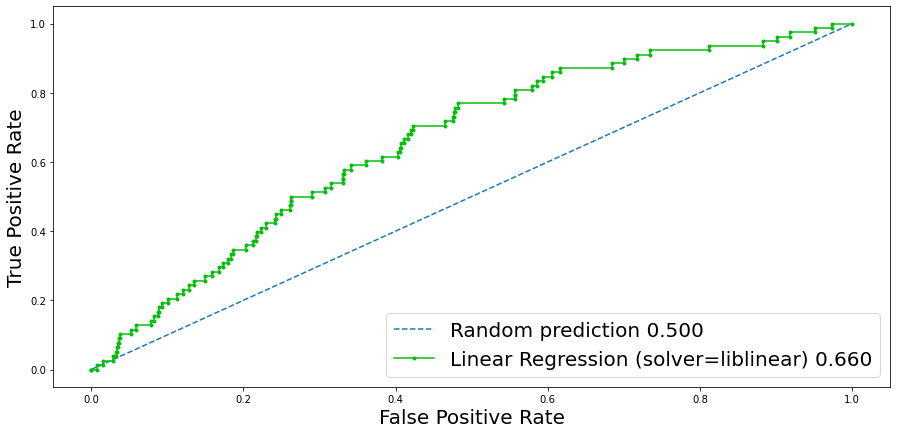

In [40]:
# Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
lr_probs = lrc_liblinear.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
lr_probs = lr_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
lr_auc = roc_auc_score(y_test, lr_probs)
a_score1.append(lr_auc)

print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('Logistic: ROC AUC=%.3f' %(lr_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(lr_fpr, lr_tpr, marker='.', label='Linear Regression (solver=liblinear) %0.3f' % lr_auc, color="#06BD0D")


# axis labels
plt.xlabel('False Positive Rate',fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# When solver is newton_cg

In [41]:
lrc_newton_cg=LogisticRegression(solver="newton-cg",class_weight=class_weight)
lrc_newton_cg.fit(X_train_bs,y_train_bs)

LogisticRegression(class_weight={0: 1, 1: 1}, solver='newton-cg')

Precision  0.005044984444631296
F1 score  0.010024225210926406
Recall  0.7692307692307693
Accuracy  0.4830308846623626


Text(33.0, 0.5, 'Actual')

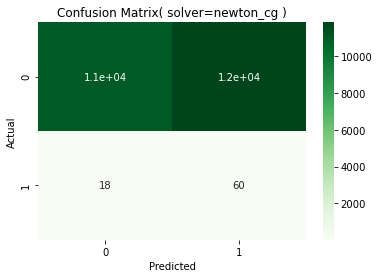

In [42]:
y_pred_newton_cg=lrc_newton_cg.predict(X_test)


precision=precision_score(y_test, y_pred_newton_cg)
p_score1.append(precision)

f1=f1_score(y_test, y_pred_newton_cg)
f_score1.append(f1)

accuracy=accuracy_score(y_test, y_pred_newton_cg)

recall=recall_score(y_test, y_pred_newton_cg)
r_score1.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_newton_cg)
m_score1.append(mcc)

bac=balanced_accuracy_score (y_test, y_pred_newton_cg)
b_score1.append(bac)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)



cm=confusion_matrix(y_test,y_pred_newton_cg, labels=[0,1])
sns.heatmap(cm, cmap="Greens",annot=True)
plt.title("Confusion Matrix( solver=newton_cg )")
plt.xlabel("Predicted")
plt.ylabel("Actual")

No Skill: ROC AUC=0.500
Logistic: ROC AUC=0.659


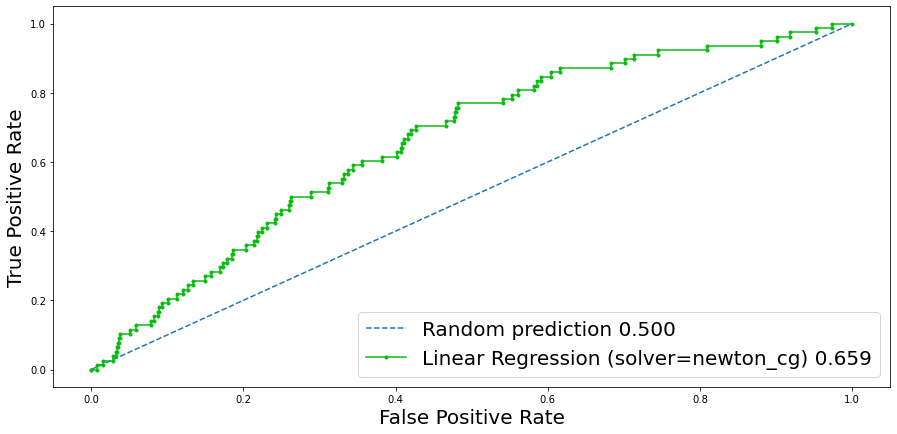

In [43]:
# Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
lr_probs = lrc_newton_cg.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
lr_probs = lr_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
lr_auc = roc_auc_score(y_test, lr_probs)
a_score1.append(lr_auc)

print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('Logistic: ROC AUC=%.3f' %(lr_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(lr_fpr, lr_tpr, marker='.', label='Linear Regression (solver=newton_cg) %0.3f' % lr_auc, color="#06BD0D")


# axis labels
plt.xlabel('False Positive Rate',fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# When solver is newton-cholesky

In [44]:
lrc_newton_cholesky=LogisticRegression(solver="newton-cholesky",penalty="l2")
lrc_newton_cholesky.fit(X_train_bs,y_train_bs)

LogisticRegression(solver='newton-cholesky')

Precision  0.005044984444631296
F1 score  0.010024225210926406
Recall  0.7692307692307693
Accuracy  0.4830308846623626


Text(33.0, 0.5, 'Actual')

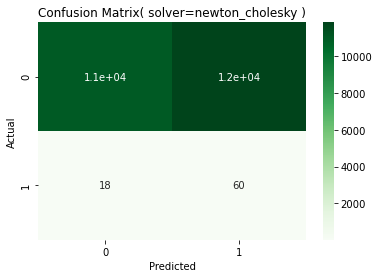

In [45]:
y_pred_newton_cholesky=lrc_newton_cholesky.predict(X_test)


precision=precision_score(y_test, y_pred_newton_cholesky)
p_score1.append(precision)

f1=f1_score(y_test, y_pred_newton_cholesky)
f_score1.append(f1)

accuracy=accuracy_score(y_test, y_pred_newton_cholesky)


recall=recall_score(y_test, y_pred_newton_cholesky)
r_score1.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_newton_cholesky)
m_score1.append(mcc)

bac=balanced_accuracy_score (y_test, y_pred_newton_cholesky)
b_score1.append(bac)


print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)



cm=confusion_matrix(y_test,y_pred_newton_cholesky, labels=[0,1])
sns.heatmap(cm, cmap="Greens",annot=True)
plt.title("Confusion Matrix( solver=newton_cholesky )")
plt.xlabel("Predicted")
plt.ylabel("Actual")

No Skill: ROC AUC=0.500
Logistic: ROC AUC=0.659


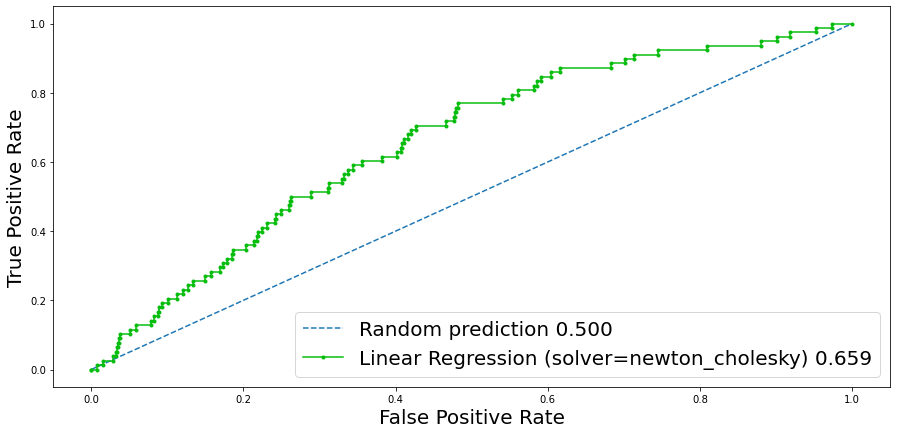

In [46]:
# Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
lr_probs = lrc_newton_cholesky.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
lr_probs = lr_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
lr_auc = roc_auc_score(y_test, lr_probs)
a_score1.append(lr_auc)

print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('Logistic: ROC AUC=%.3f' %(lr_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(lr_fpr, lr_tpr, marker='.', label='Linear Regression (solver=newton_cholesky) %0.3f' % lr_auc, color="#06BD0D")


# axis labels
plt.xlabel('False Positive Rate',fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# When solver is sag

In [47]:
lrc_sag=LogisticRegression(solver="sag",penalty="l2",class_weight=class_weight)
lrc_sag.fit(X_train_bs,y_train_bs)

LogisticRegression(class_weight={0: 1, 1: 1}, solver='sag')

Precision  0.005046257359125316
F1 score  0.010026737967914439
Recall  0.7692307692307693
Accuracy  0.4831617518757634


Text(33.0, 0.5, 'Actual')

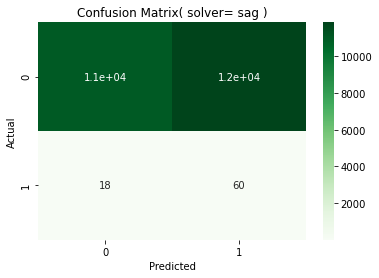

In [48]:
y_pred_sag=lrc_sag.predict(X_test)


precision=precision_score(y_test, y_pred_sag)
p_score1.append(precision)

f1=f1_score(y_test, y_pred_sag)
f_score1.append(f1)

accuracy=accuracy_score(y_test, y_pred_sag)


recall=recall_score(y_test, y_pred_sag)
r_score1.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_sag)
m_score1.append(mcc)

bac=balanced_accuracy_score (y_test, y_pred_sag)
b_score1.append(bac)


print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)



cm=confusion_matrix(y_test,y_pred_sag, labels=[0,1])
sns.heatmap(cm, cmap="Greens",annot=True)
plt.title("Confusion Matrix( solver= sag )")
plt.xlabel("Predicted")
plt.ylabel("Actual")

No Skill: ROC AUC=0.500
Logistic: ROC AUC=0.659


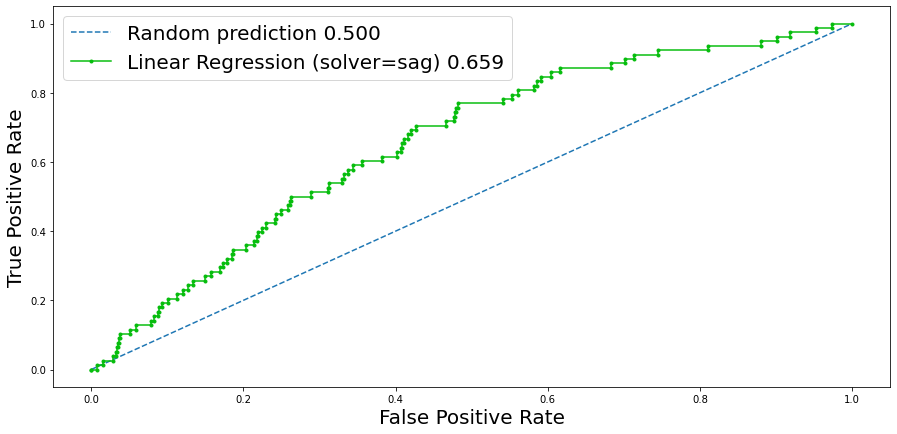

In [49]:
# Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
lr_probs = lrc_sag.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
lr_probs = lr_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
lr_auc = roc_auc_score(y_test, lr_probs)
a_score1.append(lr_auc)

print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('Logistic: ROC AUC=%.3f' %(lr_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(lr_fpr, lr_tpr, marker='.', label='Linear Regression (solver=sag) %0.3f' % lr_auc, color="#06BD0D")


# axis labels
plt.xlabel('False Positive Rate',fontsize=20)
plt.ylabel('True Positive Rate', fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# When solver is saga

In [50]:
lrc_saga=LogisticRegression(solver="saga",class_weight=class_weight)
lrc_saga.fit(X_train_bs,y_train_bs)

LogisticRegression(class_weight={0: 1, 1: 1}, solver='saga')

Precision  0.005046257359125316
F1 score  0.010026737967914439
Recall  0.7692307692307693
Accuracy  0.4831617518757634


Text(33.0, 0.5, 'Actual')

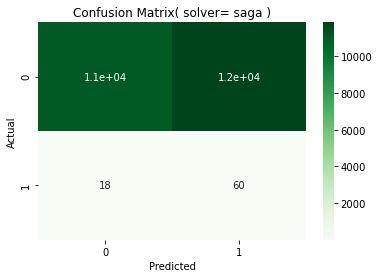

In [51]:
y_pred_saga=lrc_saga.predict(X_test)


precision=precision_score(y_test, y_pred_saga)
p_score1.append(precision)

f1=f1_score(y_test, y_pred_saga)
f_score1.append(f1)

accuracy=accuracy_score(y_test, y_pred_saga)


recall=recall_score(y_test, y_pred_saga)
r_score1.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_saga)
m_score1.append(mcc)

bac=balanced_accuracy_score (y_test, y_pred_saga)
b_score1.append(bac)


print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)



cm=confusion_matrix(y_test,y_pred_saga, labels=[0,1])
sns.heatmap(cm, cmap="Greens",annot=True)
plt.title("Confusion Matrix( solver= saga )")
plt.xlabel("Predicted")
plt.ylabel("Actual")

No Skill: ROC AUC=0.500
Logistic: ROC AUC=0.659


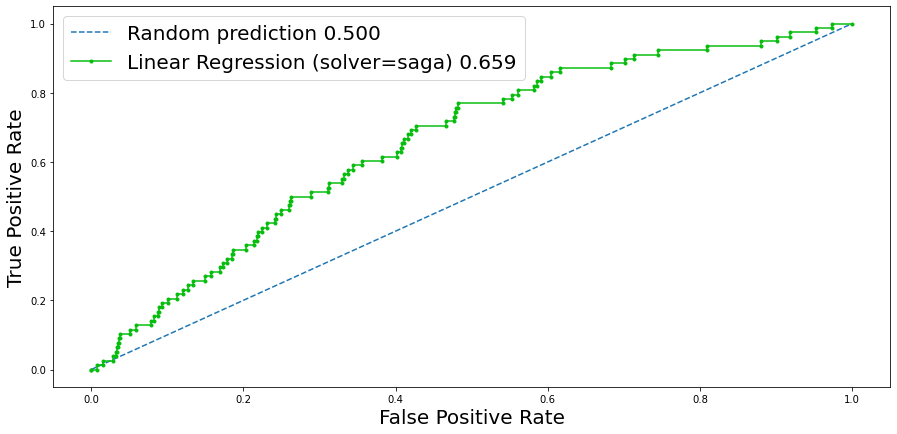

In [52]:
# Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
lr_probs = lrc_saga.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
lr_probs = lr_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
lr_auc = roc_auc_score(y_test, lr_probs)
a_score1.append(lr_auc)

print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('Logistic: ROC AUC=%.3f' %(lr_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(lr_fpr, lr_tpr, marker='.', label='Linear Regression (solver=saga) %0.3f' % lr_auc, color="#06BD0D")


# axis labels
plt.xlabel('False Positive Rate', fontsize=20)
plt.ylabel('True Positive Rate', fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

In [53]:
algo1=['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga']
performance_df1 = pd.DataFrame(
{'Logistic Regression(Solver) ':algo1,'Balanced Accuracy(BAC)':b_score1,"F1 Score":f_score1,'Precision':p_score1, "Recall":r_score1, "ROC AUC":a_score1,
 "Matthews Correlation Coefficient(MCC)":m_score1
})

In [54]:
performance_df1

,Logistic Regression(Solver),Balanced Accuracy(BAC),F1 Score,Precision,Recall,ROC AUC,Matthews Correlation Coefficient(MCC)
0,lbfgs,0.625620,0.010023,0.005045,0.769231,0.659427,0.029281
1,liblinear,0.626058,0.010040,0.005053,0.769231,0.659525,0.029381
2,newton-cg,0.625642,0.010024,0.005045,0.769231,0.659426,0.029286
3,newton-cholesky,0.625642,0.010024,0.005045,0.769231,0.659427,0.029286
4,sag,0.625708,0.010027,0.005046,0.769231,0.659429,0.029301
5,saga,0.625708,0.010027,0.005046,0.769231,0.659427,0.029301


# K-nearest neighbors

In [55]:
p_score2=[]
f_score2=[]
r_score2=[]
b_score2=[]
a_score2=[]
m_score2=[]

# algorithm=auto

In [56]:
knc_auto=KNeighborsClassifier(algorithm="auto")
knc_auto.fit(X_train_bs, y_train_bs)

KNeighborsClassifier()

Precision  0.03532008830022075
F1 score  0.060263653483992465
Recall  0.20512820512820512
Accuracy  0.9782324201709999
Balanced Accuracy  0.5930000650958368
Matthews Correlation Coefficient 0.077822528091937


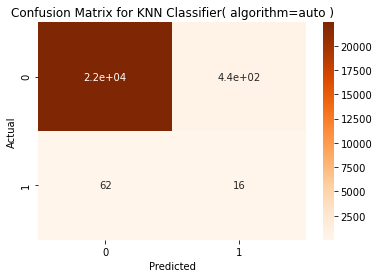

In [57]:
y_pred_auto=knc_auto.predict(X_test)

precision=precision_score(y_test, y_pred_auto)
p_score2.append(precision)

f1=f1_score(y_test, y_pred_auto)
f_score2.append(f1)

accuracy=accuracy_score(y_test, y_pred_auto)

recall=recall_score(y_test, y_pred_auto)
r_score2.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_auto)
m_score2.append(mcc)


bac=balanced_accuracy_score (y_test, y_pred_auto)
b_score2.append(bac)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)
print("Matthews Correlation Coefficient",mcc)

cm=confusion_matrix(y_test,y_pred_auto, labels=[0,1])
sns.heatmap(cm, cmap="Oranges",annot=True)
plt.title("Confusion Matrix for KNN Classifier( algorithm=auto )")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Random predcition: ROC AUC=0.500
KNN Classifier(booster=auto): ROC AUC=0.612


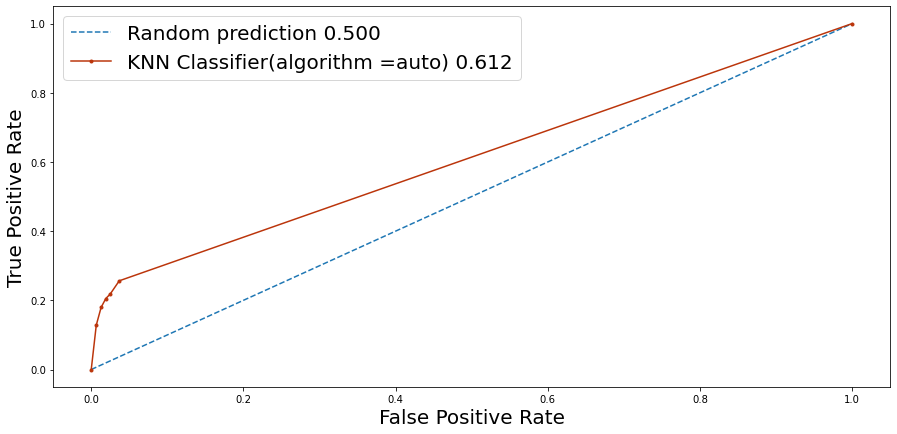

In [58]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = knc_auto.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score2.append(rfc_auc)
print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('KNN Classifier(booster=auto): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='KNN Classifier(algorithm =auto) %0.3f' % rfc_auc, color="#BB350B")


# axis labels
plt.xlabel('False Positive Rate', fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# algorithm=ball_tree

In [59]:
knc_ball_tree=KNeighborsClassifier(algorithm="ball_tree")
knc_ball_tree.fit(X_train_bs, y_train_bs)

KNeighborsClassifier(algorithm='ball_tree')

Precision  0.03532008830022075
F1 score  0.060263653483992465
Recall  0.20512820512820512
Accuracy  0.9782324201709999
Balanced Accuracy  0.5930000650958368
Matthews Correlation Coefficient 0.077822528091937


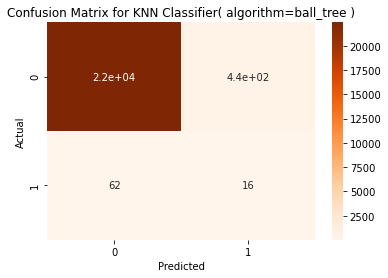

In [60]:
y_pred_ball_tree=knc_ball_tree.predict(X_test)

precision=precision_score(y_test, y_pred_ball_tree)
p_score2.append(precision)

f1=f1_score(y_test, y_pred_ball_tree)
f_score2.append(f1)

accuracy=accuracy_score(y_test, y_pred_ball_tree)

recall=recall_score(y_test, y_pred_ball_tree)
r_score2.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_ball_tree)
m_score2.append(mcc)


bac=balanced_accuracy_score (y_test, y_pred_ball_tree)
b_score2.append(bac)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)
print("Matthews Correlation Coefficient",mcc)

cm=confusion_matrix(y_test,y_pred_ball_tree, labels=[0,1])
sns.heatmap(cm, cmap="Oranges",annot=True)
plt.title("Confusion Matrix for KNN Classifier( algorithm=ball_tree )")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Random predcition: ROC AUC=0.500
KNN Classifier(booster=ball_tree): ROC AUC=0.612


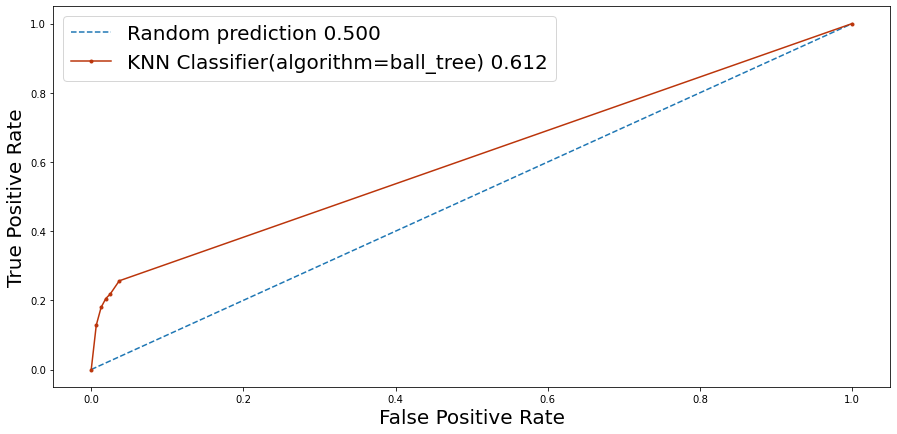

In [61]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = knc_ball_tree.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score2.append(rfc_auc)
print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('KNN Classifier(booster=ball_tree): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='KNN Classifier(algorithm=ball_tree) %0.3f' % rfc_auc, color="#BB350B")


# axis labels
plt.xlabel('False Positive Rate',fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# algorithm=kd_tree

In [62]:
knc_kd_tree=KNeighborsClassifier(algorithm="kd_tree")
knc_kd_tree.fit(X_train_bs, y_train_bs)

KNeighborsClassifier(algorithm='kd_tree')

Precision  0.03532008830022075
F1 score  0.060263653483992465
Recall  0.20512820512820512
Accuracy  0.9782324201709999
Balanced Accuracy  0.5930000650958368
Matthews Correlation Coefficient 0.077822528091937


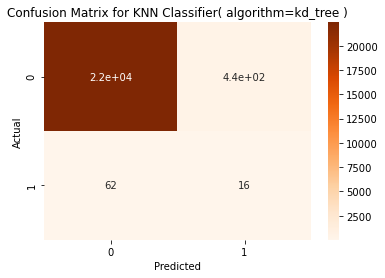

In [63]:
y_pred_kd_tree=knc_kd_tree.predict(X_test)

precision=precision_score(y_test, y_pred_kd_tree)
p_score2.append(precision)

f1=f1_score(y_test, y_pred_kd_tree)
f_score2.append(f1)

accuracy=accuracy_score(y_test, y_pred_kd_tree)

recall=recall_score(y_test, y_pred_kd_tree)
r_score2.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_kd_tree)
m_score2.append(mcc)


bac=balanced_accuracy_score (y_test, y_pred_kd_tree)
b_score2.append(bac)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)
print("Matthews Correlation Coefficient",mcc)

cm=confusion_matrix(y_test,y_pred_kd_tree, labels=[0,1])
sns.heatmap(cm, cmap="Oranges",annot=True)
plt.title("Confusion Matrix for KNN Classifier( algorithm=kd_tree )")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Random predcition: ROC AUC=0.500
KNN Classifier(algorithm=kd_tree): ROC AUC=0.612


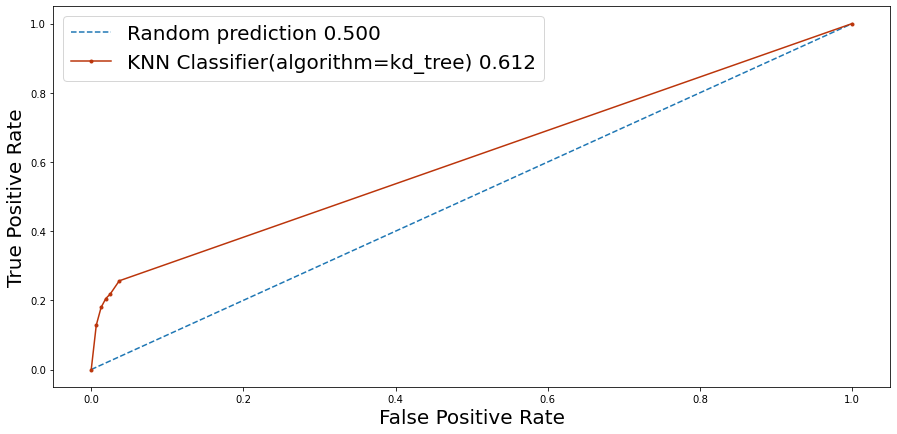

In [64]:
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = knc_kd_tree.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score2.append(rfc_auc)
print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('KNN Classifier(algorithm=kd_tree): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='KNN Classifier(algorithm=kd_tree) %0.3f' % rfc_auc, color="#BB350B")


# axis labels
plt.xlabel('False Positive Rate',fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# algorithm=brute

In [65]:
knc_brute=KNeighborsClassifier(algorithm="brute")
knc_brute.fit(X_train_bs, y_train_bs)

KNeighborsClassifier(algorithm='brute')

Precision  0.03532008830022075
F1 score  0.060263653483992465
Recall  0.20512820512820512
Accuracy  0.9782324201709999
Balanced Accuracy  0.5930000650958368
Matthews Correlation Coefficient 0.077822528091937


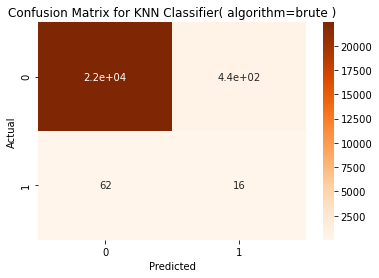

In [66]:
y_pred_brute=knc_brute.predict(X_test)

precision=precision_score(y_test, y_pred_brute)
p_score2.append(precision)

f1=f1_score(y_test, y_pred_brute)
f_score2.append(f1)

accuracy=accuracy_score(y_test, y_pred_brute)

recall=recall_score(y_test, y_pred_brute)
r_score2.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_brute)
m_score2.append(mcc)


bac=balanced_accuracy_score (y_test, y_pred_brute)
b_score2.append(bac)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)
print("Matthews Correlation Coefficient",mcc)

cm=confusion_matrix(y_test,y_pred_brute, labels=[0,1])
sns.heatmap(cm, cmap="Oranges",annot=True)
plt.title("Confusion Matrix for KNN Classifier( algorithm=brute )")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()



Random predcition: ROC AUC=0.500
KNN Classifier(algorithm=brute): ROC AUC=0.612


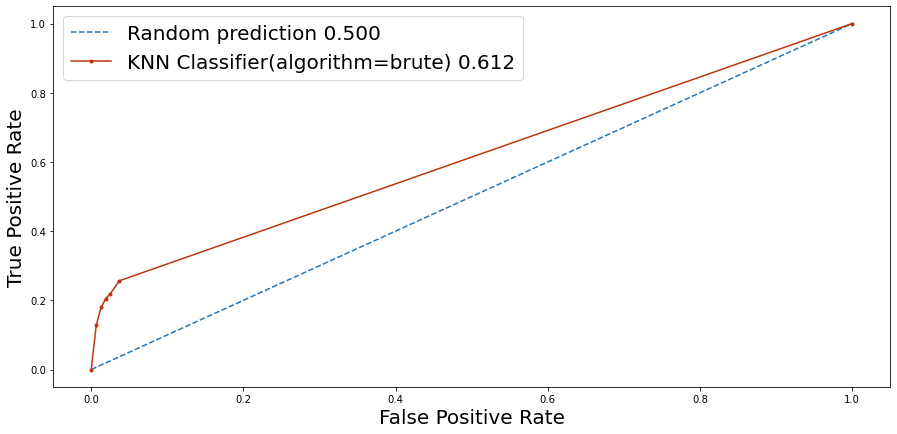

In [67]:
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = knc_kd_tree.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score2.append(rfc_auc)

print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('KNN Classifier(algorithm=brute): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='KNN Classifier(algorithm=brute) %0.3f' % rfc_auc, color="#BB350B")


# axis labels
plt.xlabel('False Positive Rate', fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

In [68]:
algo2=("auto","ball_tree","kd_tree", "brute")

In [69]:
performance_df2 = pd.DataFrame(
{'KNN clasiifer(Algorithm)':algo2,'Balanced Accuracy':b_score2,"F1 Score":f_score2,
 'Precision':p_score2, "Recall":r_score2, "ROC AUC":a_score2,"Matthews Correlation Coefficient":m_score2
})

In [70]:
performance_df2.sort_values("Balanced Accuracy", ascending=True)

,KNN clasiifer(Algorithm),Balanced Accuracy,F1 Score,Precision,Recall,ROC AUC,Matthews Correlation Coefficient
0,auto,0.593,0.060264,0.03532,0.205128,0.611714,0.077823
1,ball_tree,0.593,0.060264,0.03532,0.205128,0.611714,0.077823
2,kd_tree,0.593,0.060264,0.03532,0.205128,0.611714,0.077823
3,brute,0.593,0.060264,0.03532,0.205128,0.611714,0.077823


# Naive Bayes

In [71]:
p_score3=[]
f_score3=[]
r_score3=[]
b_score3=[]
a_score3=[]
m_score3=[]

# MultinomialNB

In [72]:
mnb=MultinomialNB()
mnb.fit(X_train_bs, y_train_bs)

MultinomialNB()

Precision  0.00579950289975145
F1 score  0.01141459437423563
Recall  0.358974358974359
Accuracy  0.788431338335369
Balanced Accuracy  0.5744359670211022
Matthews Correlation Coefficient 0.021261323403473323


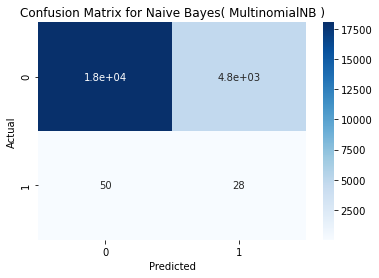

In [73]:
y_pred_mnb=mnb.predict(X_test)

precision=precision_score(y_test, y_pred_mnb)
p_score3.append(precision)

f1=f1_score(y_test, y_pred_mnb)
f_score3.append(f1)

accuracy=accuracy_score(y_test, y_pred_mnb)


recall=recall_score(y_test, y_pred_mnb)
r_score3.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_mnb)
m_score3.append(mcc)

bac=balanced_accuracy_score (y_test, y_pred_mnb)
b_score3.append(bac)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)
print("Matthews Correlation Coefficient", mcc)

cm=confusion_matrix(y_test,y_pred_mnb, labels=[0,1])
sns.heatmap(cm, cmap="Blues",annot=True)
plt.title("Confusion Matrix for Naive Bayes( MultinomialNB )")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Random predcition: ROC AUC=0.500
Naive Bayes(MultinomialNB): ROC AUC=0.605


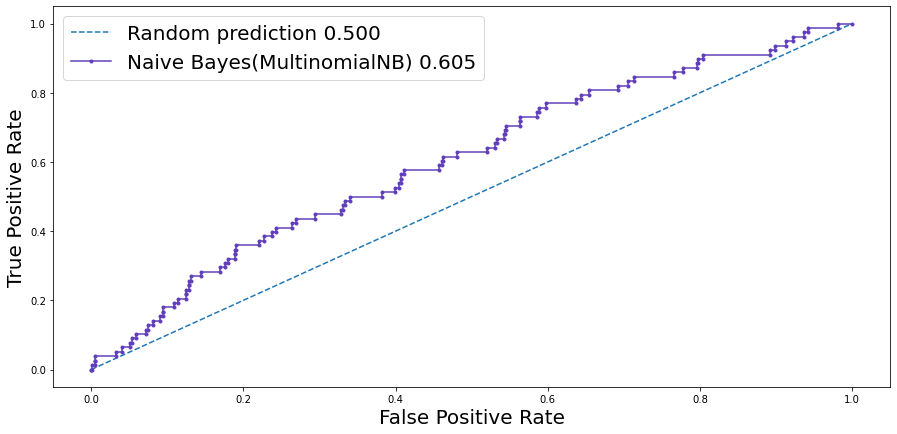

In [74]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = mnb.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score3.append(rfc_auc)
print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('Naive Bayes(MultinomialNB): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='Naive Bayes(MultinomialNB) %0.3f' % rfc_auc, color="#603EBB")


# axis labels
plt.xlabel('False Positive Rate', fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# GaussianNB

In [75]:
gnb = GaussianNB()
gnb.fit(X_train_bs, y_train_bs)

GaussianNB()

Precision  0.005019037729318103
F1 score  0.009904371584699452
Recall  0.3717948717948718
Accuracy  0.7470772989007154
Balanced Accuracy  0.5600767233000447
Matthews Correlation Coefficient 0.016114559642258657


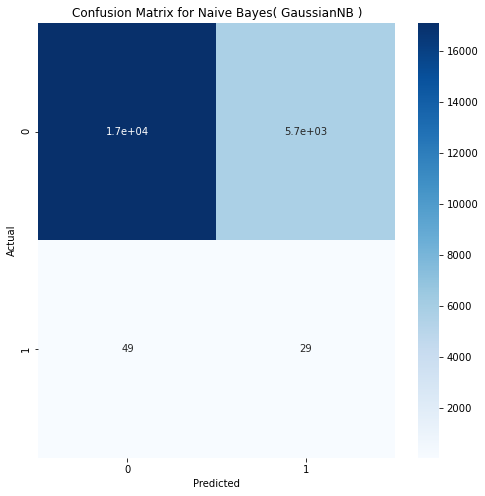

In [76]:
y_pred_gnb=gnb.predict(X_test)

precision=precision_score(y_test, y_pred_gnb)
p_score3.append(precision)

f1=f1_score(y_test, y_pred_gnb)
f_score3.append(f1)

accuracy=accuracy_score(y_test, y_pred_gnb)

recall=recall_score(y_test, y_pred_gnb)
r_score3.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_gnb)
m_score3.append(mcc)

bac=balanced_accuracy_score (y_test, y_pred_gnb)
b_score3.append(bac)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)
print("Matthews Correlation Coefficient", mcc)

plt.figure(figsize=(8,8))
cm=confusion_matrix(y_test,y_pred_gnb, labels=[0,1],)
sns.heatmap(cm, cmap="Blues",annot=True )
plt.title("Confusion Matrix for Naive Bayes( GaussianNB )")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Random predcition: ROC AUC=0.500
Naive Bayes( GaussianNB ): ROC AUC=0.579


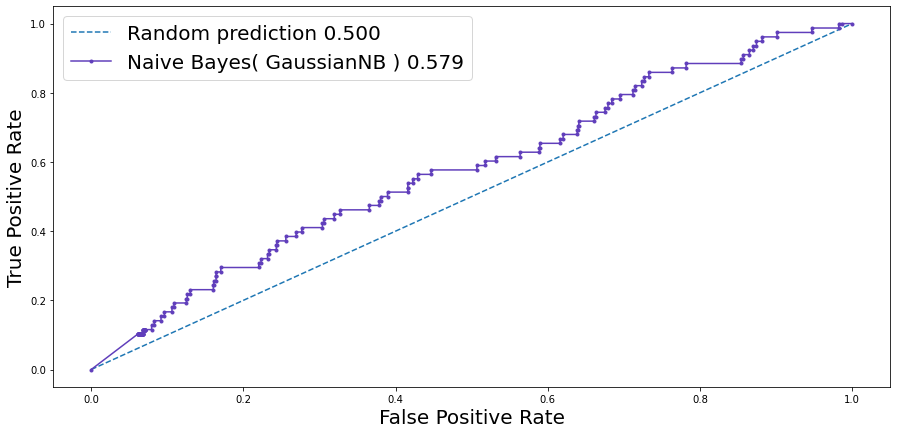

In [77]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = gnb.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score3.append(rfc_auc)
print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('Naive Bayes( GaussianNB ): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='Naive Bayes( GaussianNB ) %0.3f' % rfc_auc, color="#603EBB")


# axis labels
plt.xlabel('False Positive Rate',fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# BernoulliNB

In [78]:
bnb = BernoulliNB()
bnb.fit(X_train_bs, y_train_bs)

BernoulliNB()

Precision  0.003576341127922971
F1 score  0.007076755579749591
Recall  0.3333333333333333
Accuracy  0.6817309370092479
Balanced Accuracy  0.5081268785199451
Matthews Correlation Coefficient  0.002033884473965548


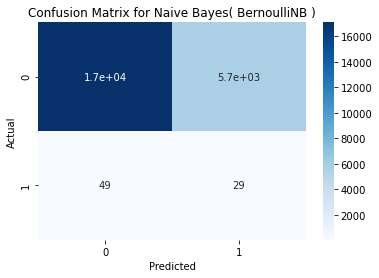

In [79]:
y_pred_bnb=bnb.predict(X_test)

precision=precision_score(y_test, y_pred_bnb)
p_score3.append(precision)

f1=f1_score(y_test, y_pred_bnb)
f_score3.append(f1)

accuracy=accuracy_score(y_test, y_pred_bnb)

recall=recall_score(y_test, y_pred_bnb)
r_score3.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_bnb)
m_score3.append(mcc)


bac=balanced_accuracy_score (y_test, y_pred_bnb)
b_score3.append(bac)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)
print("Matthews Correlation Coefficient ",mcc)

cm=confusion_matrix(y_test,y_pred_gnb, labels=[0,1])
sns.heatmap(cm, cmap="Blues",annot=True)
plt.title("Confusion Matrix for Naive Bayes( BernoulliNB )")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Random predcition: ROC AUC=0.500
Naive Bayes( BernoulliNB ): ROC AUC=0.561


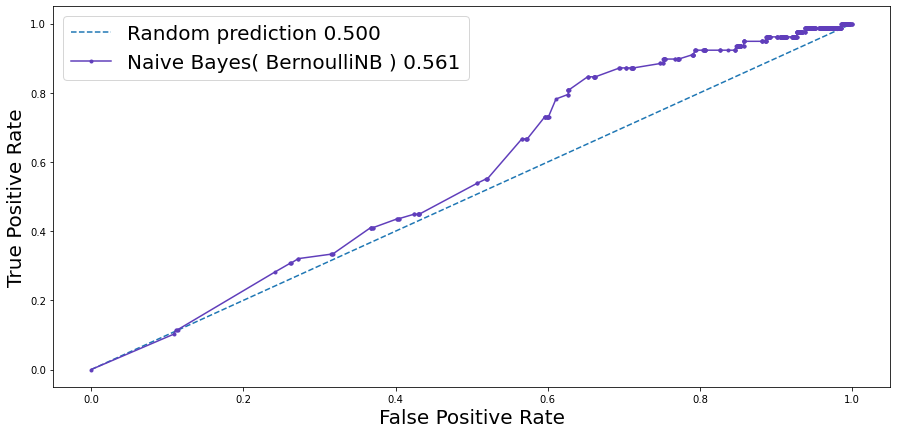

In [80]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = bnb.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score3.append(rfc_auc)
print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('Naive Bayes( BernoulliNB ): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='Naive Bayes( BernoulliNB ) %0.3f' % rfc_auc, color="#603EBB")


# axis labels
plt.xlabel('False Positive Rate',fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

In [81]:
algo3=["MultinomialNB","GaussianNB","BernoulliNB"]
performance_df3= pd.DataFrame(
{'Naive Bayes ':algo3,'Balanced Accuracy(BAC)':b_score3,"F1 Score":f_score3,'Precision':p_score3, "Recall":r_score3, "ROC AUC":a_score3,
 "Matthews Correlation Coefficient(MCC)":m_score3
})

In [82]:
performance_df3

,Naive Bayes,Balanced Accuracy(BAC),F1 Score,Precision,Recall,ROC AUC,Matthews Correlation Coefficient(MCC)
0,MultinomialNB,0.574436,0.011415,0.005800,0.358974,0.605169,0.021261
1,GaussianNB,0.560077,0.009904,0.005019,0.371795,0.578519,0.016115
2,BernoulliNB,0.508127,0.007077,0.003576,0.333333,0.561405,0.002034


# Decision Tree

In [83]:
p_score4=[]
f_score4=[]
r_score4=[]
b_score4=[]
a_score4=[]
m_score4=[]

# criterion=gini

In [84]:
dt_gini=DecisionTreeClassifier()
dt_gini.fit(X_train_bs, y_train_bs)

DecisionTreeClassifier()

Precision  0.007444168734491315
F1 score  0.012474012474012475
Recall  0.038461538461538464
Accuracy  0.9792793578782062
Balanced Accuracy  0.5104765015252628
Matthews Correlation Coefficient 0.009284367131727027


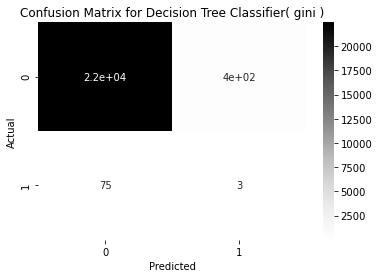

In [85]:
y_pred_gini=dt_gini.predict(X_test)

precision=precision_score(y_test, y_pred_gini)
p_score4.append(precision)

f1=f1_score(y_test, y_pred_gini)
f_score4.append(f1)

accuracy=accuracy_score(y_test, y_pred_gini)


recall=recall_score(y_test, y_pred_gini)
r_score4.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_gini)
m_score4.append(mcc)

bac=balanced_accuracy_score (y_test, y_pred_gini)
b_score4.append(bac)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)
print("Matthews Correlation Coefficient", mcc)

cm=confusion_matrix(y_test,y_pred_gini, labels=[0,1])
sns.heatmap(cm, cmap="Greys",annot=True)
plt.title("Confusion Matrix for Decision Tree Classifier( gini )")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Random predcition: ROC AUC=0.500
Decision Tree (gini): ROC AUC=0.510


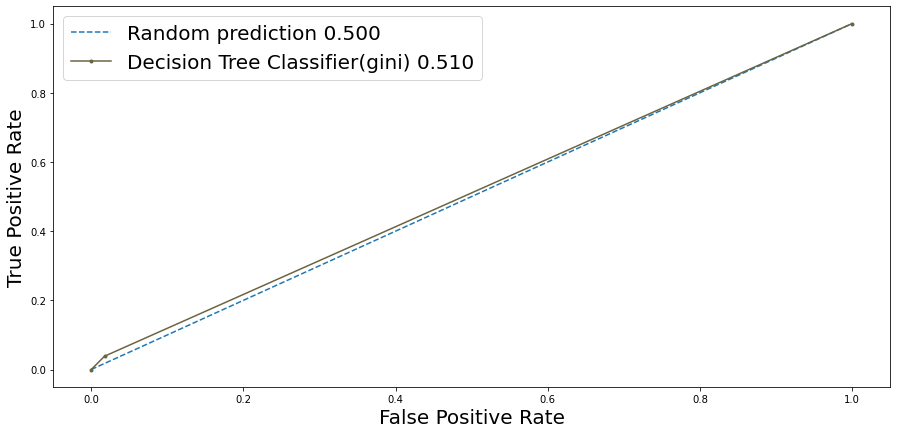

In [86]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = dt_gini.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score4.append(rfc_auc)
print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('Decision Tree (gini): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='Decision Tree Classifier(gini) %0.3f' % rfc_auc, color="#6B6440")


# axis labels
plt.xlabel('False Positive Rate',fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# criterion=entropy

In [87]:
dt_entropy=DecisionTreeClassifier()
dt_entropy.fit(X_train_bs, y_train_bs)

DecisionTreeClassifier()

Precision  0.008522727272727272
F1 score  0.013953488372093023
Recall  0.038461538461538464
Accuracy  0.9815041005060199
Balanced Accuracy  0.5115926706577149
Matthews Correlation Coefficient 0.010980181744571969


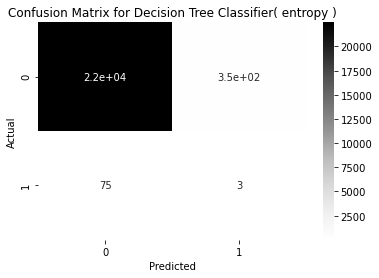

In [88]:
y_pred_entropy=dt_entropy.predict(X_test)

precision=precision_score(y_test, y_pred_entropy)
p_score4.append(precision)

f1=f1_score(y_test, y_pred_entropy)
f_score4.append(f1)

accuracy=accuracy_score(y_test, y_pred_entropy)


recall=recall_score(y_test, y_pred_entropy)
r_score4.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_entropy)
m_score4.append(mcc)

bac=balanced_accuracy_score (y_test, y_pred_entropy)
b_score4.append(bac)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)
print("Matthews Correlation Coefficient", mcc)

cm=confusion_matrix(y_test,y_pred_entropy, labels=[0,1])
sns.heatmap(cm, cmap="Greys",annot=True)
plt.title("Confusion Matrix for Decision Tree Classifier( entropy )")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Random predcition: ROC AUC=0.500
Decision(entropy): ROC AUC=0.512


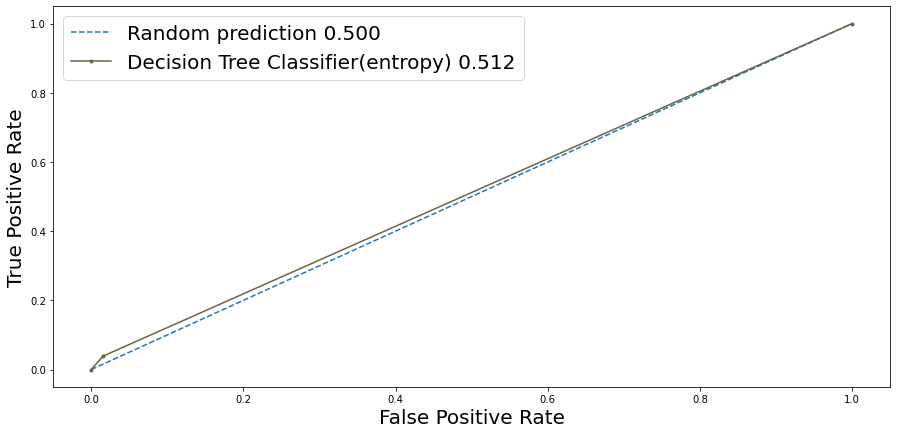

In [89]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = dt_entropy.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score4.append(rfc_auc)
print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('Decision(entropy): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='Decision Tree Classifier(entropy) %0.3f' % rfc_auc, color="#6B6440")


# axis labels
plt.xlabel('False Positive Rate',fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# criterion=log_loss

In [90]:
dt_log_loss=DecisionTreeClassifier()
dt_log_loss.fit(X_train_bs, y_train_bs)

DecisionTreeClassifier()

Precision  0.010554089709762533
F1 score  0.0175054704595186
Recall  0.05128205128205128
Accuracy  0.9804135403943466
Balanced Accuracy  0.5174338996671134
Matthews Correlation Coefficient 0.015923267855280532


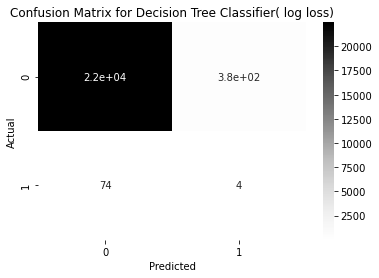

In [91]:
y_pred_log_loss=dt_log_loss.predict(X_test)

precision=precision_score(y_test, y_pred_log_loss)
p_score4.append(precision)

f1=f1_score(y_test, y_pred_log_loss)
f_score4.append(f1)

accuracy=accuracy_score(y_test, y_pred_log_loss)


recall=recall_score(y_test, y_pred_log_loss)
r_score4.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_log_loss)
m_score4.append(mcc)

bac=balanced_accuracy_score (y_test, y_pred_log_loss)
b_score4.append(bac)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)
print("Matthews Correlation Coefficient", mcc)

cm=confusion_matrix(y_test,y_pred_log_loss, labels=[0,1])
sns.heatmap(cm, cmap="Greys",annot=True)
plt.title("Confusion Matrix for Decision Tree Classifier( log loss)")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Random predcition: ROC AUC=0.500
Decision(log_loss)): ROC AUC=0.517


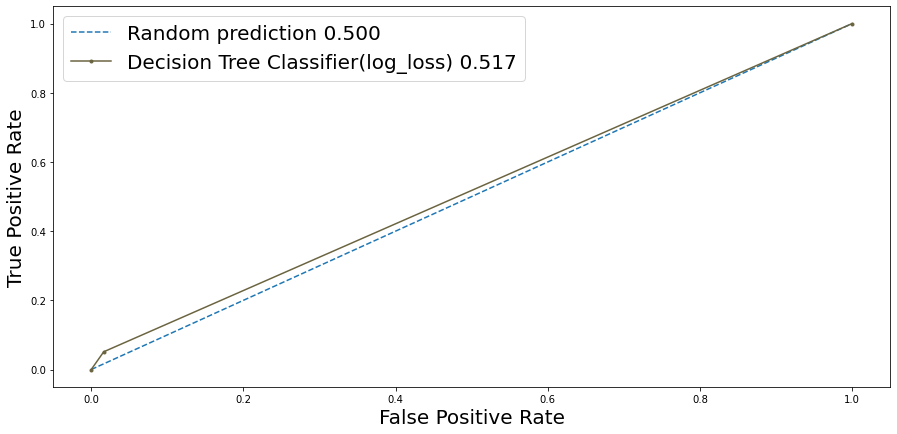

In [92]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = dt_log_loss.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score4.append(rfc_auc)
print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('Decision(log_loss)): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='Decision Tree Classifier(log_loss) %0.3f' % rfc_auc, color="#6B6440")


# axis labels
plt.xlabel('False Positive Rate',fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

In [93]:
algo4=["gini","entropy","log loss"]
performance_df4 = pd.DataFrame(
{'Decision Tree Classifier ':algo4,'Balanced Accuracy':b_score4,"F1 Score":f_score4,'Precision':p_score4, "Recall":r_score4, "ROC AUC":a_score4,
 "Matthews Correlation Coefficient":m_score4
})

In [94]:
performance_df4

,Decision Tree Classifier,Balanced Accuracy,F1 Score,Precision,Recall,ROC AUC,Matthews Correlation Coefficient
0,gini,0.510477,0.012474,0.007444,0.038462,0.510477,0.009284
1,entropy,0.511593,0.013953,0.008523,0.038462,0.511593,0.010980
2,log loss,0.517434,0.017505,0.010554,0.051282,0.517434,0.015923


# Random Forest

In [95]:
p_score5=[]
f_score5=[]
r_score5=[]
b_score5=[]
a_score5=[]
m_score5=[]

# criterion=gini

In [96]:
rfc_gini=RandomForestClassifier(criterion="gini")
rfc_gini.fit(X_train_bs,y_train_bs)

RandomForestClassifier()

Precision  0.5
F1 score  0.048780487804878044
Recall  0.02564102564102564
Accuracy  0.9965974524515792
Balanced accuracy 0.5127767414819853


Text(33.0, 0.5, 'Actual')

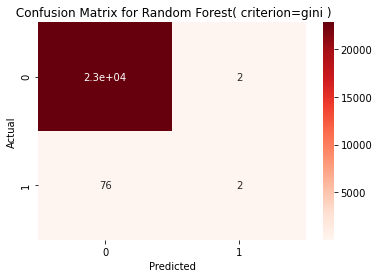

In [97]:
y_pred_gini=rfc_gini.predict(X_test)


precision=precision_score(y_test, y_pred_gini)
p_score5.append(precision)

f1=f1_score(y_test, y_pred_gini)
f_score5.append(f1)

accuracy=accuracy_score(y_test, y_pred_gini)

recall=recall_score(y_test, y_pred_gini)
r_score5.append(recall)

bac=balanced_accuracy_score (y_test, y_pred_gini)
b_score5.append(bac)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_gini)
m_score5.append(mcc)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced accuracy", bac)



cm=confusion_matrix(y_test,y_pred_gini, labels=[0,1])
sns.heatmap(cm, cmap="Reds",annot=True)
plt.title(" Confusion Matrix for Random Forest( criterion=gini )")
plt.xlabel("Predicted")
plt.ylabel("Actual")

In [98]:
print("Test {}".format(Counter(y_test)))
print("Prediction {}".format(Counter(y_pred_gini)))

Test Counter({0.0: 22846, 1.0: 78})
Prediction Counter({0.0: 22920, 1.0: 4})


Random Prediction: ROC AUC=0.500
Random Forest Classifier(criterion=gini): ROC AUC=0.769


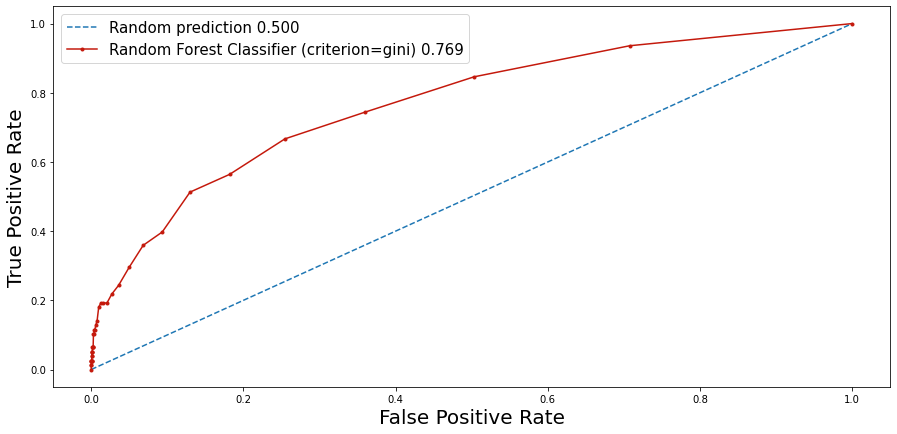

In [99]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = rfc_gini.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score5.append(rfc_auc)

print('Random Prediction: ROC AUC=%.3f' % (ns_auc))
print('Random Forest Classifier(criterion=gini): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='Random Forest Classifier (criterion=gini) %0.3f' % rfc_auc, color="#C4190C")


# axis labels
plt.xlabel('False Positive Rate', fontsize=20)
plt.ylabel('True Positive Rate', fontsize=20)
# show the legend
plt.legend(fontsize=15)
# show the plot
plt.show()

# criterion=entropy

In [100]:
rfc_entropy=RandomForestClassifier(criterion="entropy")
rfc_entropy.fit(X_train_bs,y_train_bs)

RandomForestClassifier(criterion='entropy')

Precision  0.3333333333333333
F1 score  0.047619047619047616
Recall  0.02564102564102564
Accuracy  0.9965102076426453
Balaanced accuracy 0.5127329701434578


Text(33.0, 0.5, 'Actual')

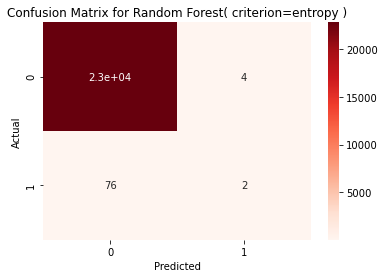

In [101]:
y_pred_entropy=rfc_entropy.predict(X_test)


precision=precision_score(y_test, y_pred_entropy)
p_score5.append(precision)

f1=f1_score(y_test, y_pred_entropy)
f_score5.append(f1)

accuracy=accuracy_score(y_test, y_pred_entropy)

recall=recall_score(y_test, y_pred_entropy)
r_score5.append(recall)

bac=balanced_accuracy_score (y_test, y_pred_entropy)
b_score5.append(bac)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_entropy)
m_score5.append(mcc)


print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balaanced accuracy", bac)



cm=confusion_matrix(y_test,y_pred_entropy, labels=[0,1])
sns.heatmap(cm, cmap="Reds",annot=True)
plt.title("Confusion Matrix for Random Forest( criterion=entropy )")
plt.xlabel("Predicted")
plt.ylabel("Actual")

Random Guess: ROC AUC=0.500
Random Forest Classifier(criterion=entropy): ROC AUC=0.731


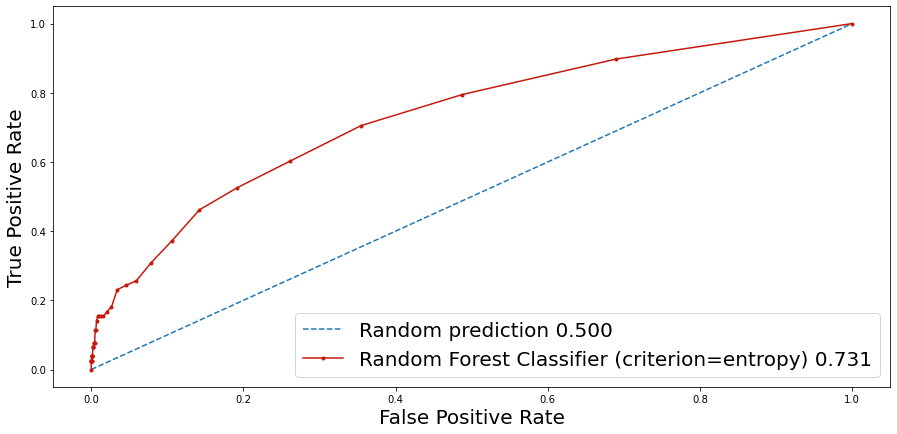

In [102]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = rfc_entropy.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score5.append(rfc_auc)

print('Random Guess: ROC AUC=%.3f' % (ns_auc))
print('Random Forest Classifier(criterion=entropy): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='Random Forest Classifier (criterion=entropy) %0.3f' % rfc_auc, color="#C4190C")


# axis labels
plt.xlabel('False Positive Rate', fontsize=20)
plt.ylabel('True Positive Rate', fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# criterion=log_loss

In [103]:
rfc_log_loss=RandomForestClassifier(criterion="log_loss")
rfc_log_loss.fit(X_train_bs,y_train_bs)

RandomForestClassifier(criterion='log_loss')

Precision  0.3333333333333333
F1 score  0.047619047619047616
Recall  0.02564102564102564
Accuracy  0.9965102076426453


Text(33.0, 0.5, 'Actual')

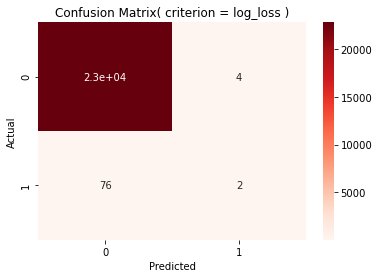

In [104]:
y_pred_log_loss=rfc_log_loss.predict(X_test)


precision=precision_score(y_test, y_pred_log_loss)
p_score5.append(precision)

f1=f1_score(y_test, y_pred_log_loss)
f_score5.append(f1)

accuracy=accuracy_score(y_test, y_pred_log_loss)


recall=recall_score(y_test, y_pred_log_loss)
r_score5.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_log_loss)
m_score5.append(mcc)

bac=balanced_accuracy_score (y_test, y_pred_log_loss)
b_score5.append(bac)


print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)



cm=confusion_matrix(y_test,y_pred_log_loss, labels=[0,1])
sns.heatmap(cm, cmap="Reds",annot=True)
plt.title("Confusion Matrix( criterion = log_loss )")
plt.xlabel("Predicted")
plt.ylabel("Actual")

Random Guess: ROC AUC=0.500
Random Forest Classifier(criterion=entropy): ROC AUC=0.731


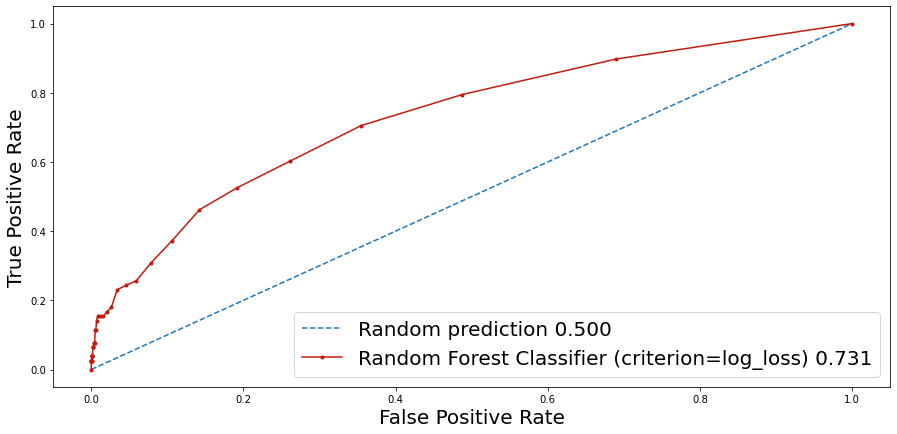

In [105]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = rfc_entropy.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score5.append(rfc_auc)
print('Random Guess: ROC AUC=%.3f' % (ns_auc))
print('Random Forest Classifier(criterion=entropy): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='Random Forest Classifier (criterion=log_loss) %0.3f' % rfc_auc, color="#C4190C")


# axis labels
plt.xlabel('False Positive Rate', fontsize=20)
plt.ylabel('True Positive Rate', fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

In [106]:
algo5=['gini', 'entropy', 'log_loss']
performance_df5 = pd.DataFrame(
{'Random Forest Classifers (Ccriterion) ':algo5,'Balanced Accuracy(BAC)':b_score5,"F1 Score":f_score5,'Precision':p_score5, "Recall":r_score5, "ROC AUC":a_score5,
 "Matthews Correlation Coefficient(MCC)":m_score5
})

In [107]:
performance_df5

,Random Forest Classifers (Ccriterion),Balanced Accuracy(BAC),F1 Score,Precision,Recall,ROC AUC,Matthews Correlation Coefficient(MCC)
0,gini,0.512777,0.048780,0.500000,0.025641,0.768531,0.112659
1,entropy,0.512733,0.047619,0.333333,0.025641,0.731054,0.091674
2,log_loss,0.512733,0.047619,0.333333,0.025641,0.731054,0.091674


# Gradient Descent

In [108]:
p_score6=[]
f_score6=[]
r_score6=[]
b_score6=[]
a_score6=[]
m_score6=[]

# loss=log_loss

In [109]:

gbt_log_loss=GradientBoostingClassifier(n_estimators=50, random_state=2)
gbt_log_loss.fit(X_train_bs, y_train_bs)

GradientBoostingClassifier(n_estimators=50, random_state=2)

Precision  0.005699254712845244
F1 score  0.011021619330224672
Recall  0.16666666666666666
Accuracy  0.8982289303786425
Balanced Accuracy  0.5336966354431119
Matthews Correlation Coefficient 0.01311051868236211


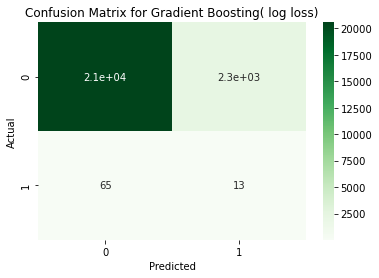

In [110]:
y_pred_log_loss=gbt_log_loss.predict(X_test)

precision=precision_score(y_test, y_pred_log_loss)
p_score6.append(precision)

f1=f1_score(y_test, y_pred_log_loss)
f_score6.append(f1)

accuracy=accuracy_score(y_test, y_pred_log_loss)


recall=recall_score(y_test, y_pred_log_loss)
r_score6.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_log_loss)
m_score6.append(mcc)

bac=balanced_accuracy_score (y_test, y_pred_log_loss)
b_score6.append(bac)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)
print("Matthews Correlation Coefficient", mcc)

cm=confusion_matrix(y_test,y_pred_log_loss, labels=[0,1])
sns.heatmap(cm, cmap="Greens",annot=True)
plt.title("Confusion Matrix for Gradient Boosting( log loss)")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Random predcition: ROC AUC=0.500
Gradient Boosting (log_loss)): ROC AUC=0.675


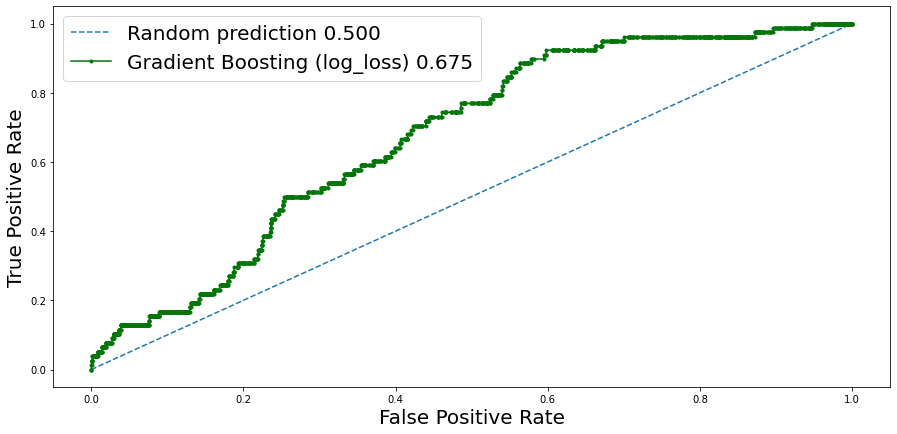

In [111]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = gbt_log_loss.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score6.append(rfc_auc)
print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('Gradient Boosting (log_loss)): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='Gradient Boosting (log_loss) %0.3f' % rfc_auc, color="#007508")


# axis labels
plt.xlabel('False Positive Rate',fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# loss=deviance

In [112]:
gbt_deviance=GradientBoostingClassifier(n_estimators=50, random_state=2)
gbt_deviance.fit(X_train_bs, y_train_bs)

GradientBoostingClassifier(n_estimators=50, random_state=2)

Precision  0.005699254712845244
F1 score  0.011021619330224672
Recall  0.16666666666666666
Accuracy  0.8982289303786425
Balanced Accuracy  0.5336966354431119
Matthews Correlation Coefficient 0.01311051868236211


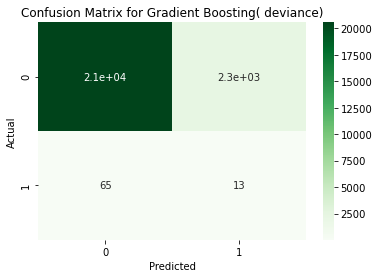

In [113]:
y_pred_deviance=gbt_deviance.predict(X_test)

precision=precision_score(y_test, y_pred_deviance)
p_score6.append(precision)

f1=f1_score(y_test, y_pred_deviance)
f_score6.append(f1)

accuracy=accuracy_score(y_test, y_pred_deviance)


recall=recall_score(y_test, y_pred_deviance)
r_score6.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_deviance)
m_score6.append(mcc)

bac=balanced_accuracy_score (y_test, y_pred_deviance)
b_score6.append(bac)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)
print("Matthews Correlation Coefficient", mcc)

cm=confusion_matrix(y_test,y_pred_log_loss, labels=[0,1])
sns.heatmap(cm, cmap="Greens",annot=True)
plt.title("Confusion Matrix for Gradient Boosting( deviance)")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Random predcition: ROC AUC=0.500
Gradient Boosting (deviance): ROC AUC=0.675


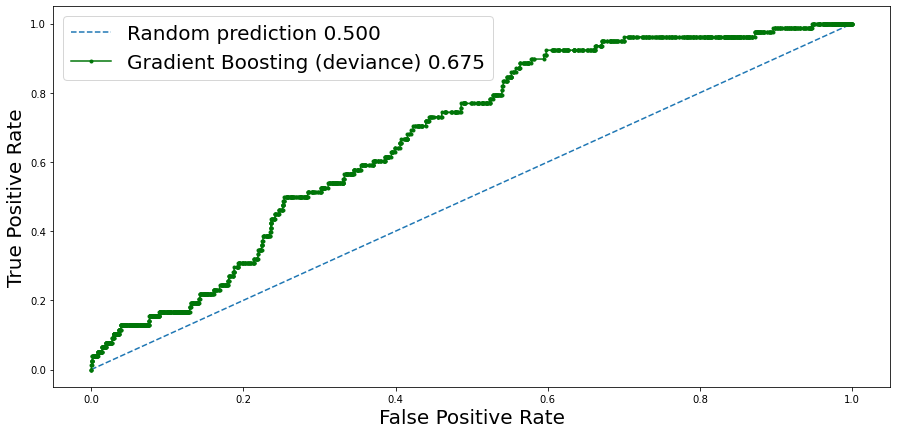

In [114]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = gbt_deviance.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score6.append(rfc_auc)
print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('Gradient Boosting (deviance): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='Gradient Boosting (deviance) %0.3f' % rfc_auc, color="#007508")


# axis labels
plt.xlabel('False Positive Rate',fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# loss=exponential

In [115]:
gbt_exponential=GradientBoostingClassifier(n_estimators=50, random_state=2)
gbt_exponential.fit(X_train_bs, y_train_bs)

GradientBoostingClassifier(n_estimators=50, random_state=2)

Precision  0.005699254712845244
F1 score  0.011021619330224672
Recall  0.16666666666666666
Accuracy  0.8982289303786425
Balanced Accuracy  0.5336966354431119
Matthews Correlation Coefficient 0.01311051868236211


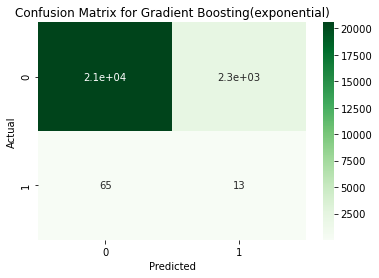

In [116]:
y_pred_exponential=gbt_deviance.predict(X_test)

precision=precision_score(y_test, y_pred_exponential)
p_score6.append(precision)

f1=f1_score(y_test, y_pred_exponential)
f_score6.append(f1)

accuracy=accuracy_score(y_test, y_pred_exponential)


recall=recall_score(y_test, y_pred_exponential)
r_score6.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_exponential)
m_score6.append(mcc)

bac=balanced_accuracy_score (y_test, y_pred_exponential)
b_score6.append(bac)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)
print("Matthews Correlation Coefficient", mcc)

cm=confusion_matrix(y_test,y_pred_log_loss, labels=[0,1])
sns.heatmap(cm, cmap="Greens",annot=True)
plt.title("Confusion Matrix for Gradient Boosting(exponential)")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Random predcition: ROC AUC=0.500
Gradient Boosting (exponential): ROC AUC=0.675


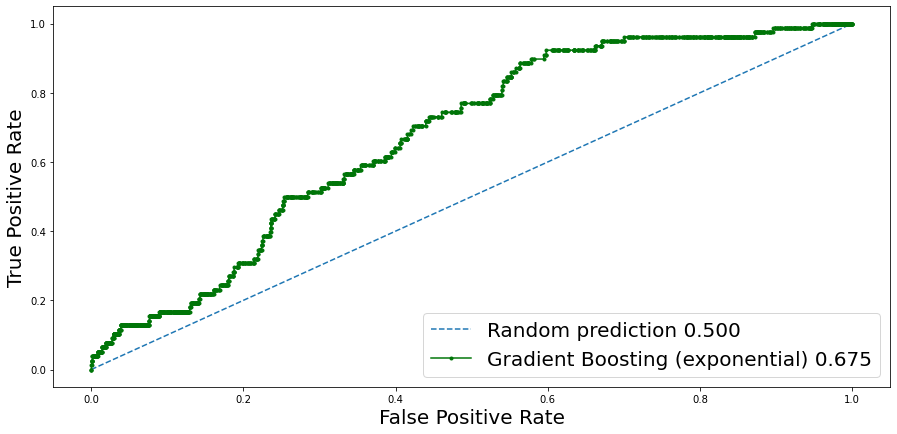

In [117]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = gbt_exponential.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score6.append(rfc_auc)
print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('Gradient Boosting (exponential): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='Gradient Boosting (exponential) %0.3f' % rfc_auc, color="#007508")


# axis labels
plt.xlabel('False Positive Rate',fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

In [118]:
algo6=["log loss","deviance","exponential"]
performance_df6 = pd.DataFrame(
{'Gradient Boosting (loss) ':algo6,'Balanced Accuracy':b_score6,"F1 Score":f_score6,'Precision':p_score6, "Recall":r_score6, "ROC AUC":a_score6,
 "Matthews Correlation Coefficient":m_score6
})

In [119]:
performance_df6

,Gradient Boosting (loss),Balanced Accuracy,F1 Score,Precision,Recall,ROC AUC,Matthews Correlation Coefficient
0,log loss,0.533697,0.011022,0.005699,0.166667,0.675035,0.013111
1,deviance,0.533697,0.011022,0.005699,0.166667,0.675035,0.013111
2,exponential,0.533697,0.011022,0.005699,0.166667,0.675035,0.013111


# XGBoost

In [120]:
p_score7=[]
f_score7=[]
r_score7=[]
b_score7=[]
a_score7=[]
m_score7=[]

# booster=gbtree

In [121]:
xgb_gbtree=XGBClassifier(booster="gbtree")
xgb_gbtree.fit(X_train_bs, y_train_bs)

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=0, gpu_id=-1,
              grow_policy='depthwise', importance_type=None,
              interaction_constraints='', learning_rate=0.300000012,
              max_bin=256, max_cat_threshold=64, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
              missing=nan, monotone_constraints='()', n_estimators=100,
              n_jobs=0, num_parallel_tree=1, predictor='auto', random_state=0, ...)

Precision  0.07692307692307693
F1 score  0.05128205128205129
Recall  0.038461538461538464
Accuracy  0.9951579131041703
Balanced Accuracy  0.5184428851372737


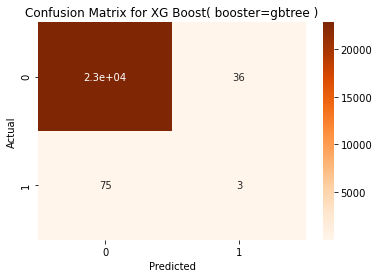

In [122]:
y_pred_gbtree=xgb_gbtree.predict(X_test)

precision=precision_score(y_test, y_pred_gbtree)
p_score7.append(precision)

f1=f1_score(y_test, y_pred_gbtree)
f_score7.append(f1)


accuracy=accuracy_score(y_test, y_pred_gbtree)
recall=recall_score(y_test, y_pred_gbtree)
r_score7.append(recall)


bac=balanced_accuracy_score (y_test, y_pred_gbtree)
b_score7.append(bac)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_gbtree)
m_score7.append(mcc)


print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)

cm=confusion_matrix(y_test,y_pred_gbtree, labels=[0,1])
sns.heatmap(cm, cmap="Oranges",annot=True)
plt.title("Confusion Matrix for XG Boost( booster=gbtree )")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Random predcition: ROC AUC=0.500
XGBoost Classifier(booster=gbtree): ROC AUC=0.603


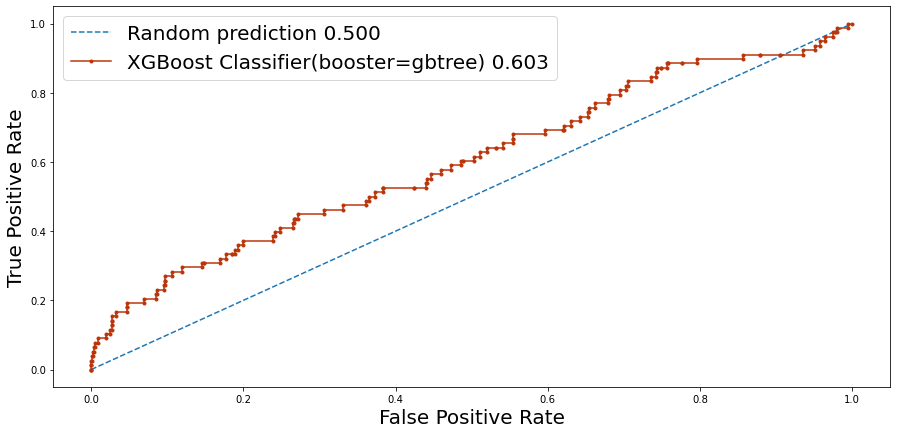

In [123]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = xgb_gbtree.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score7.append(rfc_auc)

print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('XGBoost Classifier(booster=gbtree): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='XGBoost Classifier(booster=gbtree) %0.3f' % rfc_auc, color="#BB350B")


# axis labels
plt.xlabel('False Positive Rate', fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# booster=gblinear

In [124]:
xgb_gblinear=XGBClassifier(booster="gblinear")
xgb_gblinear.fit(X_train_bs, y_train_bs)

XGBClassifier(base_score=0.5, booster='gblinear', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=-1, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.5, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=0, num_parallel_tree=None,
              predictor=None, random_state=0, ...)

Precision  0.005140716215038773
F1 score  0.010212029424491563
Recall  0.7564102564102564
Accuracy  0.5010905601116734
Balanced Accuracy  0.628314556551447


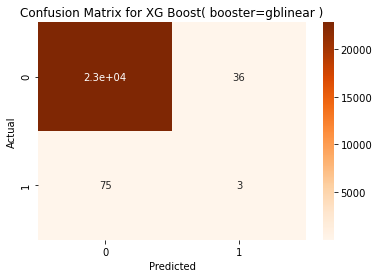

In [125]:
y_pred_gblinear=xgb_gblinear.predict(X_test)


precision=precision_score(y_test, y_pred_gblinear)
p_score7.append(precision)

f1=f1_score(y_test, y_pred_gblinear)
f_score7.append(f1)

accuracy=accuracy_score(y_test, y_pred_gblinear)


recall=recall_score(y_test, y_pred_gblinear)
r_score7.append(recall)

bac=balanced_accuracy_score (y_test, y_pred_gblinear)
b_score7.append(bac)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_gblinear)
m_score7.append(mcc)


print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)



cm=confusion_matrix(y_test,y_pred_gbtree, labels=[0,1])
sns.heatmap(cm, cmap="Oranges",annot=True)
plt.title("Confusion Matrix for XG Boost( booster=gblinear )")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Random predcition: ROC AUC=0.500
XGBoost Classifier(booster=gblinear): ROC AUC=0.650


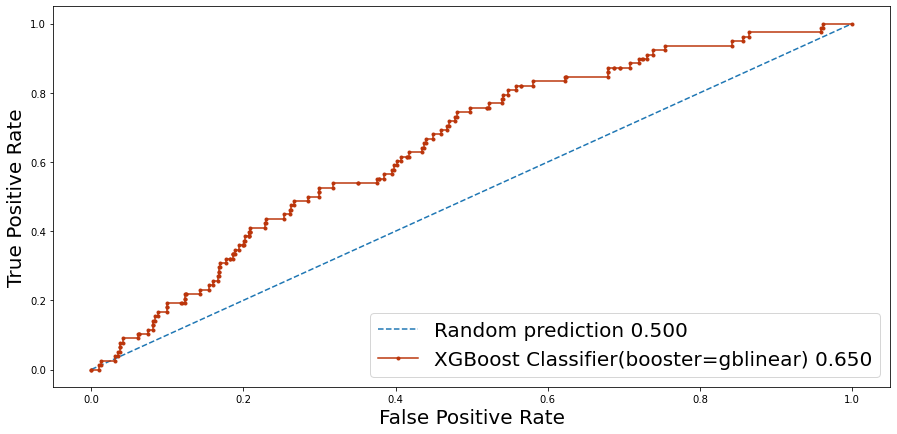

In [126]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = xgb_gblinear.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score7.append(rfc_auc)

print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('XGBoost Classifier(booster=gblinear): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='XGBoost Classifier(booster=gblinear) %0.3f' % rfc_auc, color="#BB350B")


# axis labels
plt.xlabel('False Positive Rate', fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# booster=dart

In [127]:
xgb_dart=XGBClassifier(booster="dart")
xgb_dart.fit(X_train_bs, y_train_bs)

XGBClassifier(base_score=0.5, booster='dart', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=0, gpu_id=-1,
              grow_policy='depthwise', importance_type=None,
              interaction_constraints='', learning_rate=0.300000012,
              max_bin=256, max_cat_threshold=64, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
              missing=nan, monotone_constraints='()', n_estimators=100,
              n_jobs=0, num_parallel_tree=1, predictor='auto', random_state=0, ...)

Precision  0.07692307692307693
F1 score  0.05128205128205129
Recall  0.038461538461538464
Accuracy  0.9951579131041703
Balanced Accuracy  0.5184428851372737


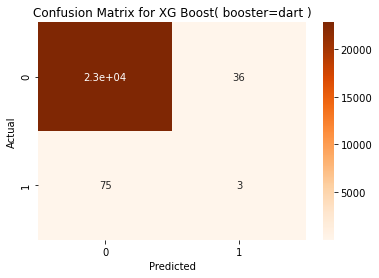

In [128]:
y_pred_dart=xgb_dart.predict(X_test)

precision=precision_score(y_test, y_pred_dart)
p_score7.append(precision)

f1=f1_score(y_test, y_pred_dart)
f_score7.append(f1)

accuracy=accuracy_score(y_test, y_pred_dart)


recall=recall_score(y_test, y_pred_dart)
r_score7.append(recall)

bac=balanced_accuracy_score (y_test, y_pred_dart)
b_score7.append(bac)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_dart)
m_score7.append(mcc)


print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)


cm=confusion_matrix(y_test,y_pred_dart, labels=[0,1])
sns.heatmap(cm, cmap="Oranges",annot=True)
plt.title("Confusion Matrix for XG Boost( booster=dart )")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Random predcition: ROC AUC=0.500
XGBoost Classifier(booster=dart): ROC AUC=0.603


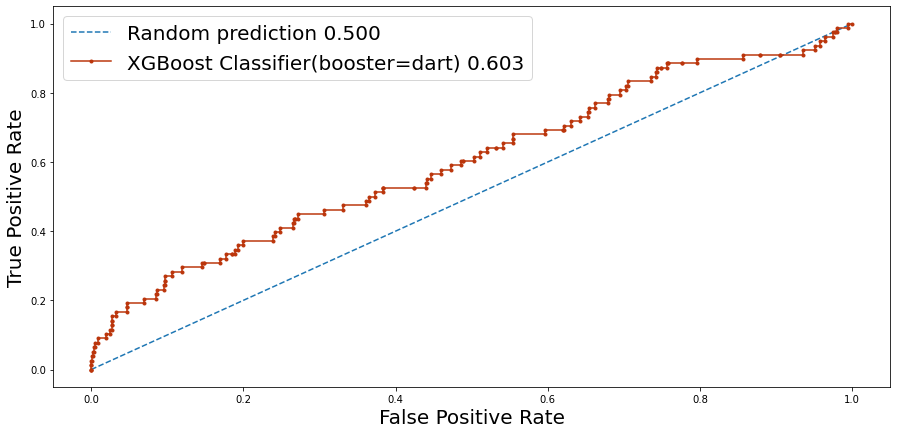

In [129]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = xgb_dart.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score7.append(rfc_auc)

print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('XGBoost Classifier(booster=dart): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='XGBoost Classifier(booster=dart) %0.3f' % rfc_auc, color="#BB350B")


# axis labels
plt.xlabel('False Positive Rate', fontsize=20)
plt.ylabel('True Positive Rate', fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

In [130]:
algo7=["gbtree","gblinear","dart"]
performance_df7 = pd.DataFrame(
{'XG Boost (booster) ':algo7,'Balanced Accuracy':b_score7,"F1 Score":f_score7,'Precision':p_score7, "Recall":r_score7, "ROC AUC":a_score7,
 "Matthews Correlation Coefficient":m_score7
})

In [131]:
performance_df7

,XG Boost (booster),Balanced Accuracy,F1 Score,Precision,Recall,ROC AUC,Matthews Correlation Coefficient
0,gbtree,0.518443,0.051282,0.076923,0.038462,0.602688,0.052120
1,gblinear,0.628315,0.010212,0.005141,0.756410,0.649748,0.029888
2,dart,0.518443,0.051282,0.076923,0.038462,0.602688,0.052120


# ADABoost

In [132]:
p_score8=[]
f_score8=[]
r_score8=[]
b_score8=[]
a_score8=[]
m_score8=[]

# algorithm=SAMME

In [133]:
abc_samme=AdaBoostClassifier(algorithm="SAMME")
abc_samme.fit(X_train_bs, y_train_bs)

AdaBoostClassifier(algorithm='SAMME')

Precision  0.004473438956197577
F1 score  0.008818666176740767
Recall  0.3076923076923077
Accuracy  0.7646571279008899
Balanced Accuracy  0.5369547943083792


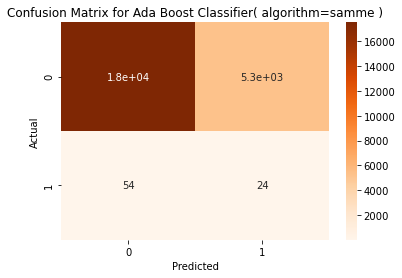

In [134]:
y_pred_sammec=abc_samme.predict(X_test)

precision=precision_score(y_test, y_pred_sammec)
p_score8.append(precision)

f1=f1_score(y_test, y_pred_sammec)
f_score8.append(f1)

accuracy=accuracy_score(y_test, y_pred_sammec)

recall=recall_score(y_test, y_pred_sammec)
r_score8.append(recall)

bac=balanced_accuracy_score (y_test, y_pred_sammec)
b_score8.append(bac)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_sammec)
m_score8.append(mcc)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)

cm=confusion_matrix(y_test,y_pred_sammec, labels=[0,1])
sns.heatmap(cm, cmap="Oranges",annot=True)
plt.title("Confusion Matrix for Ada Boost Classifier( algorithm=samme )")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Random predcition: ROC AUC=0.500
Ada Boost Classifier(algorithm=samme): ROC AUC=0.677


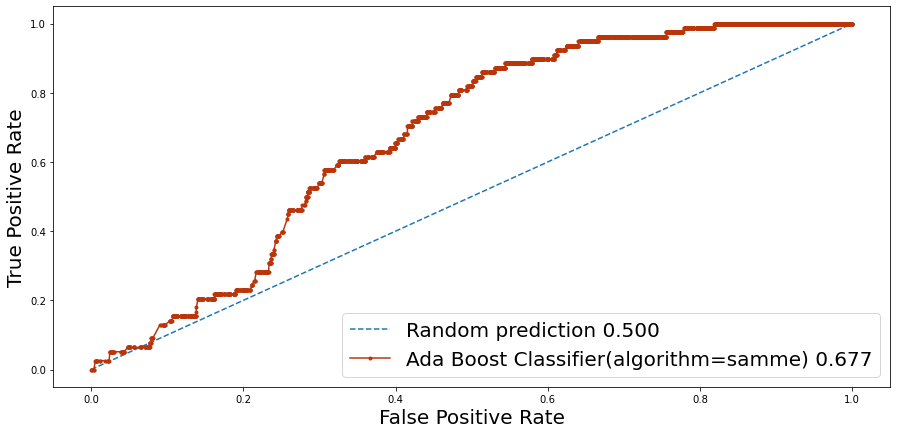

In [135]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = abc_samme.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score8.append(rfc_auc)
print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('Ada Boost Classifier(algorithm=samme): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='Ada Boost Classifier(algorithm=samme) %0.3f' % rfc_auc, color="#BB350B")


# axis labels
plt.xlabel('False Positive Rate',fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

# algorithm=SAMME.R

In [136]:
abc_sammer=AdaBoostClassifier(algorithm="SAMME.R")
abc_sammer.fit(X_train_bs, y_train_bs)

AdaBoostClassifier()

Precision  0.0038510911424903724
F1 score  0.007514088916718848
Recall  0.15384615384615385
Accuracy  0.8617169778398185
Balanced Accuracy  0.5089899595283469


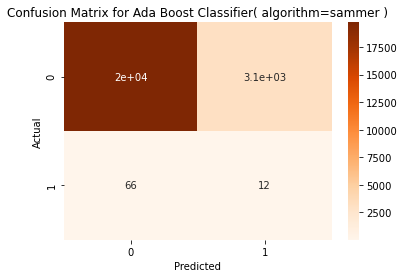

In [137]:
y_pred_sammer=abc_sammer.predict(X_test)

precision=precision_score(y_test, y_pred_sammer)
p_score8.append(precision)

f1=f1_score(y_test, y_pred_sammer)
f_score8.append(f1)

accuracy=accuracy_score(y_test, y_pred_sammer)

recall=recall_score(y_test, y_pred_sammer)
r_score8.append(recall)

bac=balanced_accuracy_score (y_test, y_pred_sammer)
b_score8.append(bac)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_sammer)
m_score8.append(mcc)

print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)
print("Balanced Accuracy ",bac)

cm=confusion_matrix(y_test,y_pred_sammer, labels=[0,1])
sns.heatmap(cm, cmap="Oranges",annot=True)
plt.title("Confusion Matrix for Ada Boost Classifier( algorithm=sammer )")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

Random predcition: ROC AUC=0.500
Ada Boost Classifier(algorithm=samme): ROC AUC=0.638


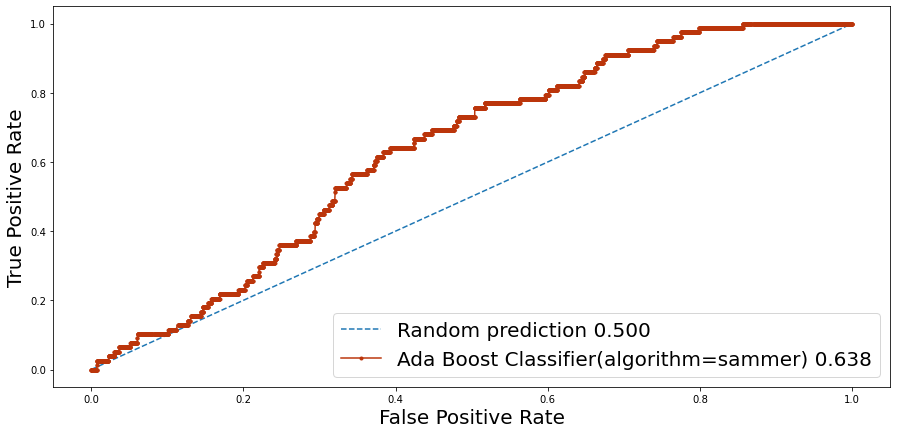

In [138]:
#Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
rfc_probs = abc_sammer.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
rfc_probs = rfc_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
rfc_auc = roc_auc_score(y_test, rfc_probs)
a_score8.append(rfc_auc)
print('Random predcition: ROC AUC=%.3f' % (ns_auc))
print('Ada Boost Classifier(algorithm=samme): ROC AUC=%.3f' %(rfc_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
rfc_fpr, rfc_tpr, _ = roc_curve(y_test, rfc_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(rfc_fpr, rfc_tpr, marker='.', label='Ada Boost Classifier(algorithm=sammer) %0.3f' % rfc_auc, color="#BB350B")


# axis labels
plt.xlabel('False Positive Rate',fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

In [139]:
algo8=("samme","sammer")
performance_df8 = pd.DataFrame(
{' Ada Boost clasiifer(Algorithm)':algo8,'Balanced Accuracy':b_score8,"F1 Score":f_score8,
 'Precision':p_score8, "Recall":r_score8, "ROC AUC":a_score8, "Matthews Correlation Coefficient":m_score8
})

In [140]:
performance_df8

,Ada Boost clasiifer(Algorithm),Balanced Accuracy,F1 Score,Precision,Recall,ROC AUC,Matthews Correlation Coefficient
0,samme,0.536955,0.008819,0.004473,0.307692,0.677471,0.010165
1,sammer,0.508990,0.007514,0.003851,0.153846,0.637894,0.003055


# votersclassifier

In [181]:
p_score9=[]
f_score9=[]
r_score9=[]
b_score9=[]
a_score9=[]
m_score9=[]

In [182]:
# using the above classifiers which performed best in their repective groups as estimators 
estimators=[('adaboost',abc_samme),('XGBoost',xgb_gbtree),('gradient booster',gbt_log_loss),('random forest',rfc_gini),
            ('decision tree',dt_log_loss),('naive bayes',mnb ),('kmeans',knc_brute ),('logistic regression',lrc_newton_cholesky)
           ]

# voting=soft

In [183]:
# implemeting soft voting 
vc = VotingClassifier(estimators=estimators,voting='soft')

In [184]:
vc.fit(X_train_bs, y_train_bs)

VotingClassifier(estimators=[('adaboost',
                              AdaBoostClassifier(algorithm='SAMME')),
                             ('XGBoost',
                              XGBClassifier(base_score=0.5, booster='gbtree',
                                            callbacks=None, colsample_bylevel=1,
                                            colsample_bynode=1,
                                            colsample_bytree=1,
                                            early_stopping_rounds=None,
                                            enable_categorical=False,
                                            eval_metric=None,
                                            feature_types=None, gamma=0,
                                            gpu_id=-1, grow_policy='depthwise',
                                            importance...
                                            predictor='auto', random_state=0, ...)),
                             ('gradient booster',
                              GradientBoostingClassifier(n_estimators=50,
                                                         random_state=2)),
                             ('random forest', RandomForestClassifier()),
                             ('decision tree', DecisionTreeClassifier()),
                             ('naive bayes', MultinomialNB()),
                             ('kmeans',
                              KNeighborsClassifier(algorithm='brute')),
                             ('logistic regression',
                              LogisticRegression(solver='newton-cholesky'))],
                 voting='soft')

Precision  0.0989010989010989
F1 score  0.10650887573964496
Recall  0.11538461538461539
Accuracy  0.9934130169254929


Text(33.0, 0.5, 'Actual')

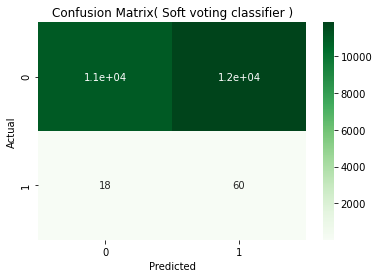

In [185]:
y_pred_vc=vc.predict(X_test)


precision=precision_score(y_test, y_pred_vc)
p_score9.append(precision)

f1=f1_score(y_test, y_pred_vc)
f_score9.append(f1)

accuracy=accuracy_score(y_test, y_pred_vc)


recall=recall_score(y_test, y_pred_vc)
r_score9.append(recall)

#calculate Matthews correlation coefficient
mcc=matthews_corrcoef(y_test, y_pred_vc)
m_score9.append(mcc)

bac=balanced_accuracy_score (y_test, y_pred_vc)
b_score9.append(bac)


print("Precision ", precision)
print("F1 score ", f1)
print("Recall ",recall)
print("Accuracy ",accuracy)



cm=confusion_matrix(y_test,y_pred_newton_cholesky, labels=[0,1])
sns.heatmap(cm, cmap="Greens",annot=True)
plt.title("Confusion Matrix( Soft voting classifier )")
plt.xlabel("Predicted")
plt.ylabel("Actual")





No Skill: ROC AUC=0.500
Logistic: ROC AUC=0.707


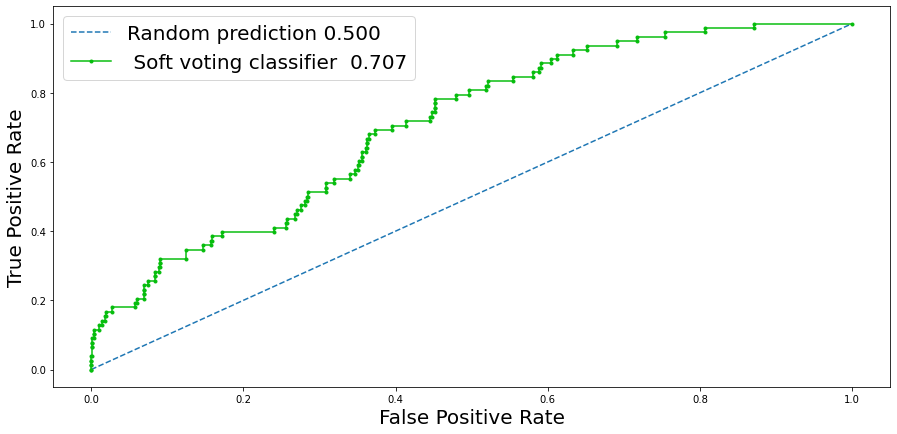

In [186]:
# Prediction probabilities 
#generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(y_test))]

#keep probabilities for the positive outcome only
lr_probs = vc.predict_proba(X_test)

#Probabilities for the positive outcome is kept.
lr_probs = lr_probs[:, 1]


# calculate AUC scores
ns_auc = roc_auc_score(y_test, ns_probs)
lr_auc = roc_auc_score(y_test, lr_probs)
a_score9.append(lr_auc)

print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('Logistic: ROC AUC=%.3f' %(lr_auc))

# calculate roc curves
ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)

# plot the roc curve for the model
plt.figure(figsize=(15,7))

plt.plot(ns_fpr, ns_tpr, linestyle='--', label='Random prediction %0.3f' % ns_auc)
plt.plot(lr_fpr, lr_tpr, marker='.', label=' Soft voting classifier  %0.3f' % lr_auc, color="#06BD0D")


# axis labels
plt.xlabel('False Positive Rate',fontsize=20)
plt.ylabel('True Positive Rate',fontsize=20)
# show the legend
plt.legend(fontsize=20)
# show the plot
plt.show()

In [163]:
pd.DataFrame({"Soft voting classifier":['Balanced Accuracy(BAC)','F1 Score','Precision','Recall','ROC AUC',
                             'Matthews Correlation Coefficient(MCC)'],
              "Values":[b_score9,f_score9,p_score9,r_score9,a_score9,m_score9]
             })

,Soft voting classifier,Values
0,Balanced Accuracy(BAC),[0.5556788261200412]
1,F1 Score,[0.1005586592178771]
2,Precision,[0.0891089108910891]
3,Recall,[0.11538461538461539]
4,ROC AUC,[0.7051035136039076]
5,Matthews Correlation Coefficient(MCC),[0.09790962826119318]


In [224]:
#combining all bac into single list
b1=pd.Series(b_score1)
b2=pd.Series(b_score2)
b3=pd.Series(b_score3)
b4=pd.Series(b_score4)
b5=pd.Series(b_score5)
b6=pd.Series(b_score6)
b7=pd.Series(b_score7)
b8=pd.Series(b_score8)
b9=pd.Series(b_score9)
b=pd.concat([b1,b2,b3,b4,b5,b6,b7,b8,b9], axis=0)

In [238]:
#combining all F1 score into single list
f1=pd.Series(f_score1)
f2=pd.Series(f_score2)
f3=pd.Series(f_score3)
f4=pd.Series(f_score4)
f5=pd.Series(f_score5)
f6=pd.Series(f_score6)
f7=pd.Series(f_score7)
f8=pd.Series(f_score8)
f9=pd.Series(f_score9)
f=pd.concat([f1,f2,f3,f4,f5,f6,f7,f8,f9], axis=0)


In [239]:
#combining all precision score into single list
p1=pd.Series(p_score1)
p2=pd.Series(p_score2)
p3=pd.Series(p_score3)
p4=pd.Series(p_score4)
p5=pd.Series(p_score5)
p6=pd.Series(p_score6)
p7=pd.Series(p_score7)
p8=pd.Series(p_score8)
p9=pd.Series(p_score9)
p=pd.concat([p1,p2,p3,p4,p5,p6,p7,p8,p9], axis=0)


In [240]:
#combining all recall score into single list
r1=pd.Series(r_score1)
r2=pd.Series(r_score2)
r3=pd.Series(r_score3)
r4=pd.Series(r_score4)
r5=pd.Series(r_score5)
r6=pd.Series(r_score6)
r7=pd.Series(r_score7)
r8=pd.Series(r_score8)
r9=pd.Series(r_score9)
r=pd.concat([r1,r2,r3,r4,r5,r6,r7,r8,r9], axis=0)

In [241]:
#combining all AUC score into single list
a1=pd.Series(a_score1)
a2=pd.Series(a_score2)
a3=pd.Series(a_score3)
a4=pd.Series(a_score4)
a5=pd.Series(a_score5)
a6=pd.Series(a_score6)
a7=pd.Series(a_score7)
a8=pd.Series(a_score8)
a9=pd.Series(a_score9)
a=pd.concat([a1,a2,a3,a4,a5,a6,a7,a8,a9], axis=0)

In [242]:
#combining all MCC score into single list
m1=pd.Series(m_score1)
m2=pd.Series(m_score2)
m3=pd.Series(m_score3)
m4=pd.Series(m_score4)
m5=pd.Series(m_score5)
m6=pd.Series(m_score6)
m7=pd.Series(m_score7)
m8=pd.Series(m_score8)
m9=pd.Series(m_score9)
m=pd.concat([m1,m2,m3,m4,m5,m6,m7,m8,m9], axis=0)

In [252]:
models=["Logistic Rgression(lbfgs)","Logistic Rgression(liblinear)","Logistic Rgression(newton-cg)","Logistic Rgression(newton-cholesky)",
       "Logistic Rgression(sag)","Logistic Rgression(saga)",
        "Knneighbors(auto)","Knneighbors(ball_tree)","Knneighbors(kd_tree)","Knneighbors(brute)",
        "Multinomial Naive Bayes()","Gauissian Naive Bayes()","Bernoulli Naive Bayes()",
        "Decision Tree(gini)","Decision Tree(entropy)","Decision Tree(log loss)",
        "Gradient boosting(log loss)","Gradient boosting(deviance)","Gradient boosting(exponential)",
        "Random Forest (gini)","Random Forest (entropy)","Random Forest (log loss)",
        "XGboost (gbtree)","XGboost (gblinear)","XGboost (dart)",
        "Adaboost (samme)", "Adaboost (sammer)",
        "Soft voting classifier"
       
       ]

In [253]:

performance_all = pd.DataFrame(
{ 'Models': models,'Balanced Accuracy':b,"F1 Score":f,'Precision':p, "Recall":r, "ROC AUC":a, "Matthews Correlation Coefficient":m})

In [254]:
performance_all

,Models,Balanced Accuracy,F1 Score,Precision,Recall,ROC AUC,Matthews Correlation Coefficient
0,Logistic Rgression(lbfgs),0.625620,0.010023,0.005045,0.769231,0.659427,0.029281
1,Logistic Rgression(liblinear),0.626058,0.010040,0.005053,0.769231,0.659525,0.029381
2,Logistic Rgression(newton-cg),0.625642,0.010024,0.005045,0.769231,0.659426,0.029286
3,Logistic Rgression(newton-cholesky),0.625642,0.010024,0.005045,0.769231,0.659427,0.029286
4,Logistic Rgression(sag),0.625708,0.010027,0.005046,0.769231,0.659429,0.029301
5,Logistic Rgression(saga),0.625708,0.010027,0.005046,0.769231,0.659427,0.029301
0,Knneighbors(auto),0.593000,0.060264,0.035320,0.205128,0.611714,0.077823
1,Knneighbors(ball_tree),0.593000,0.060264,0.035320,0.205128,0.611714,0.077823
2,Knneighbors(kd_tree),0.593000,0.060264,0.035320,0.205128,0.611714,0.077823
3,Knneighbors(brute),0.593000,0.060264,0.035320,0.205128,0.611714,0.077823


Text(0.5, 0, 'Balanced Accuracy')

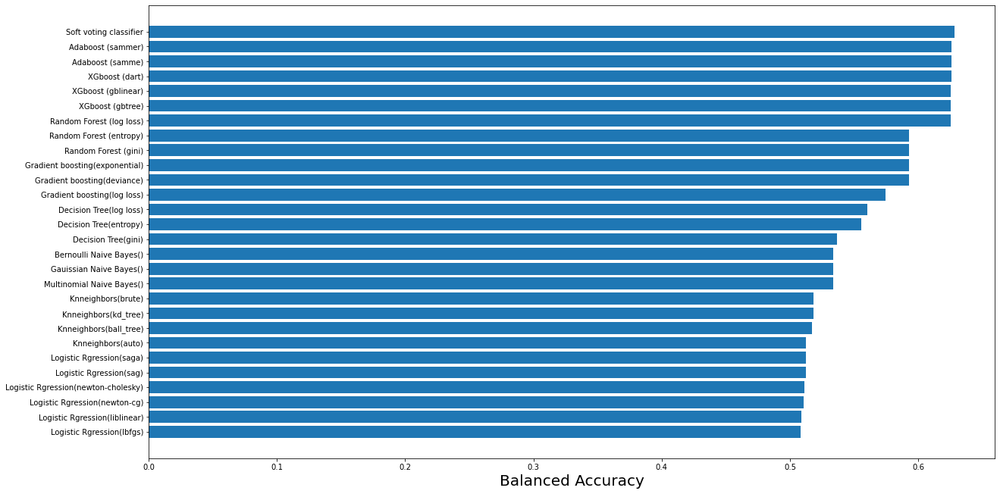

In [276]:
plt.figure(figsize=(20,11))
plt.barh(performance_all["Models"], performance_all["Balanced Accuracy"].sort_values(ascending=True))

plt.xlabel("Balanced Accuracy", fontsize=20)

Text(0.5, 0, 'F1 Score')

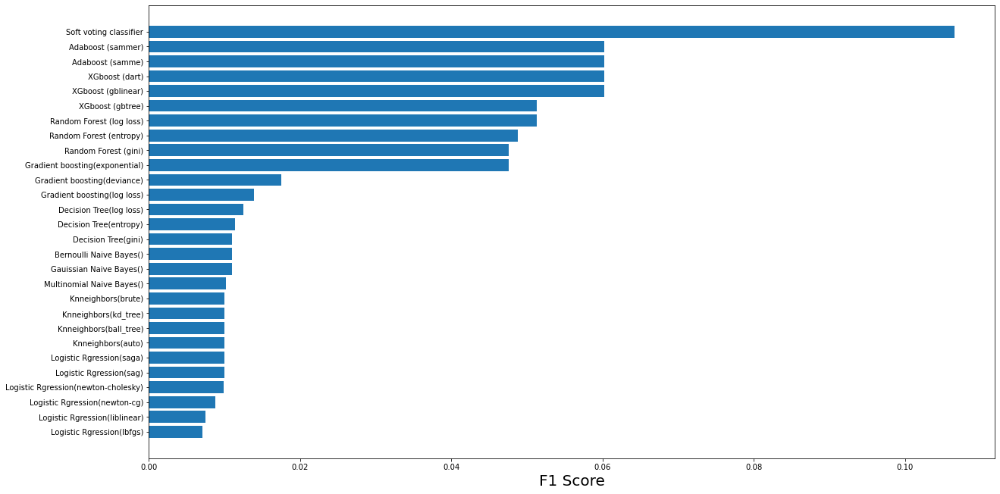

In [277]:
plt.figure(figsize=(20,11))
plt.barh(performance_all["Models"], performance_all["F1 Score"].sort_values(ascending=True))
plt.xlabel("F1 Score", fontsize=20)

Text(0.5, 0, 'Precision')

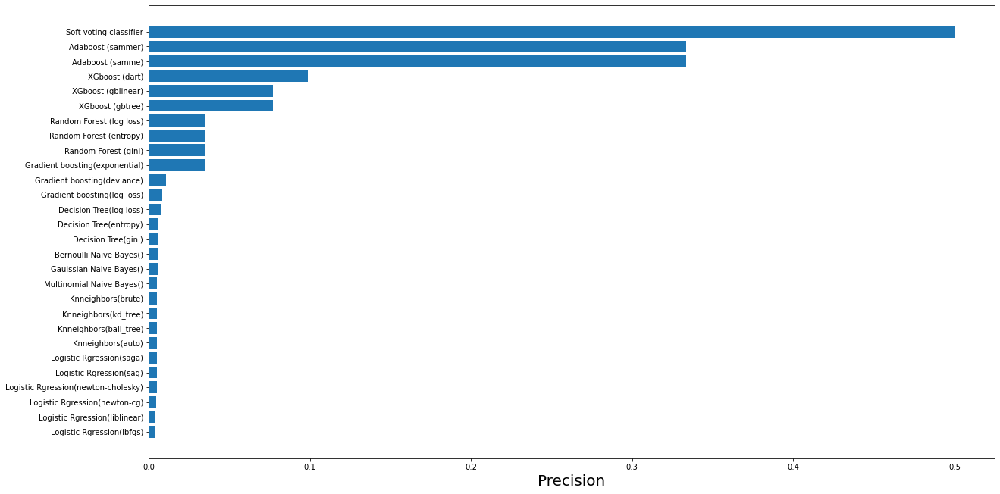

In [278]:
plt.figure(figsize=(20,11))
plt.barh(performance_all["Models"], performance_all["Precision"].sort_values(ascending=True))

plt.xlabel("Precision", fontsize=20)

Text(0.5, 0, 'Recall')

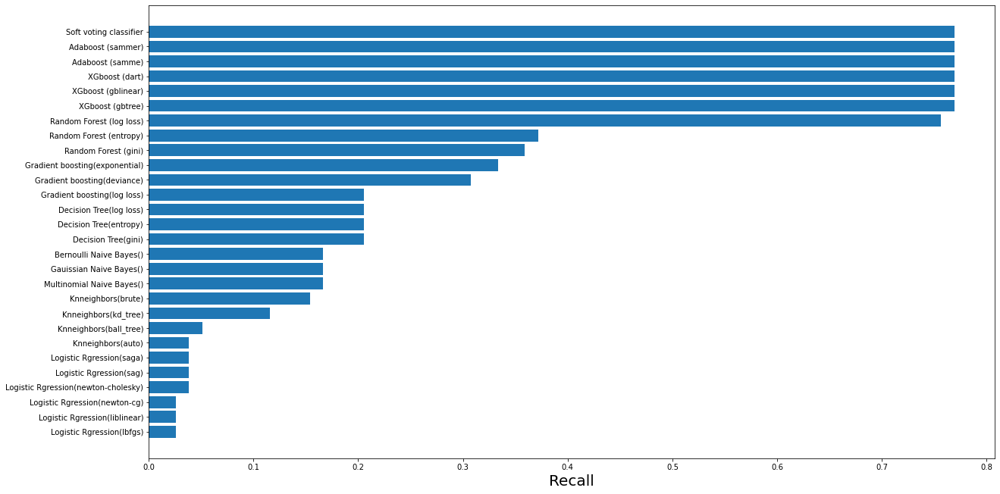

In [279]:
plt.figure(figsize=(20,11))
plt.barh(performance_all["Models"], performance_all["Recall"].sort_values(ascending=True))

plt.xlabel("Recall", fontsize=20)


Text(0.5, 0, 'ROC AUC')

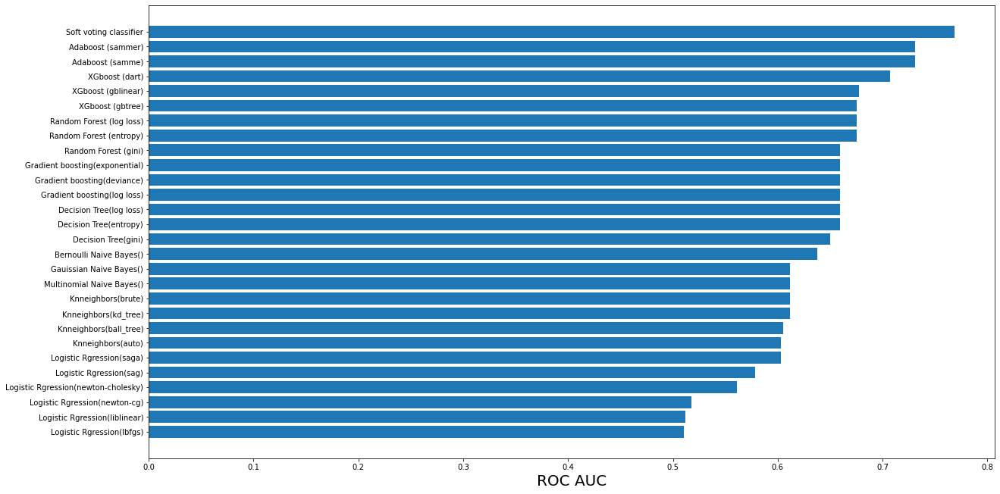

In [280]:
plt.figure(figsize=(20,11))
plt.barh(performance_all["Models"], performance_all["ROC AUC"].sort_values(ascending=True))

plt.xlabel("ROC AUC", fontsize=20)


Text(0.5, 0, 'Matthews Correlation Coefficient')

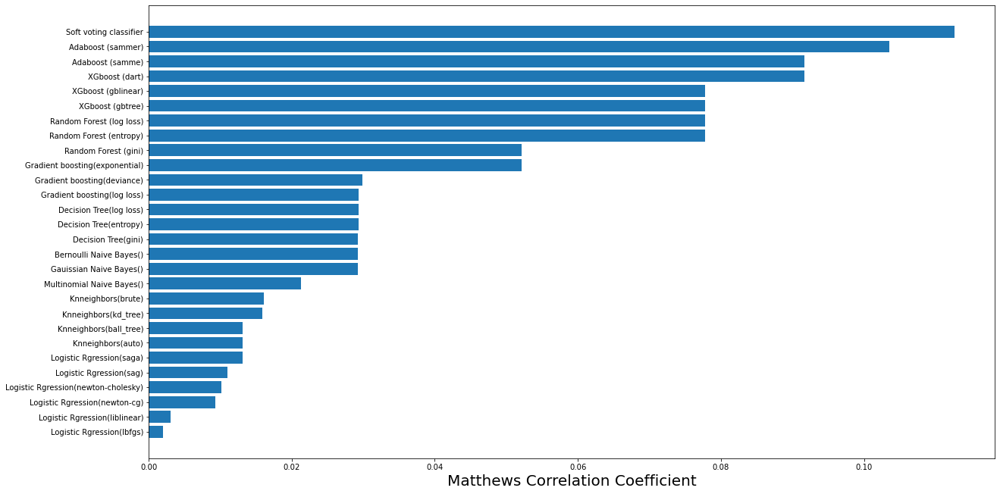

In [281]:
plt.figure(figsize=(20,11))
plt.barh(performance_all["Models"], performance_all["Matthews Correlation Coefficient"].sort_values(ascending=True))

plt.xlabel("Matthews Correlation Coefficient", fontsize=20)

